# Explainability Project for Machine Learning Security
Questo notebook esegue spiegazioni di modelli di classificazione del testo utilizzando SHAP, transformers-interpret e Captum.

### **Installing Requirements**

In [2]:
!git clone https://github.com/Crys266/MLSec-Project.git

Cloning into 'MLSec-Project'...
remote: Enumerating objects: 53, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (52/52), done.
remote: Total 53 (delta 19), reused 0 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (53/53), 160.39 KiB | 1.15 MiB/s, done.
Resolving deltas: 100% (19/19), done.


In [3]:
import sys
sys.path.append('/content/MLSec-Project')

In [4]:
!pip install numpy==2.0.2 seaborn==0.13.2 captum==0.7.0 shap==0.47.0 transformers==4.41.2 transformers-interpret==0.10.0 reportlab flask-compress ipywidgets lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.8/43.8 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.9/45.9 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 31.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 45.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 36.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 37.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 36.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 103.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 83.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━

In [5]:
from transformers import BertTokenizer, BertForSequenceClassification
from sequence_explainer import NewSequenceClassificationExplainer
import shap
import torch
import torch.nn.functional as F
import transformers
from captum.attr import visualization as viz
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import random
import pandas as pd
from lime.lime_text import LimeTextExplainer
import re

Select seed (si può anche non mettere)

In [6]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

### Caricamento del Modello e del Tokenizer
In questa sezione, carichiamo il modello di classificazione del testo e il tokenizer utilizzando la libreria Transformers.

In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = BertForSequenceClassification.from_pretrained("textattack/bert-base-uncased-imdb").to(device)
tokenizer = BertTokenizer.from_pretrained("textattack/bert-base-uncased-imdb")
model.eval()
set_seed(42)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/511 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

### **Text Examples**
In questa sezione, definiamo alcuni testi di esempio da utilizzare per le spiegazioni e li classifichiamo.

In [8]:
# Sample text inputs to cover all 5 classes
sentences = [
    "I really love fantasy movies, they are so exciting!",
    "that movie was awesome.",
    "that movie was good.",
    "that movie was terrible.",
    "The film was a complete waste of time.",
    "The film was a complete waste of time",
    "The film was acomplete waste of time.",
    "What a great movie! ... if you have no taste.",
    "I absolutely loved this movie! I hate that people don't like this movie.",
    "I am not sure how I feel about this film.",
]

print(f"Text inputs: {sentences}")

# **TOKENIZZAZIONE CORRETTA**
inputs = tokenizer(sentences, padding=True, truncation=True, return_tensors="pt")  # Convertiamo i testi in tensori
# **SPOSTIAMO I TENSORI SULLA STESSA DEVICE DEL MODELLO**
inputs = {key: value.to(device) for key, value in inputs.items()}

outputs = model(**inputs)  # Otteniamo le predizioni
# **ESTRAGGIAMO LE PREDIZIONI**
logits = outputs.logits  # Otteniamo i logits (punteggi grezzi)
probabilities = F.softmax(logits, dim=-1)  # Applichiamo softmax per ottenere probabilità
predicted_classes = torch.argmax(probabilities, dim=-1).tolist()  # Troviamo la classe con probabilità più alta

wb_attributions = []
bb_attributions = []

# Definizione delle classi, supponendo un mapping delle classi del modello
class_labels = ["Negative", "Positive"]
# Stampa delle classi predette con probabilità
for i, pred in enumerate(predicted_classes):
    predicted_class = class_labels[pred]  # Converte l'indice nella label della classe
    probability = probabilities[i][pred].item()  # Estrae la probabilità della classe predetta
    print(f"Sample {i}: \"{sentences[i]}\" -> Predicted Class: {predicted_class} (Probability: {probability:.4f})")

Text inputs: ['I really love fantasy movies, they are so exciting!', 'that movie was awesome.', 'that movie was good.', 'that movie was terrible.', 'The film was a complete waste of time.', 'The film was a complete waste of time', 'The film was acomplete waste of time.', 'What a great movie! ... if you have no taste.', "I absolutely loved this movie! I hate that people don't like this movie.", 'I am not sure how I feel about this film.']
Sample 0: "I really love fantasy movies, they are so exciting!" -> Predicted Class: Positive (Probability: 0.9773)
Sample 1: "that movie was awesome." -> Predicted Class: Positive (Probability: 0.9617)
Sample 2: "that movie was good." -> Predicted Class: Positive (Probability: 0.9920)
Sample 3: "that movie was terrible." -> Predicted Class: Negative (Probability: 0.9991)
Sample 4: "The film was a complete waste of time." -> Predicted Class: Negative (Probability: 0.9993)
Sample 5: "The film was a complete waste of time" -> Predicted Class: Negative (Pr

### **Spiegazione Black-box con SHAP**
In questa sezione, utilizziamo SHAP per calcolare le attribuzioni delle spiegazioni black-box.

In [9]:
# Metodo SHAP
print("\nComputing black-box explanation with SHAP...")

# Costruzione pipeline
transf_pipeline = transformers.pipeline(
    "text-classification",
    model=model,
    tokenizer=tokenizer,
    device=0 if torch.cuda.is_available() else -1,
    top_k=None
)

# Wrapping SHAP
transf_pipeline = shap.models.TransformersPipeline(transf_pipeline, rescale_to_logits=True)
explainer = shap.Explainer(transf_pipeline)

# Esecuzione SHAP
shap_values = explainer(sentences)

# Elaborazione SHAP
for i, value in enumerate(shap_values):
    sentence = sentences[i]
    predicted_class_index = predicted_classes[i]
    predicted_class_label = class_labels[predicted_class_index]
    prob = probabilities[i][predicted_class_index].item()

    vals = torch.tensor(value.values, dtype=torch.float64)  # [n_token, n_classi]
    norm = torch.norm(vals[:, predicted_class_index])
    norm = norm if norm != 0 else 1e-8
    normed = vals[:, predicted_class_index] / norm  # [n_token]

    tokens = list(value.data)
    if tokens[0] == "": tokens[0] = "[CLS]"
    if tokens[-1] == "": tokens[-1] = "[SEP]"

    shap_attributions = list(zip(tokens, normed.tolist()))

    # Inverti se classe negativa (indice 0)
    if predicted_class_index == 0:
        shap_attributions = [(tok, -score) for tok, score in shap_attributions]

    # Salva in all_attributions
    bb_attributions.append({
        "sentence": sentence,
        "explain_type": "shap",
        "attributions": shap_attributions,
        "pred_prob": prob,
        "pred_class": predicted_class_label
    })

    # Output di debug (facoltativo)
    print(f"\nWord attributions for: \"{sentence}\"")
    print(f"Attribution type: SHAP for predicted class → {predicted_class_label} (p = {prob:.4f})")
    for token, score in shap_attributions:
        print(f"{token:>10} : {score:+.4f}")



Computing black-box explanation with SHAP...


  0%|          | 0/156 [00:00<?, ?it/s]

PartitionExplainer explainer:  10%|█         | 1/10 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

PartitionExplainer explainer:  30%|███       | 3/10 [00:38<00:23,  3.36s/it]

  0%|          | 0/42 [00:00<?, ?it/s]

PartitionExplainer explainer:  40%|████      | 4/10 [00:44<00:26,  4.41s/it]

  0%|          | 0/42 [00:00<?, ?it/s]

PartitionExplainer explainer:  50%|█████     | 5/10 [00:50<00:26,  5.26s/it]

  0%|          | 0/110 [00:00<?, ?it/s]

PartitionExplainer explainer:  60%|██████    | 6/10 [01:07<00:37,  9.37s/it]

  0%|          | 0/90 [00:00<?, ?it/s]

PartitionExplainer explainer:  70%|███████   | 7/10 [01:14<00:25,  8.36s/it]

  0%|          | 0/132 [00:00<?, ?it/s]

PartitionExplainer explainer:  80%|████████  | 8/10 [01:33<00:23, 11.90s/it]

  0%|          | 0/240 [00:00<?, ?it/s]

PartitionExplainer explainer:  90%|█████████ | 9/10 [02:16<00:21, 21.77s/it]

  0%|          | 0/342 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|██████████| 10/10 [03:11<00:00, 32.04s/it]

  0%|          | 0/156 [00:00<?, ?it/s]

PartitionExplainer explainer: 11it [03:33, 21.37s/it]


Word attributions for: "I really love fantasy movies, they are so exciting!"
Attribution type: SHAP for predicted class → Positive (p = 0.9773)
     [CLS] : +0.0000
         i : -0.0831
    really : +0.2980
      love : +0.6262
   fantasy : -0.0045
    movies : -0.2680
         , : +0.0705
      they : +0.2557
       are : +0.3542
        so : +0.3704
  exciting : +0.3268
         ! : -0.0239
     [SEP] : +0.0000

Word attributions for: "that movie was awesome."
Attribution type: SHAP for predicted class → Positive (p = 0.9617)
     [CLS] : +0.0000
      that : +0.0722
     movie : +0.3810
       was : +0.0185
   awesome : +0.9117
         . : +0.1347
     [SEP] : +0.0000

Word attributions for: "that movie was good."
Attribution type: SHAP for predicted class → Positive (p = 0.9920)
     [CLS] : +0.0000
      that : +0.0295
     movie : +0.4423
       was : +0.0130
      good : +0.8878
         . : +0.1232
     [SEP] : +0.0000

Word attributions for: "that movie was terrible."
Attrib

SHAP Visualization

In [10]:
# Visualization with SHAP
def shap_visualization(texts, shap_values):
    shap.initjs()
    for i, text in enumerate(texts):
        print(f"\nSHAP Visualization for: {text}")
        shap.plots.text(shap_values[i], display=True)

shap_visualization(sentences, shap_values)


SHAP Visualization for: I really love fantasy movies, they are so exciting!



SHAP Visualization for: that movie was awesome.



SHAP Visualization for: that movie was good.



SHAP Visualization for: that movie was terrible.



SHAP Visualization for: The film was a complete waste of time.



SHAP Visualization for: The film was a complete waste of time



SHAP Visualization for: The film was acomplete waste of time.



SHAP Visualization for: What a great movie! ... if you have no taste.



SHAP Visualization for: I absolutely loved this movie! I hate that people don't like this movie.



SHAP Visualization for: I am not sure how I feel about this film.


### **Spiegazione Black-box con LIME**
In questa sezione, utilizziamo LIME per calcolare le attribuzioni delle spiegazioni black-box.

In [ ]:
# Metodo LIME
print("\nComputing black-box explanation with LIME...")

saved_explanations = []

# Prediction function for LIME
def lime_predict(texts):
    inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt")
    inputs = {k: v.to(device) for k, v in inputs.items()}
    with torch.no_grad():
        outputs = model(**inputs)
    probs = F.softmax(outputs.logits, dim=-1).cpu().numpy()
    return probs

# Custom tokenization function using regex that extracts words and punctuation
def custom_tokenizer(text):
    # Questa regex estrae sequenze di caratteri alfanumerici (inclusi gli apostrofi)
    # oppure ogni segno di punteggiatura individualmente
    return re.findall(r"\w+|[^\w\s]", text)

# LIME Explainer: utilizza la funzione custom_tokenizer
lime_explainer = LimeTextExplainer(class_names=class_labels,
                                   split_expression=custom_tokenizer,
                                   bow=False,
                                   char_level=False,
                                   kernel_width=5,  # prova a variare questo valore
                                   feature_selection='forward_selection',  # oppure 'auto' o 'highest_weights'
                                   random_state=42  # per la riproducibilità
                                   )

print("=== LIME Explanation ===")
for i, sentence in enumerate(sentences):
    model_tokens = tokenizer("that movie was terrible.", return_tensors="pt")["input_ids"]
    custom_tokens = custom_tokenizer("that movie was terrible.")
    print(f"Model tokens: {model_tokens}")
    print(f"Custom tokens: {custom_tokens}")

    predicted_class_index = predicted_classes[i]
    predicted_class_label = class_labels[predicted_class_index]
    prob = probabilities[i][predicted_class_index].item()

    explanation = lime_explainer.explain_instance(
        sentence,
        lime_predict,
        num_features=100,
        labels=[predicted_class_index],
        num_samples=5000
    )
    # Save the explanation so we can use it later without re-running explain_instance()
    saved_explanations.append((sentence, explanation))

    # Recupera le attribuzioni usando i token generati dalla funzione custom_tokenizer
    lime_dict = dict(explanation.as_list(label=predicted_class_index))
    tokens = custom_tokenizer(sentence)
    # Aggiungiamo manualmente i token speciali se necessario
    lime_aligned = [("[CLS]", 0.0)] + [(tok, lime_dict.get(tok, 0.0)) for tok in tokens] + [("[SEP]", 0.0)]

    # Se la classe predetta è Negative ed è richiesta un'inversione del segno sulle attribuzioni:
    if predicted_class_index == 0:
        lime_aligned = [(tok, -score) for tok, score in lime_aligned]

    bb_attributions.append({
        "sentence": sentence,
        "explain_type": "lime",
        "attributions": lime_aligned,
        "pred_prob": prob,
        "pred_class": predicted_class_label
    })

    print(f"\nWord attributions for: \"{sentence}\"")
    print(f"Attribution type: LIME for predicted class → {predicted_class_label} (p = {prob:.4f})")
    for token, score in lime_aligned:
        print(f"{token:>10} : {score:+.4f}")


Computing black-box explanation with LIME...
=== LIME Explanation ===
Model tokens: tensor([[ 101, 2008, 3185, 2001, 6659, 1012,  102]])
Custom tokens: ['that', 'movie', 'was', 'terrible', '.']

Word attributions for: "I really love fantasy movies, they are so exciting!"
Attribution type: LIME for predicted class → Positive (p = 0.9773)
     [CLS] : +0.0000
         I : -0.0122
    really : +0.0102
      love : +0.0278
   fantasy : +0.0043
    movies : -0.0107
         , : -0.0009
      they : +0.0078
       are : -0.0006
        so : +0.0070
  exciting : +0.0875
         ! : +0.0266
     [SEP] : +0.0000
Model tokens: tensor([[ 101, 2008, 3185, 2001, 6659, 1012,  102]])
Custom tokens: ['that', 'movie', 'was', 'terrible', '.']

Word attributions for: "that movie was awesome."
Attribution type: LIME for predicted class → Positive (p = 0.9617)
     [CLS] : +0.0000
      that : -0.1581
     movie : -0.1024
       was : -0.1245
   awesome : +0.6754
         . : -0.1283
     [SEP] : +0.0000

Visualizzazione LIME:

In [ ]:
# --- Additional block: Display explanations in the notebook without re-running explain_instance() ---
print("\n=== Display explanations in notebook ===")
for sentence, exp in saved_explanations:
    exp.show_in_notebook(text=sentence)


=== Display explanations in notebook ===


### **Spiegazione White-box con transformers-interpret**
In questa sezione, utilizziamo transformers-interpret per calcolare le attribuzioni delle spiegazioni white-box.

In [ ]:
# Memorizziamo le attribuzioni per ogni frase e tipo di spiegazione
explain_types = ["ig", "lig", "gs"]
for explain_type in explain_types:
    explainer = NewSequenceClassificationExplainer(model, tokenizer, attribution_type=explain_type)
    for i, sentence in enumerate(sentences):
        predicted_class_index = predicted_classes[i]
        predicted_class_label = class_labels[predicted_class_index]
        prob = probabilities[i][predicted_class_index].item()

        attributions = explainer(sentence)
        if predicted_class_index == 0:
            attributions = [(tok, -score) for tok, score in attributions]

        # Salva le attribuzioni in una lista
        wb_attributions.append({
            "sentence": sentence,
            "explain_type": explain_type,
            "attributions": attributions,
            "pred_prob": probabilities[0, predicted_classes[0]].item(),
            "pred_class": class_labels[predicted_class_index],
            "delta": explainer.attributions.delta.item(),
            "sensitivity": explainer.attributions.sensitivity.item()
        })
        # Print the attributions for each token in the sentence.
        print(f"\nWord attributions for: \"{sentence}\"")
        print(f"Attribution type: '{explain_type}' for predicted class → {predicted_class_label} (p = {prob:.4f})")
        print(f"Convergence Delta for: {explainer.attributions.delta.item():.4f}")
        print(f"Sensitivity for: {explainer.attributions.sensitivity.item():.4f}")
        for token, score in attributions:
            print(f"{token:>10} : {score:.4f}")
        print(f"-------------------------------------")



Word attributions for: "I really love fantasy movies, they are so exciting!"
Attribution type: 'ig' for predicted class → Positive (p = 0.9773)
Convergence Delta for: 0.0054
Sensitivity for: 0.0205
     [CLS] : 0.0000
         i : 0.3615
    really : 0.1489
      love : 0.7307
   fantasy : 0.2571
    movies : -0.0379
         , : -0.0271
      they : -0.0610
       are : 0.0329
        so : 0.4845
  exciting : -0.0713
         ! : 0.0161
     [SEP] : 0.0000
-------------------------------------

Word attributions for: "that movie was awesome."
Attribution type: 'ig' for predicted class → Positive (p = 0.9617)
Convergence Delta for: -0.0649
Sensitivity for: 0.0079
     [CLS] : 0.0000
      that : 0.2904
     movie : -0.4620
       was : 0.0471
   awesome : 0.8351
         . : 0.0514
     [SEP] : 0.0000
-------------------------------------

Word attributions for: "that movie was good."
Attribution type: 'ig' for predicted class → Positive (p = 0.9920)
Convergence Delta for: 0.1135
Sens

## **Visualizzazione dei Risultati**
In questa sezione, visualizziamo i risultati delle spiegazioni calcolate utilizzando SHAP, transformers-interpret e Captum.

## Funzioni di Plotting
In questa sezione, definiamo le funzioni per plottare le attribuzioni calcolate.

Black-Box:

In [ ]:
for entry in bb_attributions:
    print(f"\nAttributions for method: \"{entry['explain_type']}\"")
    print(entry['attributions'])
    tokens = [token for token, _ in entry["attributions"]]
    scores = [score for _, score in entry["attributions"]]
    vis_data_records= [viz.VisualizationDataRecord(
            word_attributions=scores,
            pred_prob=entry["pred_prob"],
            pred_class=entry["pred_class"],
            true_class=entry["pred_class"],  # Supponendo che la classe predetta sia corretta
            attr_class=entry["pred_class"],
            attr_score=sum(scores),
            raw_input_ids=tokens,
            convergence_score=0.0,  # Non calcolato in questo contesto
        )]
    # Visualizza le attribuzioni
    viz.visualize_text(vis_data_records)


Attributions for method: "shap"
[('[CLS]', 0.0), (' i', -0.08313630837660248), (' really', 0.2979659082972638), (' love', 0.6261831449755052), (' fantasy', -0.00446549548226048), (' movies', -0.267971549392249), (' ,', 0.07052297592753114), (' they', 0.2556716190823656), (' are', 0.3541518302663915), (' so', 0.3704218178429945), (' exciting', 0.3268331316115771), (' !', -0.02394668797663487), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.92,"[CLS] i really love fantasy movies , they are so exciting ! [SEP]"



Attributions for method: "shap"
[('[CLS]', 0.0), (' that', 0.07222478489662754), (' movie', 0.381001347202628), (' was', 0.018512994012305814), (' awesome', 0.9116702862012099), (' .', 0.13467038348101099), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.96),Positive,1.52,[CLS] that movie was awesome . [SEP]



Attributions for method: "shap"
[('[CLS]', 0.0), (' that', 0.029513700057788715), (' movie', 0.4422956600123627), (' was', 0.013017469331534115), (' good', 0.887777057530716), (' .', 0.1232312146228939), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.99),Positive,1.50,[CLS] that movie was good . [SEP]



Attributions for method: "shap"
[('[CLS]', -0.0), (' that', -0.14621486512224321), (' movie', -0.5006441932449583), (' was', -0.11263978445871102), (' terrible', -0.8171353225131529), (' .', -0.21812553414446847), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-1.79,[CLS] that movie was terrible . [SEP]



Attributions for method: "shap"
[('[CLS]', -0.0), (' the', -0.06264264217856509), (' film', -0.29108245022019064), (' was', -0.20261165749110663), (' a', -0.023209187292755024), (' complete', -0.2505004240530527), (' waste', -0.8831906450619866), (' of', -0.10856836881856148), (' time', -0.09667094819971214), (' .', -0.07647362629752054), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-1.99,[CLS] the film was a complete waste of time . [SEP]



Attributions for method: "shap"
[('[CLS]', -0.0), (' the', -0.06976057250248024), (' film', -0.4004912594385522), (' was', -0.13392614410812262), (' a', 0.05077103970292997), (' complete', -0.13817215521513895), (' waste', -0.8786216850372851), (' of', -0.10975436321517293), (' time', -0.10541666353067528), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-1.79,[CLS] the film was a complete waste of time [SEP]



Attributions for method: "shap"
[('[CLS]', -0.0), (' the', -0.03411777698121288), (' film', -0.05424275142040284), (' was', -0.11941044648143541), (' ac', 0.012254412082449635), ('omp', -0.09938672340644052), ('lete', -0.0022852027735410065), (' waste', -0.9673217601915963), (' of', -0.16778258848820216), (' time', -0.02315264579852189), (' .', -0.08487227568055608), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-1.54,[CLS] the film was ac omp lete waste of time . [SEP]



Attributions for method: "shap"
[('[CLS]', 0.0), (' what', -0.17934873591313863), (' a', 0.07584354361555226), (' great', 0.7294597527312586), (' movie', 0.1819654010295413), (' !', -0.03309752972385603), (' .', 0.0246071419556176), (' .', 0.11030546461548318), (' .', -0.12650721365761258), (' if', 0.08871498167803663), (' you', 0.25017944225084277), (' have', 0.06824707261952935), (' no', -0.5326839071231526), (' taste', -0.08908267390761655), (' .', -0.013449510488398701), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.75),Positive,0.56,[CLS] what a great movie ! . . . if you have no taste . [SEP]



Attributions for method: "shap"
[('[CLS]', 0.0), (' i', 0.051235066487611385), (' absolutely', 0.4764041496175425), (' loved', 0.8015361752659222), (' this', 0.06483238718171391), (' movie', -0.05533230083271528), (' !', -0.1119837702410004), (' i', -0.031184375855243553), (' hate', 0.009636071310867696), (' that', -0.016125001260100295), (' people', 0.30100653896891416), (' don', -0.06070859503465935), (" '", -0.035517232798847), (' t', -0.09854539689075432), (' like', -0.01947681017759762), (' this', 0.024609407332798733), (' movie', -0.02391636735411167), (' .', -0.0017639662076012628), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.99),Positive,1.27,[CLS] i absolutely loved this movie ! i hate that people don ' t like this movie . [SEP]



Attributions for method: "shap"
[('[CLS]', -0.0), (' i', -0.22493188741854245), (' am', -0.2673278000834633), (' not', -0.3659978823325559), (' sure', -0.6505936449456274), (' how', -0.07111548493875125), (' i', 0.24316817727716653), (' feel', 0.23919798843977627), (' about', -0.06971694500194697), (' this', -0.059225386647750365), (' film', -0.3725338498206361), (' .', -0.22838899314796793), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.96),Negative,-1.83,[CLS] i am not sure how i feel about this film . [SEP]



Attributions for method: "lime"
[('[CLS]', 0.0), ('I', -0.016685999268848704), ('really', 0.008422016044375098), ('love', 0.021289331483711642), ('fantasy', 0.00250278817938487), ('movies', -0.011711633776694402), (',', -0.006133713902304156), ('they', 0.003420911206156701), ('are', -0.006403948604719276), ('so', 0.00562589103511146), ('exciting', 0.07645526095421029), ('!', 0.022258384992952136), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,0.10,"[CLS] I really love fantasy movies , they are so exciting ! [SEP]"



Attributions for method: "lime"
[('[CLS]', 0.0), ('that', -0.14853534811240843), ('movie', -0.09687182714341049), ('was', -0.11593729953166725), ('awesome', 0.6414476152587361), ('.', -0.12124764454521203), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.96),Positive,0.16,[CLS] that movie was awesome . [SEP]



Attributions for method: "lime"
[('[CLS]', 0.0), ('that', -0.13698386757099257), ('movie', -0.10883882815162746), ('was', -0.1346215973549341), ('good', 0.6663098155870022), ('.', -0.13094112434826827), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.99),Positive,0.15,[CLS] that movie was good . [SEP]



Attributions for method: "lime"
[('[CLS]', -0.0), ('that', 0.01830595363204135), ('movie', 0.002383560583731318), ('was', 0.0116919009354614), ('terrible', -0.07046889194791801), ('.', 0.017133771742937266), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-0.02,[CLS] that movie was terrible . [SEP]



Attributions for method: "lime"
[('[CLS]', -0.0), ('The', -0.05851482982497831), ('film', -0.07564295158207165), ('was', -0.06817751670716941), ('a', -0.047921820295001714), ('complete', -0.053955275593071866), ('waste', -0.3368211306180129), ('of', -0.05146807021116716), ('time', -0.040089745825152366), ('.', -0.046525395694951774), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-0.78,[CLS] The film was a complete waste of time . [SEP]



Attributions for method: "lime"
[('[CLS]', -0.0), ('The', -0.02728362575433398), ('film', -0.06427756981437129), ('was', -0.04084664092795415), ('a', -0.03218670725721017), ('complete', -0.032778461052316174), ('waste', -0.16585747459083258), ('of', -0.031317407124609876), ('time', -0.030369776569428384), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-0.42,[CLS] The film was a complete waste of time [SEP]



Attributions for method: "lime"
[('[CLS]', -0.0), ('The', 0.07952247605346116), ('film', 0.07683862435915541), ('was', 0.07886076772430743), ('acomplete', 0.08426630534510753), ('waste', -0.8369428646778359), ('of', 0.08748513483618353), ('time', 0.09179702864961058), ('.', 0.07884034105530346), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (1.00),Negative,-0.26,[CLS] The film was acomplete waste of time . [SEP]



Attributions for method: "lime"
[('[CLS]', 0.0), ('What', -0.13128579630489318), ('a', 0.06495697565527073), ('great', 0.6942417371929344), ('movie', 0.1355541901921009), ('!', 0.25158218925922604), ('.', -0.0943720856826949), ('.', -0.0943720856826949), ('.', -0.0943720856826949), ('if', 0.04133166930252609), ('you', -0.05125318082306108), ('have', -0.1616110030909425), ('no', -0.11441132531982172), ('taste', -0.12484795445139646), ('.', -0.0943720856826949), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.75),Positive,0.23,[CLS] What a great movie ! . . . if you have no taste . [SEP]



Attributions for method: "lime"
[('[CLS]', 0.0), ('I', -0.0006117184335883109), ('absolutely', 0.01444131307645245), ('loved', 0.7562195289651329), ('this', 0.012381293900082212), ('movie', 0.0009438579840200304), ('!', 0.006174453194671842), ('I', -0.0006117184335883109), ('hate', 0.004223741385032375), ('that', 0.013453512729760931), ('people', 0.04479921544705457), ('don', 0.006029045052258937), ("'", 0.015455334192330129), ('t', 0.010721356524815357), ('like', 0.004236020264675307), ('this', 0.012381293900082212), ('movie', 0.0009438579840200304), ('.', 0.007182660034360658), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.99),Positive,0.91,[CLS] I absolutely loved this movie ! I hate that people don ' t like this movie . [SEP]



Attributions for method: "lime"
[('[CLS]', -0.0), ('I', 0.032267701244098175), ('am', 0.07995180117284861), ('not', -0.3141953313190995), ('sure', -0.5010176621584145), ('how', 0.0768059933859417), ('I', 0.032267701244098175), ('feel', 0.07225612962723846), ('about', 0.002841750616982565), ('this', 0.1662810278833447), ('film', 0.15153932692515065), ('.', 0.1317176524017731), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.96),Negative,-0.07,[CLS] I am not sure how I feel about this film . [SEP]


White-Box:

In [ ]:
for entry in wb_attributions:
    print(f"\nAttributions for method: \"{entry['explain_type']}\"")
    print(entry['attributions'])
    tokens = [token for token, _ in entry["attributions"]]
    scores = [score for _, score in entry["attributions"]]
    vis_data_records= [viz.VisualizationDataRecord(
            word_attributions=scores,
            pred_prob=entry["pred_prob"],
            pred_class=entry["pred_class"],
            true_class=entry["pred_class"],  # Supponendo che la classe predetta sia corretta
            attr_class=entry["pred_class"],
            attr_score=sum(scores),
            raw_input_ids=tokens,
            convergence_score=0.0,  # Non calcolato in questo contesto
        )]
    # Visualizza le attribuzioni
    viz.visualize_text(vis_data_records)


Attributions for method: "ig"
[('[CLS]', 0.0), ('i', 0.3615325613782822), ('really', 0.14885143897452785), ('love', 0.7307296446191602), ('fantasy', 0.2570686706264128), ('movies', -0.037932524190574024), (',', -0.027147851254880933), ('they', -0.06098146195224912), ('are', 0.0328735845178263), ('so', 0.48452466051806753), ('exciting', -0.07132534033119234), ('!', 0.016143014959318813), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.83,"[CLS] i really love fantasy movies , they are so exciting ! [SEP]"



Attributions for method: "ig"
[('[CLS]', 0.0), ('that', 0.29042767859455143), ('movie', -0.46202333680652535), ('was', 0.047068105887071124), ('awesome', 0.8350652436799325), ('.', 0.05135009209653147), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,0.76,[CLS] that movie was awesome . [SEP]



Attributions for method: "ig"
[('[CLS]', 0.0), ('that', -0.2877823912036088), ('movie', 0.8795470323500725), ('was', 0.1479683382541725), ('good', 0.3486848152902448), ('.', 0.01012835907836326), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.10,[CLS] that movie was good . [SEP]



Attributions for method: "ig"
[('[CLS]', -0.0), ('that', 0.40985114463861705), ('movie', -0.8577648968531858), ('was', 0.14180087645867093), ('terrible', -0.2477365409344958), ('.', -0.12157523878743824), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-0.68,[CLS] that movie was terrible . [SEP]



Attributions for method: "ig"
[('[CLS]', -0.0), ('the', 0.24112015322027966), ('film', -0.7225209276537107), ('was', 0.08502871741230773), ('a', 0.006903898389013292), ('complete', -0.00021038704338777694), ('waste', -0.46631025370519646), ('of', -0.22268322567311102), ('time', -0.12062618475927361), ('.', -0.36188843832959033), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.56,[CLS] the film was a complete waste of time . [SEP]



Attributions for method: "ig"
[('[CLS]', -0.0), ('the', 0.22990328208391464), ('film', -0.8137168920495521), ('was', 0.047111835143487636), ('a', -0.0805234414521796), ('complete', -0.030826672319119758), ('waste', -0.4338655507148043), ('of', -0.2944619762281386), ('time', -0.0202063252191027), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.40,[CLS] the film was a complete waste of time [SEP]



Attributions for method: "ig"
[('[CLS]', -0.0), ('the', 0.19980307374121117), ('film', -0.3449593114857731), ('was', -0.18697507389102044), ('ac', 0.07074863246628921), ('##omp', -0.032657959968701085), ('##lete', -0.08819890555277574), ('waste', -0.5180951879371528), ('of', -0.5304711571365563), ('time', -0.1506897372700242), ('.', -0.4687659323846588), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-2.05,[CLS] the film was ac ##omp ##lete waste of time . [SEP]



Attributions for method: "ig"
[('[CLS]', 0.0), ('what', 0.08670537221423281), ('a', 0.3803266340171208), ('great', 0.3717539585037455), ('movie', 0.0609643028987032), ('!', 0.5597420606798252), ('.', -0.14456701867913402), ('.', 0.01609543768488251), ('.', 0.020245632419619065), ('if', 0.08989072859144963), ('you', 0.1391225640588688), ('have', -0.013323041363805044), ('no', 0.1941306707632719), ('taste', -0.5477992528132759), ('.', -0.0751848309373767), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.14,[CLS] what a great movie ! . . . if you have no taste . [SEP]



Attributions for method: "ig"
[('[CLS]', 0.0), ('i', 0.2269196050071926), ('absolutely', -0.026514488294128707), ('loved', 0.6779618777458329), ('this', 0.07798404554392913), ('movie', 0.1542595045270217), ('!', 0.032984384142966804), ('i', 0.4339846724361601), ('hate', -0.4590643995003602), ('that', 0.06619201302390758), ('people', 0.13808347155063358), ('don', -0.008053526425337278), ("'", 0.022277376140842655), ('t', 0.08396377233404372), ('like', -0.13863895365575055), ('this', -0.004661942879203172), ('movie', 0.0809527229951234), ('.', -0.0356167449266731), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.32,[CLS] i absolutely loved this movie ! i hate that people don ' t like this movie . [SEP]



Attributions for method: "ig"
[('[CLS]', -0.0), ('i', 0.4358927605477723), ('am', 0.08549822672038788), ('not', -0.11053053591024722), ('sure', 0.05402576051060771), ('how', -0.22892700718888448), ('i', 0.15575246145279456), ('feel', -0.053027827511439196), ('about', -0.007837063821221166), ('this', 0.22653657885911369), ('film', 0.23784253162818345), ('.', -0.7746767758367845), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,0.02,[CLS] i am not sure how i feel about this film . [SEP]



Attributions for method: "lig"
[('[CLS]', 0.0), ('i', 0.28202891899809024), ('really', 0.1020920938078037), ('love', 0.6890212333711806), ('fantasy', 0.18389628273777492), ('movies', -0.0939213081186209), (',', -0.061152660316608855), ('they', 0.12999246927226138), ('are', 0.03185055877215893), ('so', 0.5898060805644787), ('exciting', 0.15081322813909173), ('!', 0.01948301293220393), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,2.02,"[CLS] i really love fantasy movies , they are so exciting ! [SEP]"



Attributions for method: "lig"
[('[CLS]', 0.0), ('that', 0.14658038183998276), ('movie', -0.13765967589462402), ('was', 0.010327575432072177), ('awesome', 0.9702113551884438), ('.', 0.1347118136665454), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.12,[CLS] that movie was awesome . [SEP]



Attributions for method: "lig"
[('[CLS]', 0.0), ('that', -0.3226778929730016), ('movie', 0.6366350452784857), ('was', 0.24637630838231045), ('good', 0.6504789917552136), ('.', 0.08216198916037767), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.29,[CLS] that movie was good . [SEP]



Attributions for method: "lig"
[('[CLS]', -0.0), ('that', 0.4193346571418259), ('movie', -0.8071423830559987), ('was', -0.2506274316145597), ('terrible', -0.30911717754001206), ('.', -0.11963310522767782), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.07,[CLS] that movie was terrible . [SEP]



Attributions for method: "lig"
[('[CLS]', -0.0), ('the', 0.3579172854426132), ('film', -0.18121073648049787), ('was', -0.17669895951860823), ('a', -0.15688431194843278), ('complete', -0.01445962642012165), ('waste', -0.6694398262583102), ('of', -0.4575939857864295), ('time', -0.1641110698710268), ('.', -0.3139095654420304), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.78,[CLS] the film was a complete waste of time . [SEP]



Attributions for method: "lig"
[('[CLS]', -0.0), ('the', 0.2919207302205139), ('film', -0.18055440365368103), ('was', -0.20800476855991554), ('a', -0.25772928454015714), ('complete', -0.035669282139713446), ('waste', -0.7662439168278888), ('of', -0.42058138169277404), ('time', 0.08486041683158502), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.49,[CLS] the film was a complete waste of time [SEP]



Attributions for method: "lig"
[('[CLS]', -0.0), ('the', 0.34989104525961134), ('film', -0.1917057758473982), ('was', -0.2528274298991447), ('ac', 0.03597639433511661), ('##omp', -0.029726791968507065), ('##lete', 0.019759014775628598), ('waste', -0.6254535837661134), ('of', -0.41474055330359544), ('time', -0.15263680116517603), ('.', -0.43339951061243037), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.69,[CLS] the film was ac ##omp ##lete waste of time . [SEP]



Attributions for method: "lig"
[('[CLS]', 0.0), ('what', 0.0859369779679798), ('a', 0.30355474780907094), ('great', 0.26569430961604384), ('movie', 0.09603572882853068), ('!', 0.8233478055754065), ('.', -0.13535432855559398), ('.', 0.008505369353863906), ('.', 0.05649574755520451), ('if', 0.03723044132049255), ('you', 0.06396977163913585), ('have', -0.04032926468679241), ('no', 0.1526418662659097), ('taste', -0.3009487811723314), ('.', 0.013860528892435959), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.43,[CLS] what a great movie ! . . . if you have no taste . [SEP]



Attributions for method: "lig"
[('[CLS]', 0.0), ('i', 0.14680280097587184), ('absolutely', 0.021405079436581407), ('loved', 0.7198845045968012), ('this', 0.10849783354019929), ('movie', 0.17262243435187424), ('!', 0.07774500959916592), ('i', 0.3825306289691521), ('hate', -0.4205286525114716), ('that', 0.08062519301427619), ('people', 0.21558441614188686), ('don', 0.008795486632593707), ("'", 0.053853348309477855), ('t', 0.07657561038950725), ('like', -0.114097208993813), ('this', 0.03456511567462762), ('movie', 0.11198699011172226), ('.', 0.019900326454673392), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.70,[CLS] i absolutely loved this movie ! i hate that people don ' t like this movie . [SEP]



Attributions for method: "lig"
[('[CLS]', -0.0), ('i', 0.2005518649630625), ('am', -0.023140734508386093), ('not', -0.14273499421495225), ('sure', -0.008400781414645533), ('how', -0.24063936963829963), ('i', 0.10746779440791862), ('feel', -0.03858636563471118), ('about', -0.04339089184642795), ('this', 0.33908521425565974), ('film', 0.5709921735050082), ('.', -0.6518899057897781), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,0.07,[CLS] i am not sure how i feel about this film . [SEP]



Attributions for method: "gs"
[('[CLS]', 0.0), ('i', 0.3593665361404419), ('really', 0.16113455593585968), ('love', 0.7470104694366455), ('fantasy', 0.32310575246810913), ('movies', -0.0871579721570015), (',', -0.03198065608739853), ('they', -0.08608272671699524), ('are', 0.014377190731465816), ('so', 0.39763176441192627), ('exciting', 0.08388175070285797), ('!', 0.03295644745230675), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.91,"[CLS] i really love fantasy movies , they are so exciting ! [SEP]"



Attributions for method: "gs"
[('[CLS]', 0.0), ('that', 0.2624601423740387), ('movie', -0.25829485058784485), ('was', 0.10635988414287567), ('awesome', 0.9138233065605164), ('.', 0.13421277701854706), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.16,[CLS] that movie was awesome . [SEP]



Attributions for method: "gs"
[('[CLS]', 0.0), ('that', -0.1161140576004982), ('movie', 0.5339226126670837), ('was', 0.2637477219104767), ('good', 0.7890363931655884), ('.', -0.09645171463489532), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.37,[CLS] that movie was good . [SEP]



Attributions for method: "gs"
[('[CLS]', -0.0), ('that', 0.3458288609981537), ('movie', -0.6469031572341919), ('was', -0.035375092178583145), ('terrible', -0.5823463201522827), ('.', -0.348626047372818), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.27,[CLS] that movie was terrible . [SEP]



Attributions for method: "gs"
[('[CLS]', -0.0), ('the', 0.22782786190509796), ('film', -0.7721500992774963), ('was', 0.16419482231140137), ('a', 0.029940452426671982), ('complete', 0.07394598424434662), ('waste', -0.30860835313796997), ('of', -0.13106100261211395), ('time', -0.16481450200080872), ('.', -0.4230535328388214), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.30,[CLS] the film was a complete waste of time . [SEP]



Attributions for method: "gs"
[('[CLS]', -0.0), ('the', 0.26015332341194153), ('film', -0.7133811116218567), ('was', -0.10210277885198593), ('a', -0.2209417223930359), ('complete', 0.04307373985648155), ('waste', -0.48550406098365784), ('of', -0.3297593593597412), ('time', -0.13362860679626465), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-1.68,[CLS] the film was a complete waste of time [SEP]



Attributions for method: "gs"
[('[CLS]', -0.0), ('the', 0.12140658497810364), ('film', -0.39731141924858093), ('was', -0.10030286014080048), ('ac', 0.05955959111452103), ('##omp', -0.0326392725110054), ('##lete', -0.06767666339874268), ('waste', -0.5269036889076233), ('of', -0.5118851065635681), ('time', -0.12071169912815094), ('.', -0.5039101839065552), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,-2.08,[CLS] the film was ac ##omp ##lete waste of time . [SEP]



Attributions for method: "gs"
[('[CLS]', 0.0), ('what', 0.03359352797269821), ('a', 0.3933646082878113), ('great', 0.3980478048324585), ('movie', 0.10492336750030518), ('!', 0.5466353297233582), ('.', -0.10313523560762405), ('.', 0.04851813614368439), ('.', 0.029815886169672012), ('if', 0.07326629757881165), ('you', 0.11888211220502853), ('have', -0.007171537261456251), ('no', 0.20648960769176483), ('taste', -0.5416275858879089), ('.', -0.08027438819408417), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.22,[CLS] what a great movie ! . . . if you have no taste . [SEP]



Attributions for method: "gs"
[('[CLS]', 0.0), ('i', 0.22447088360786438), ('absolutely', -0.03908280283212662), ('loved', 0.6705204248428345), ('this', 0.06089579686522484), ('movie', 0.16263829171657562), ('!', 0.02466491609811783), ('i', 0.44432613253593445), ('hate', -0.46181270480155945), ('that', 0.0729004442691803), ('people', 0.1214107945561409), ('don', -0.008342749439179897), ("'", 0.03638039901852608), ('t', 0.08985975384712219), ('like', -0.13176168501377106), ('this', -0.03919700160622597), ('movie', 0.08448293805122375), ('.', -0.03827909752726555), ('[SEP]', 0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Positive,Positive (0.98),Positive,1.27,[CLS] i absolutely loved this movie ! i hate that people don ' t like this movie . [SEP]



Attributions for method: "gs"
[('[CLS]', -0.0), ('i', 0.4109732508659363), ('am', 0.11752575635910034), ('not', 0.08602787554264069), ('sure', 0.09241721779108047), ('how', -0.13142728805541992), ('i', 0.18627937138080597), ('feel', -0.10720793157815933), ('about', 0.04677750542759895), ('this', 0.42523613572120667), ('film', 0.4321815073490143), ('.', -0.6067004799842834), ('[SEP]', -0.0)]


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
Negative,Negative (0.98),Negative,0.95,[CLS] i am not sure how i feel about this film . [SEP]


### **Visualizzazione Plot**
In questa sezione plottiamo i risultati dei metodi di explanation

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


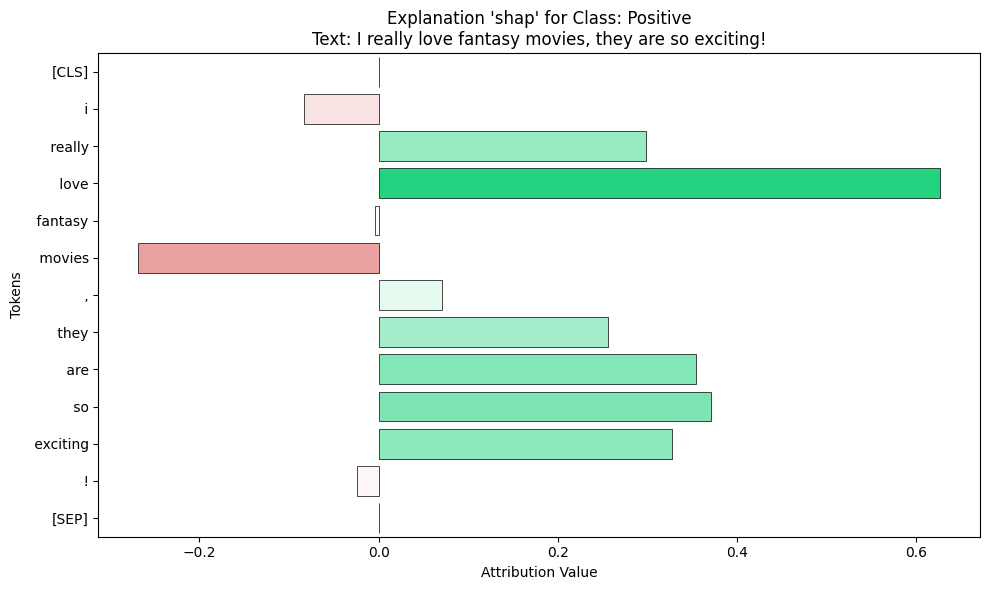

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


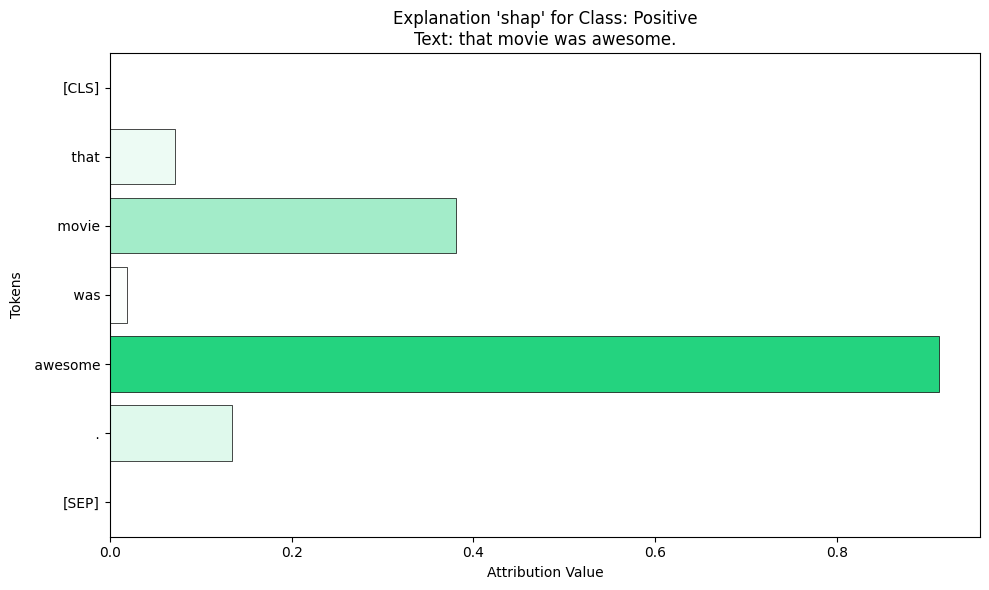

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


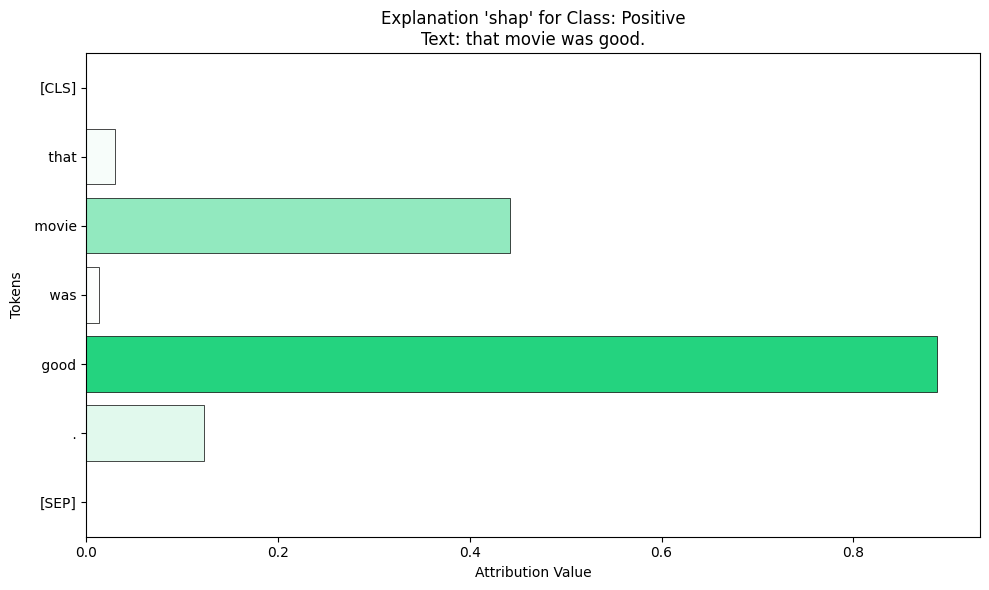

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


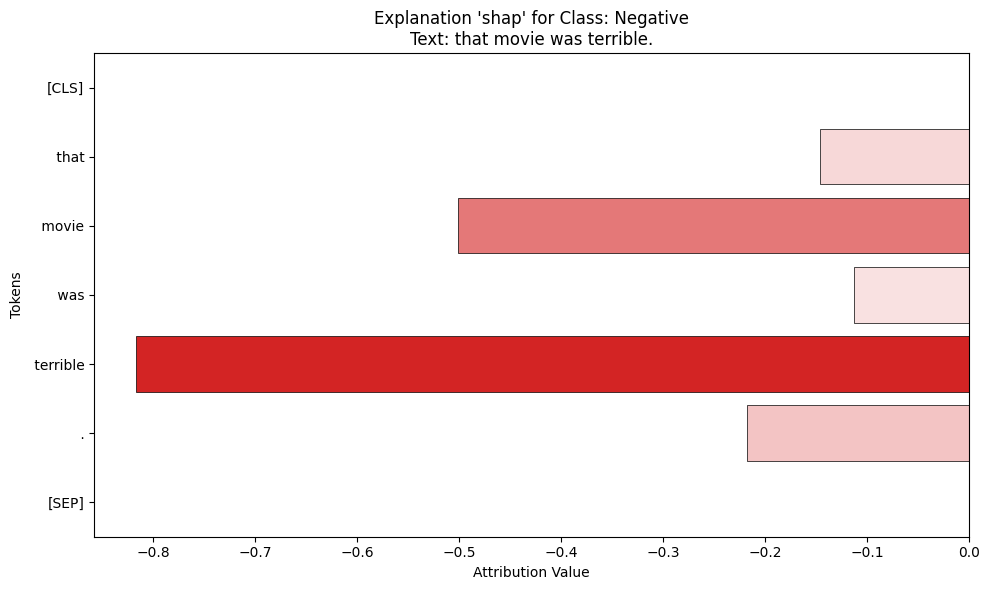

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


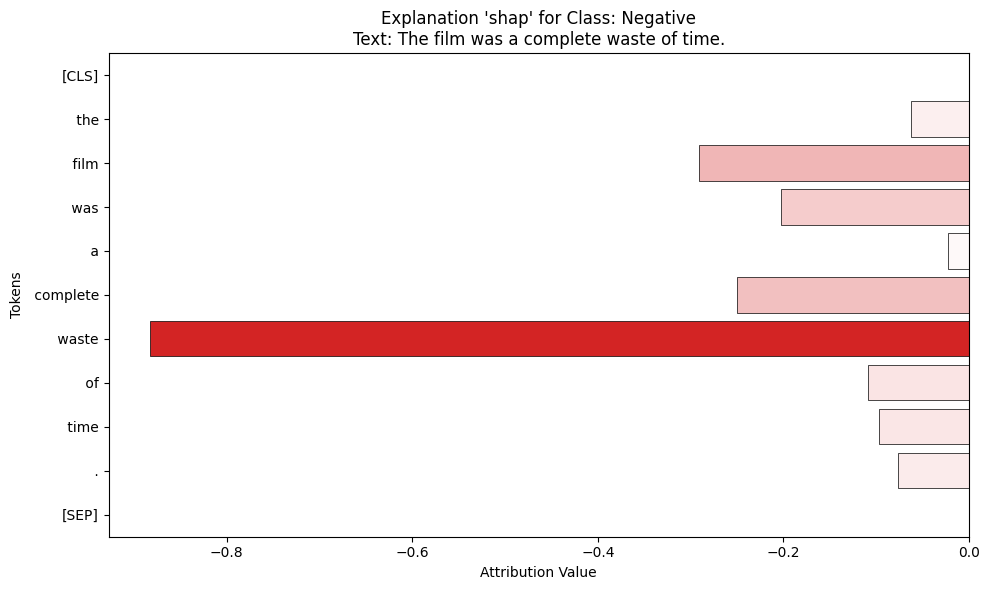

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


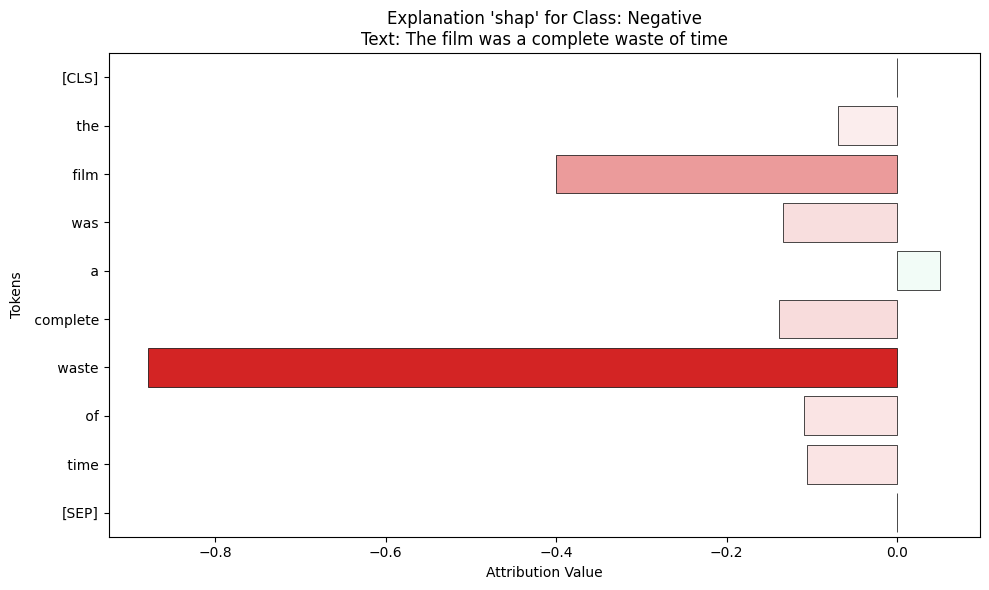

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


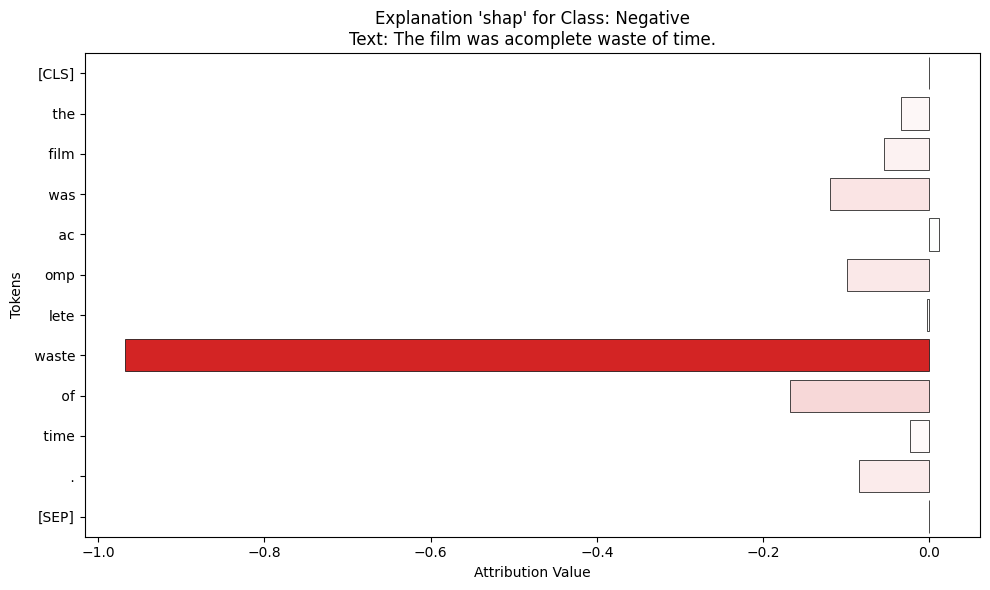

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (16) than needed (13), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


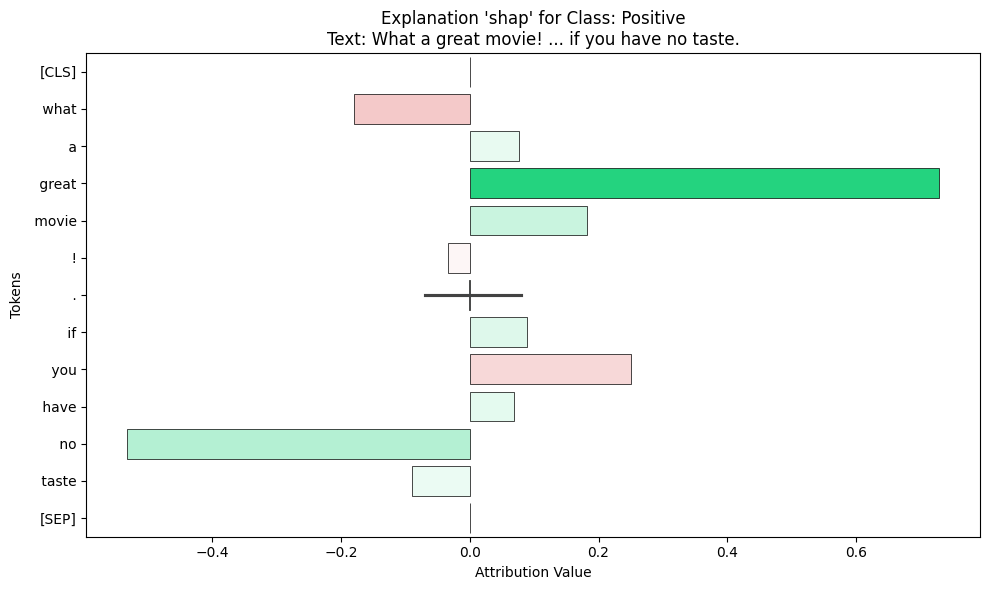

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (19) than needed (16), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


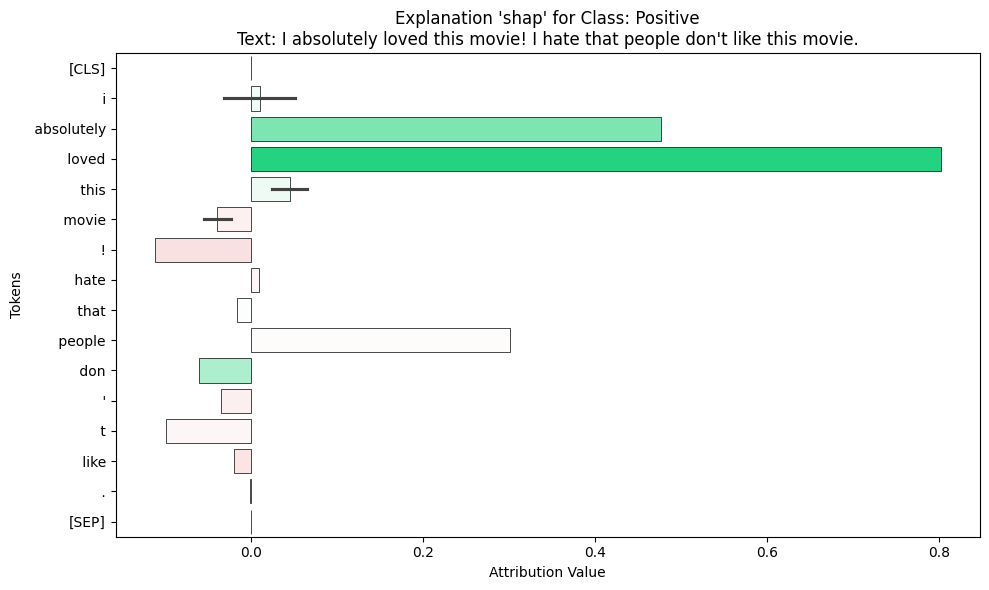

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


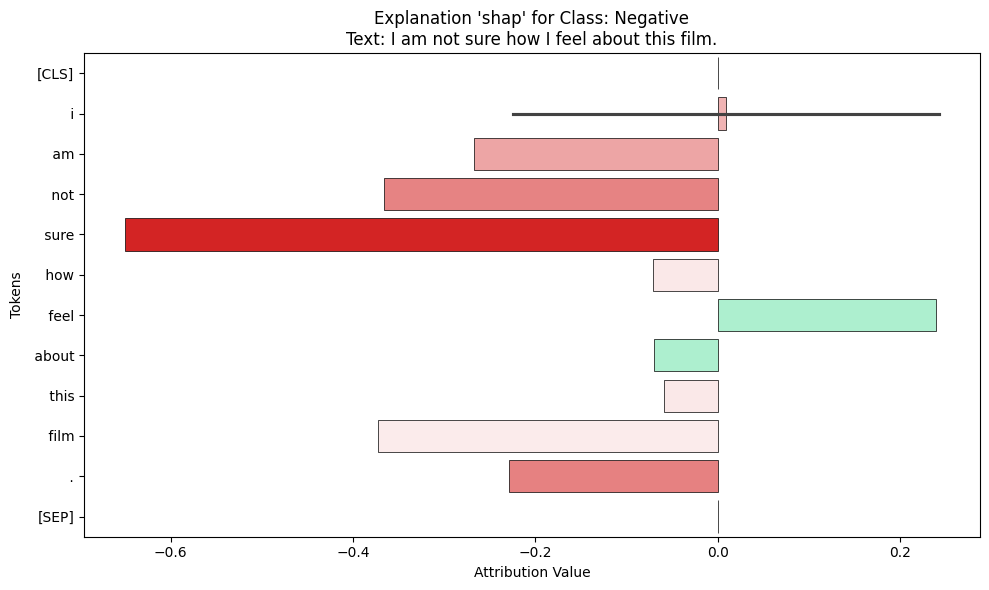

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


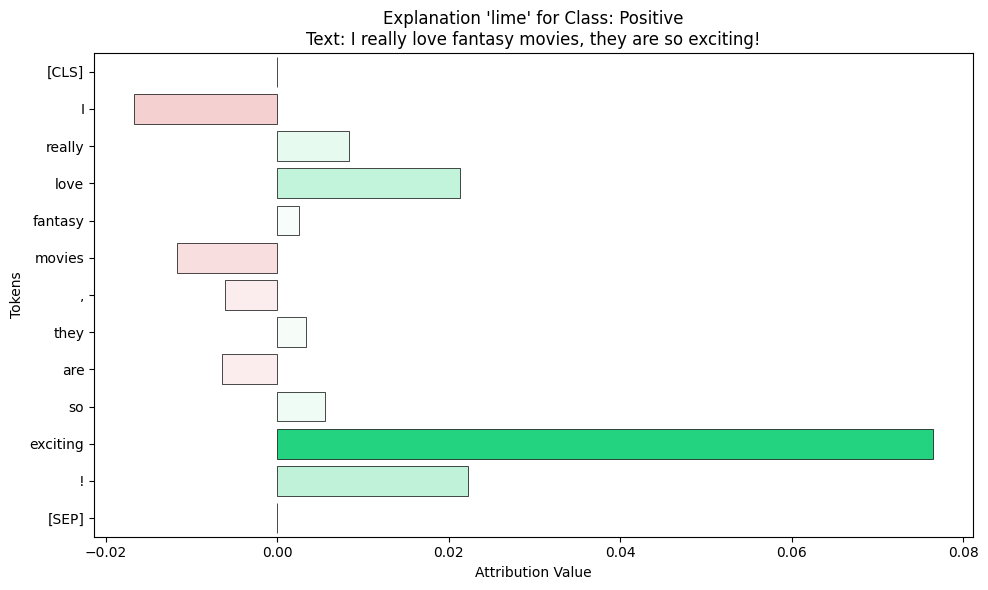

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


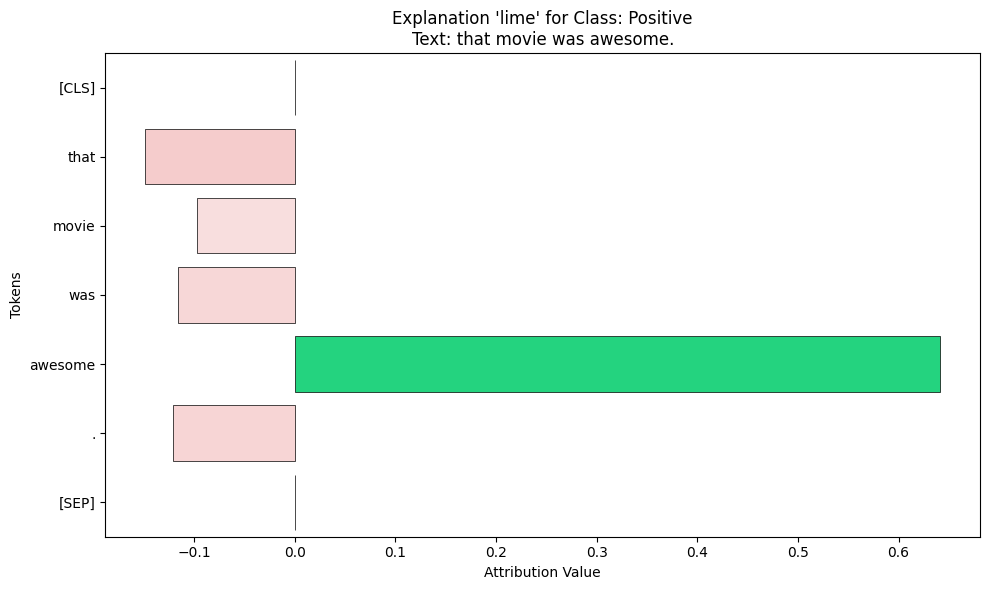

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


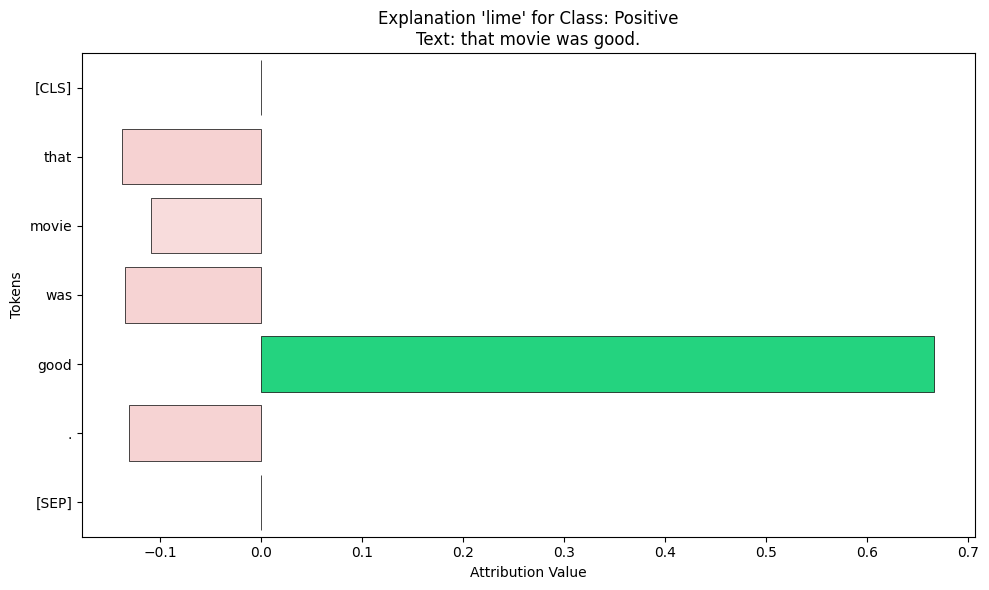

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


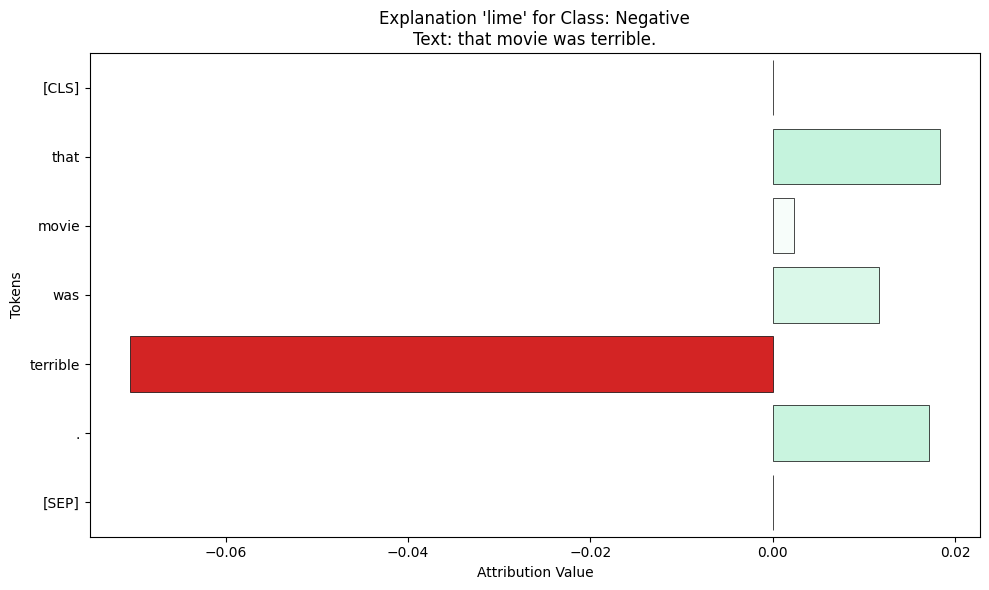

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


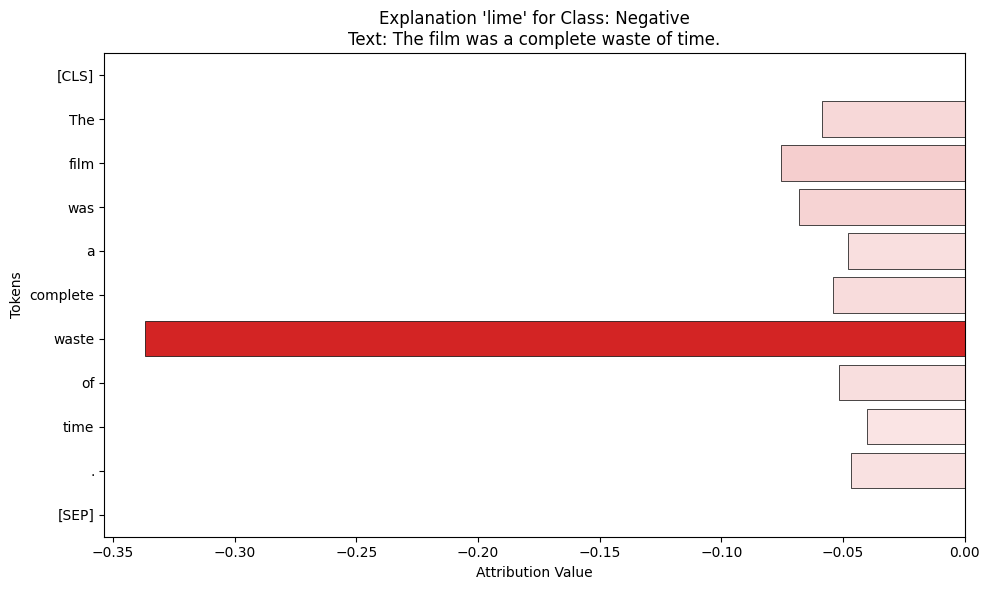

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


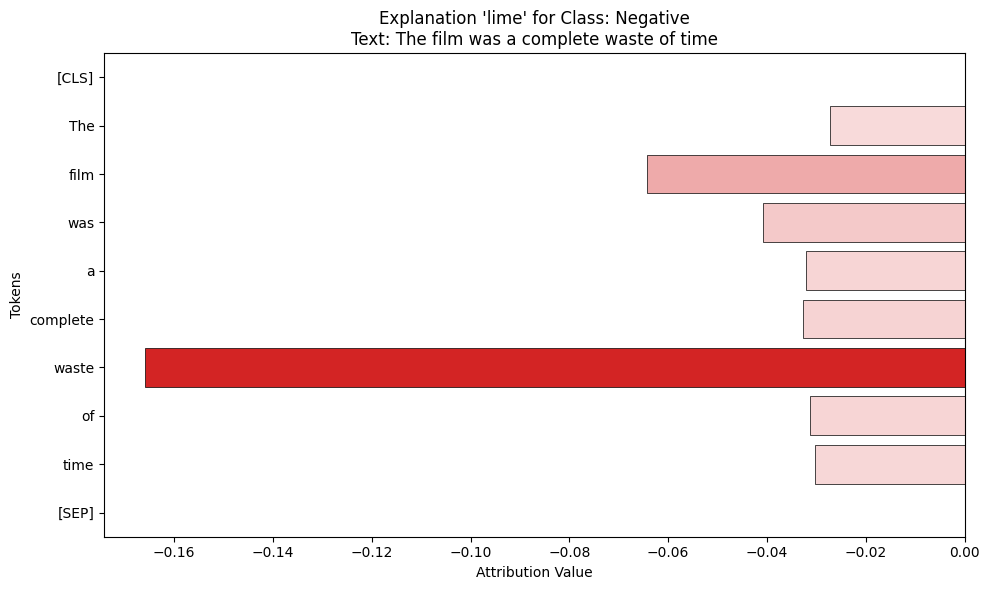

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


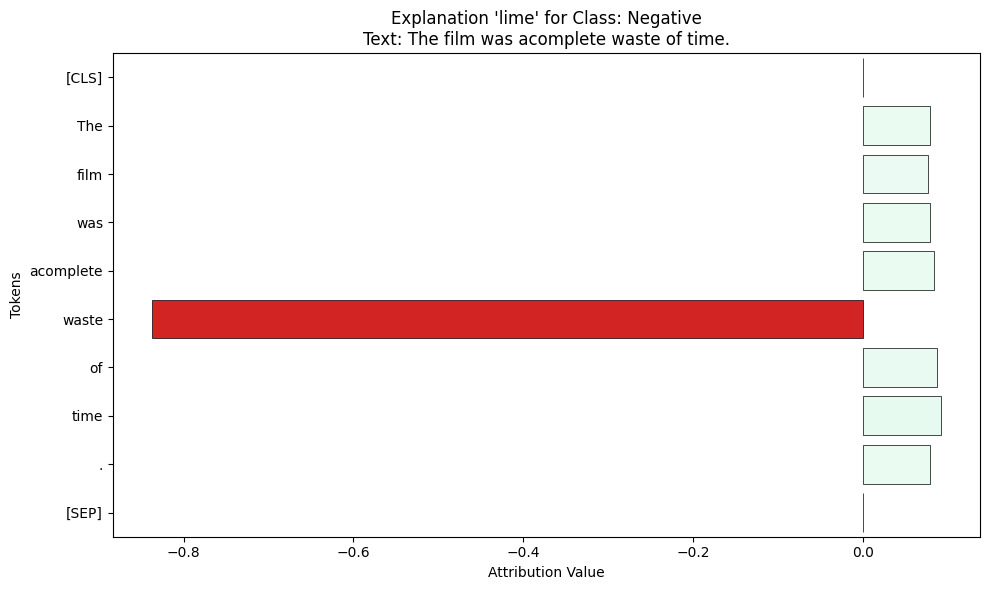

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (16) than needed (13), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


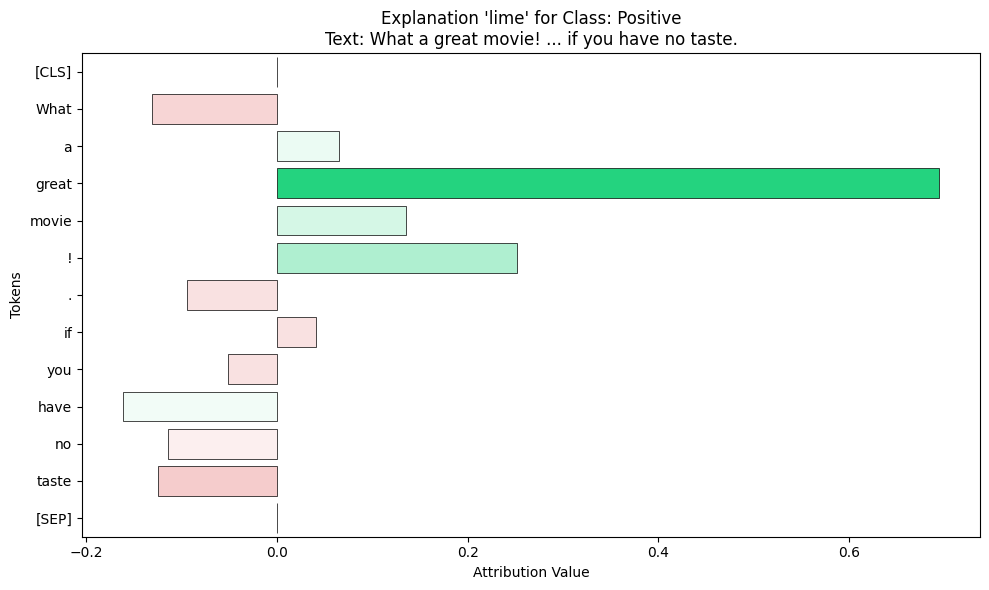

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (19) than needed (16), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


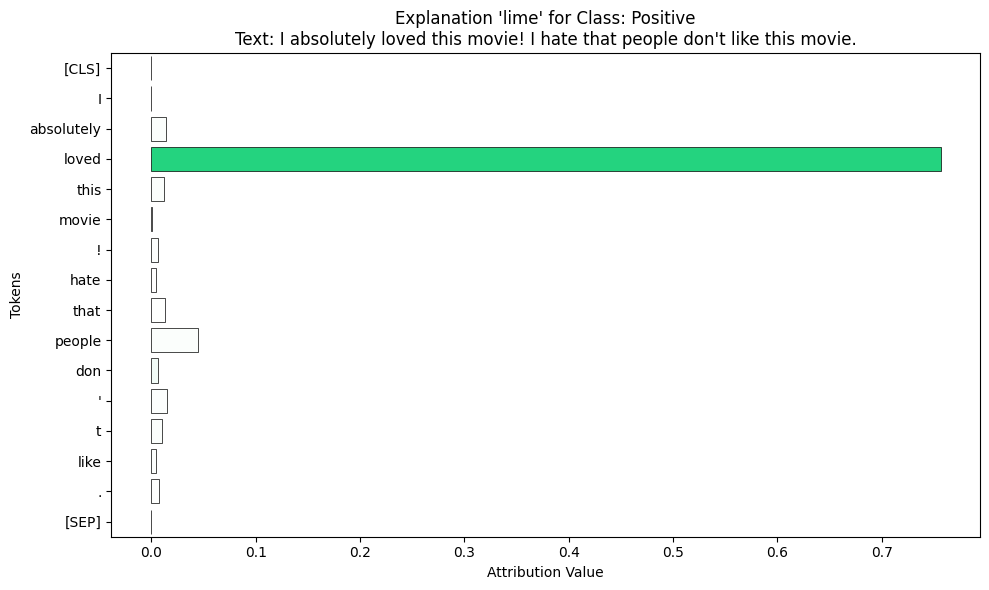

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


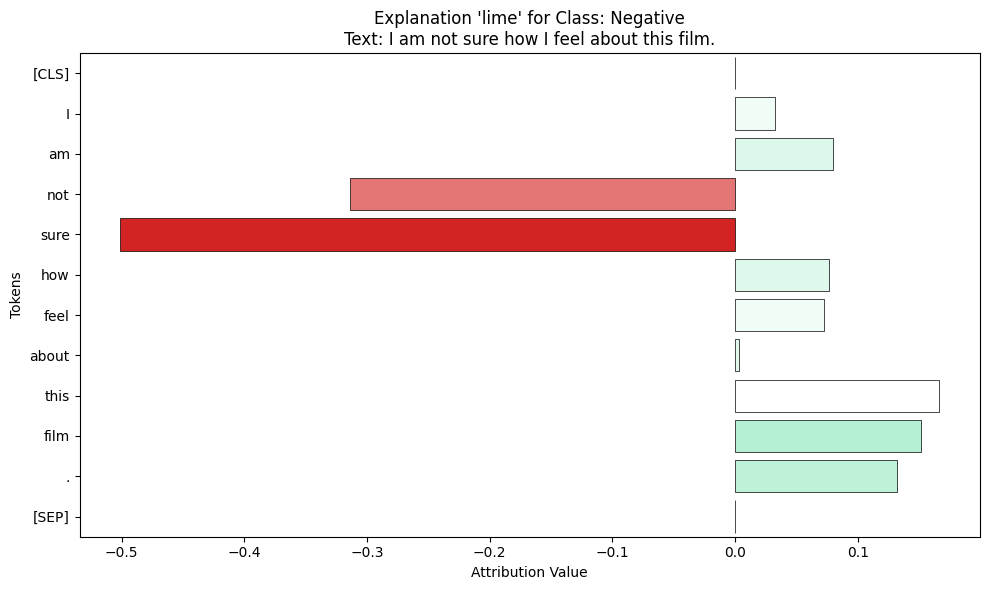

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


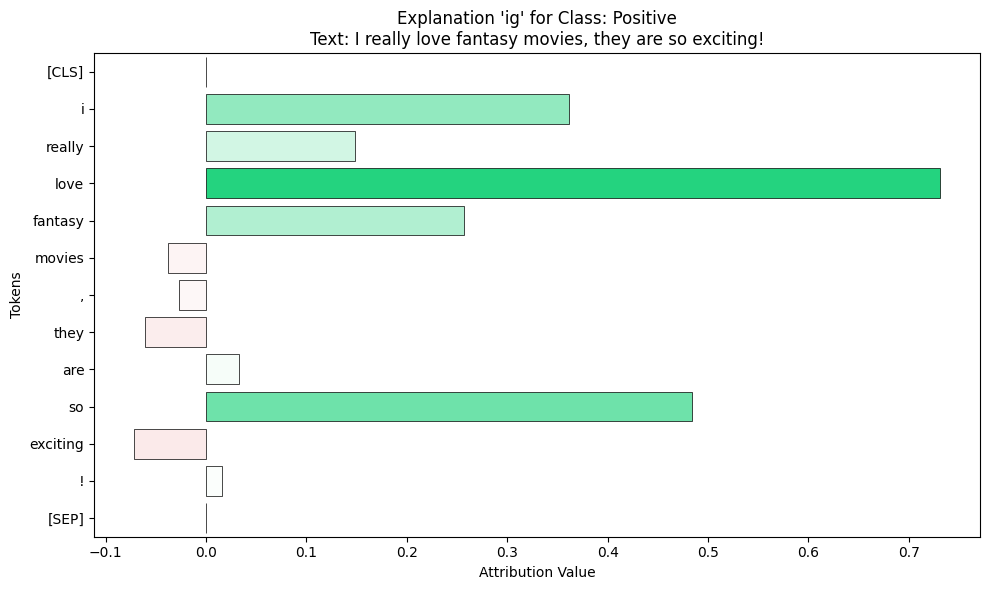

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


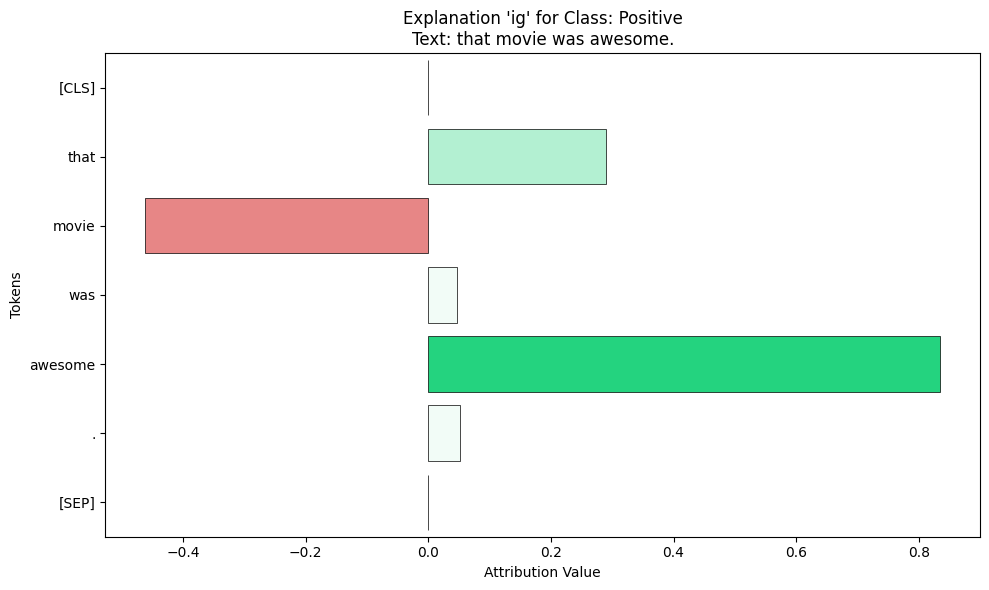

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


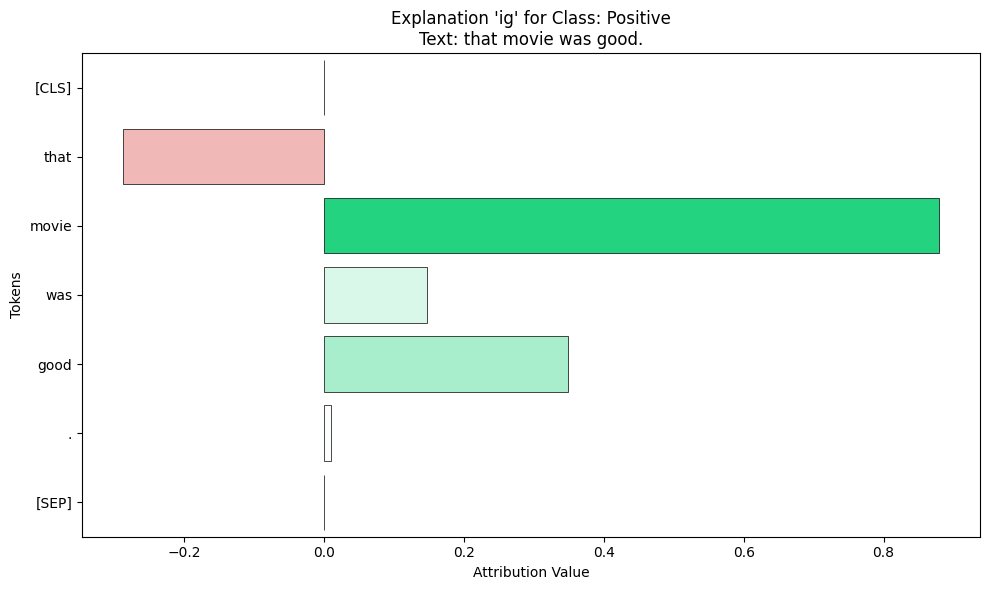

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


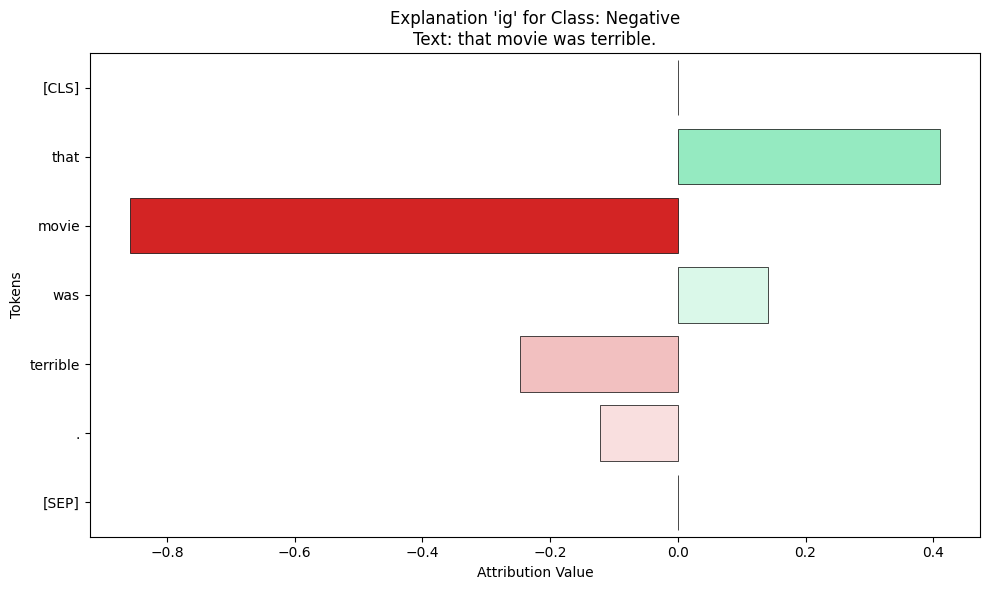

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


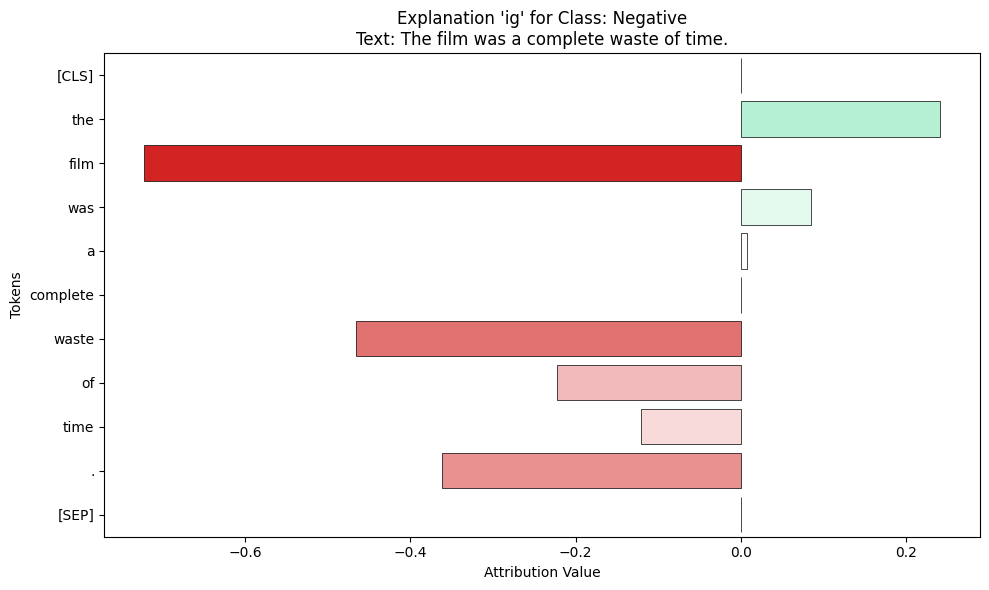

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


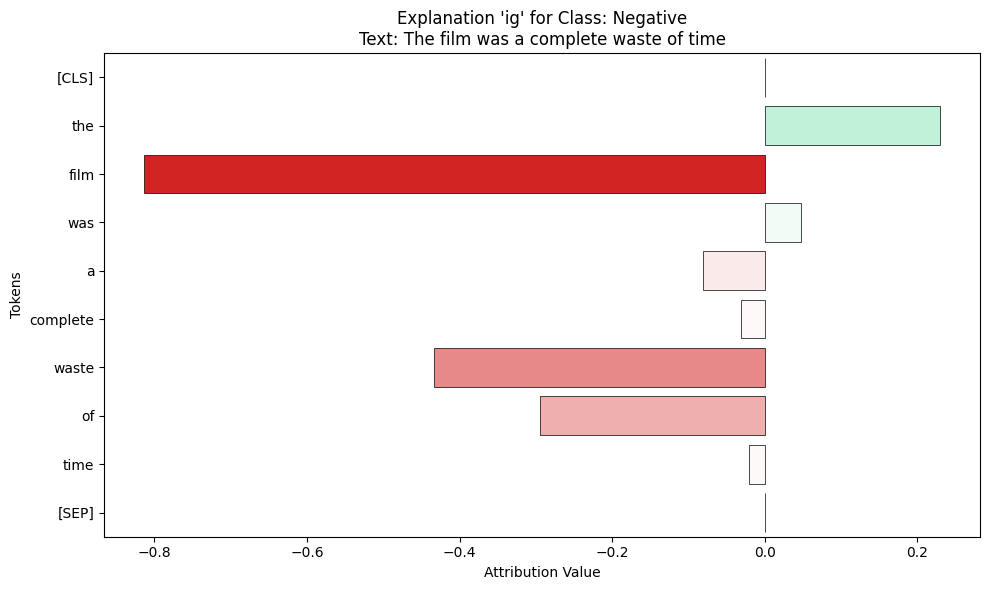

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


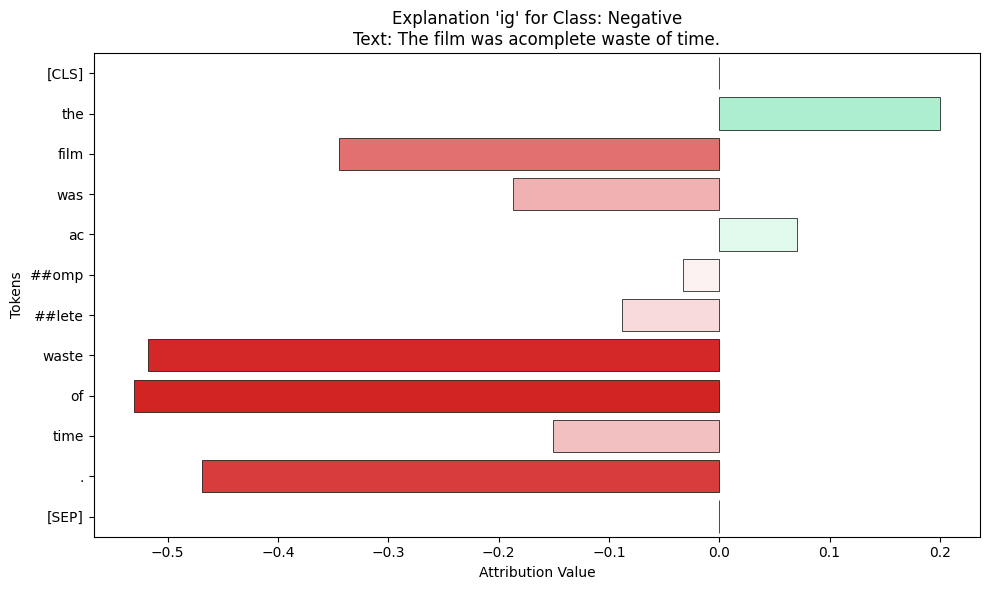

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (16) than needed (13), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


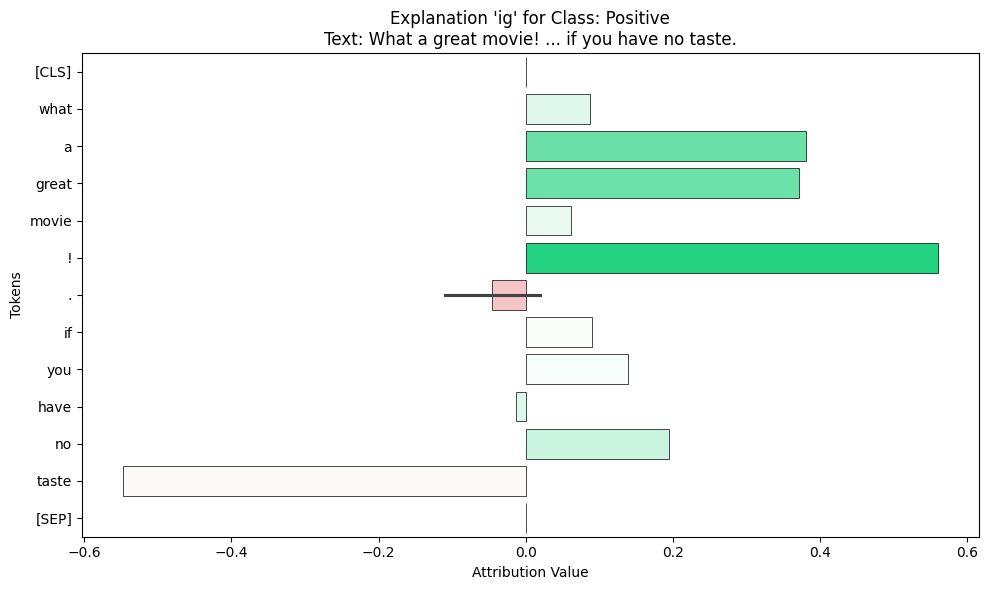

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (19) than needed (16), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


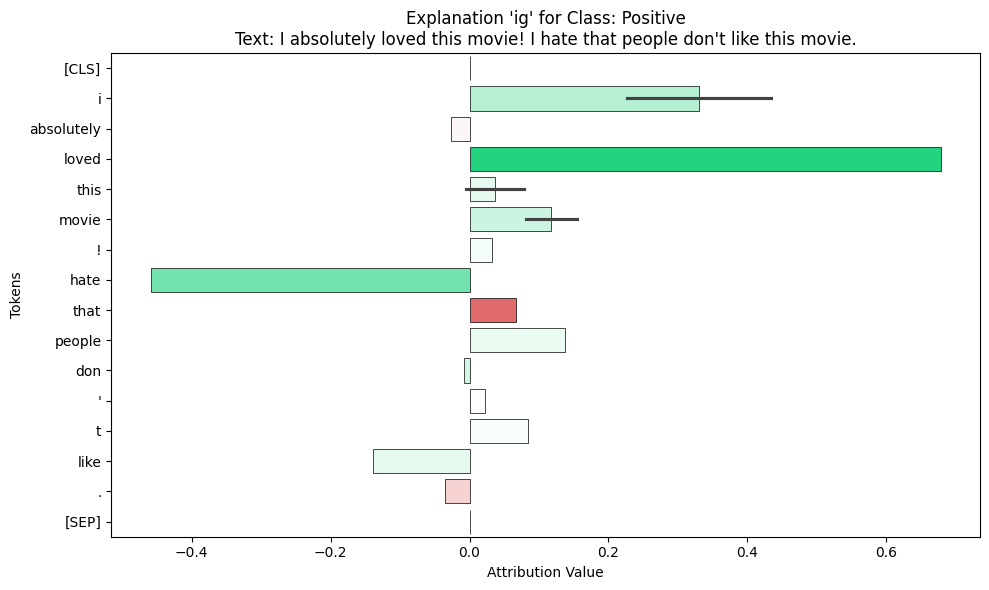

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


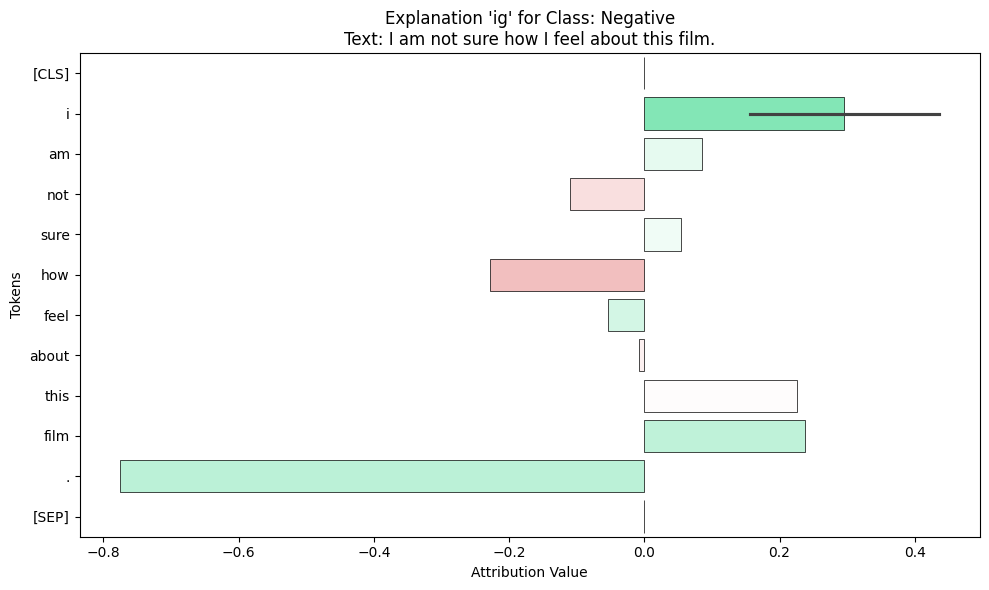

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


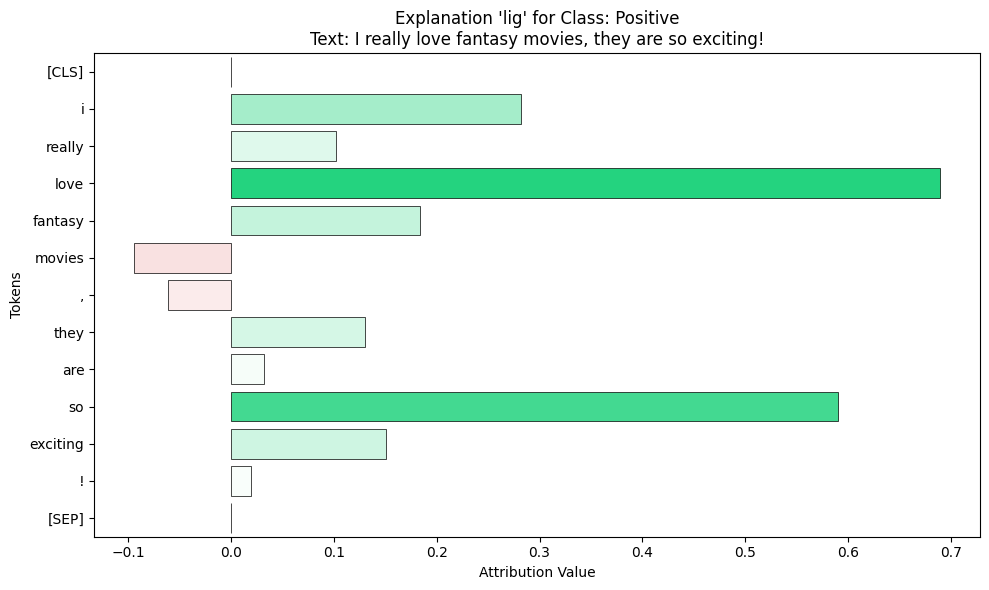

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


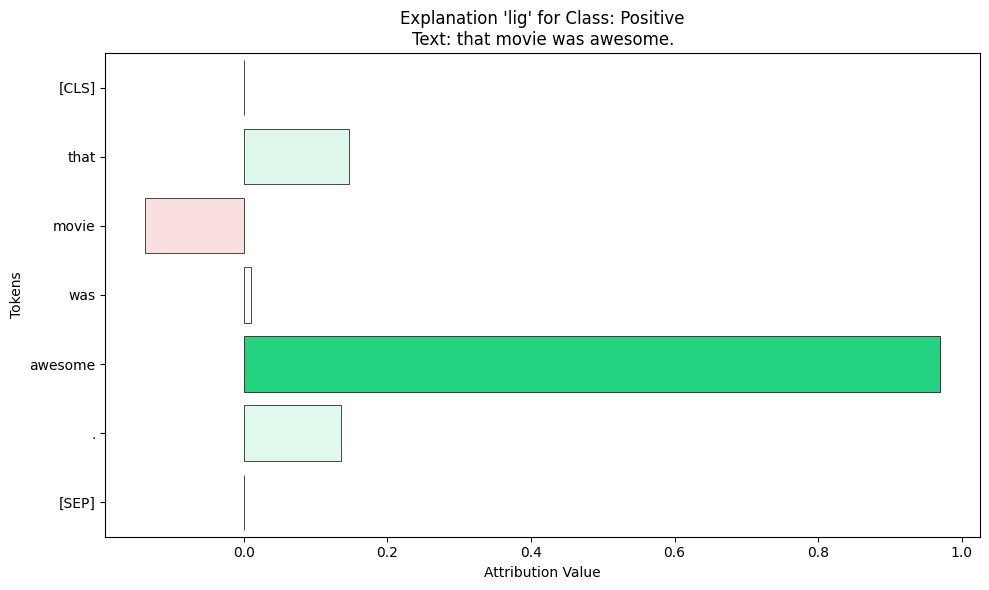

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


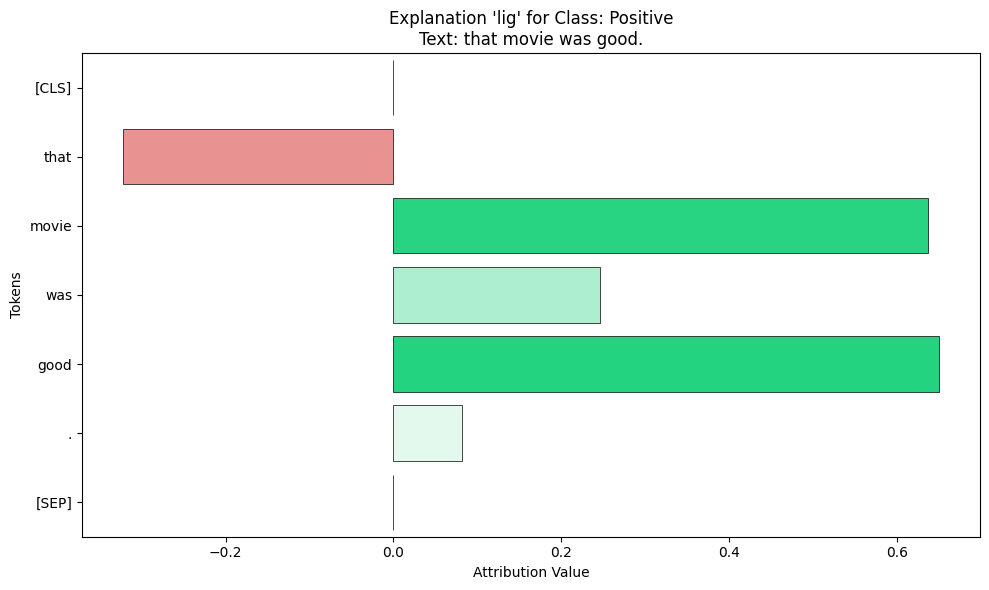

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


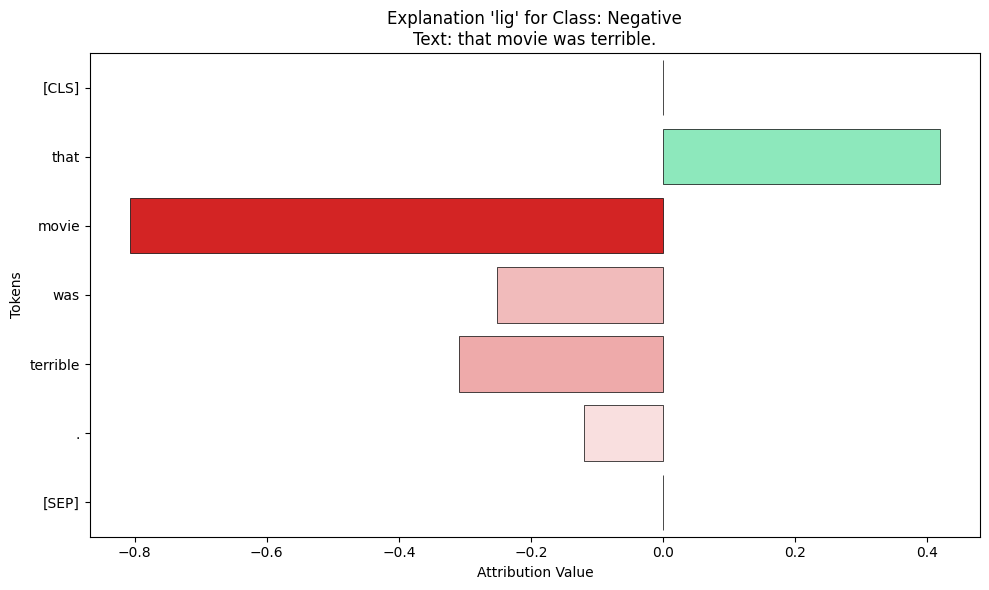

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


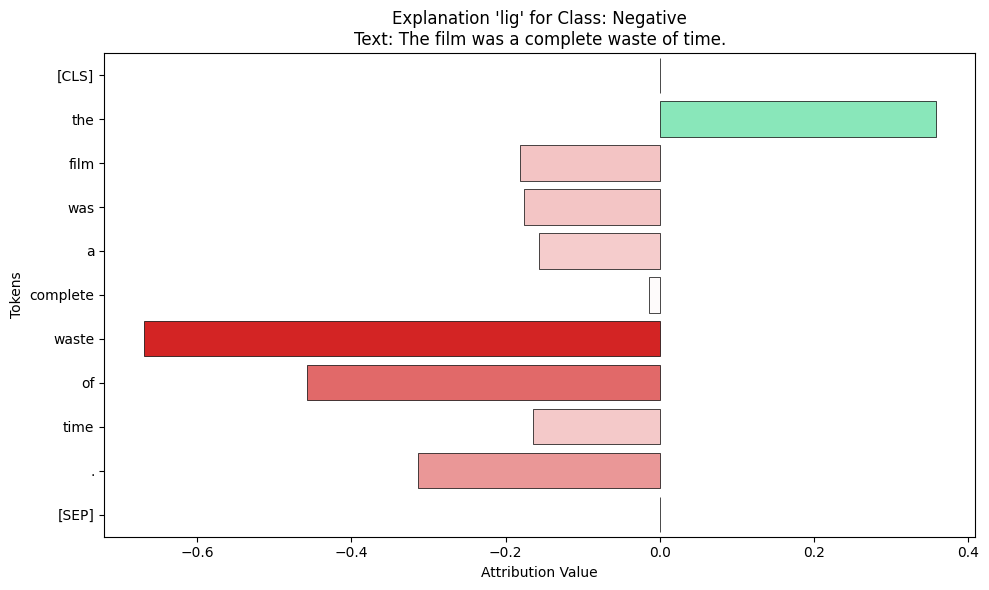

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


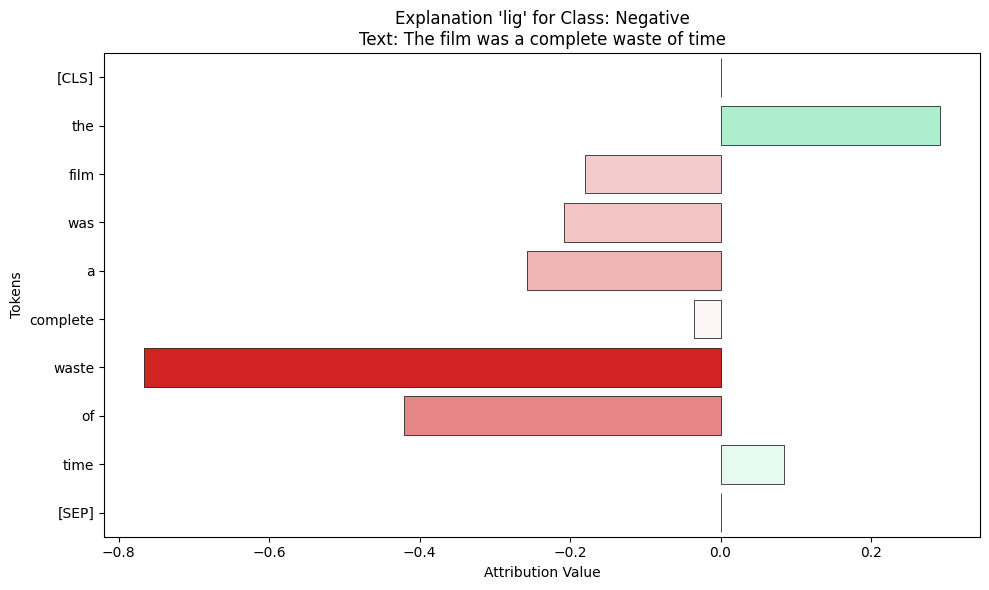

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


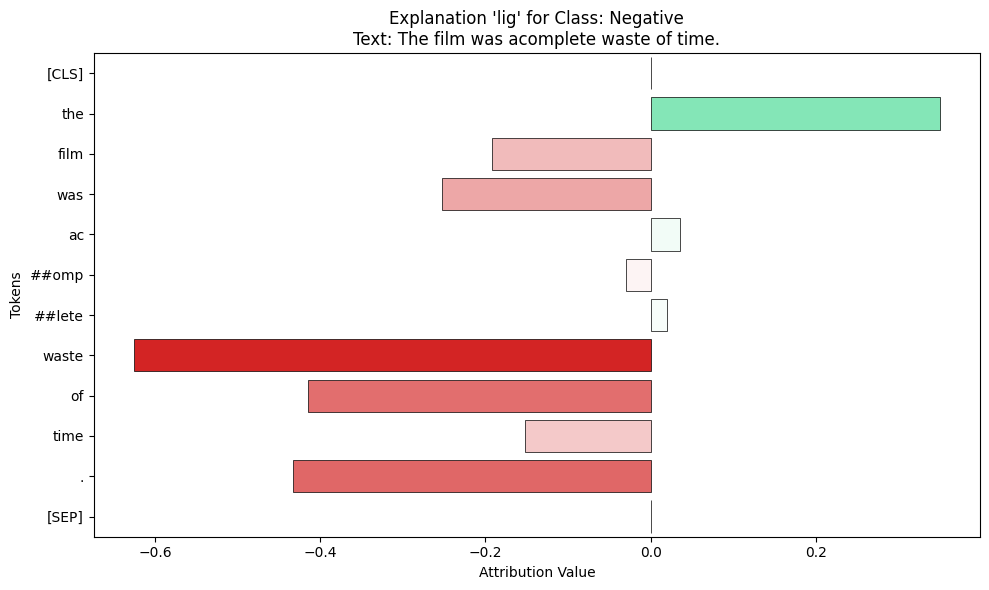

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (16) than needed (13), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


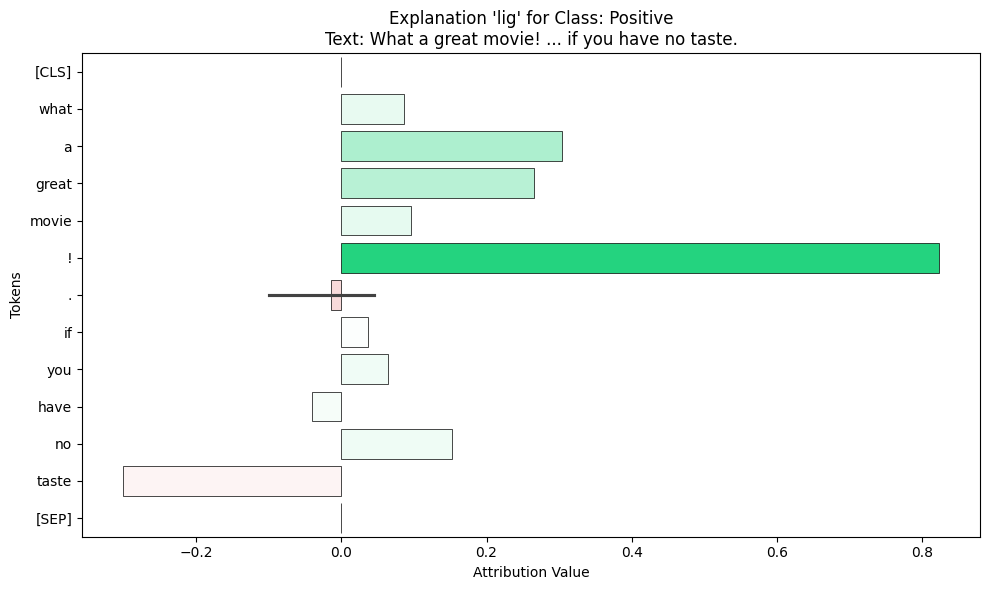

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (19) than needed (16), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


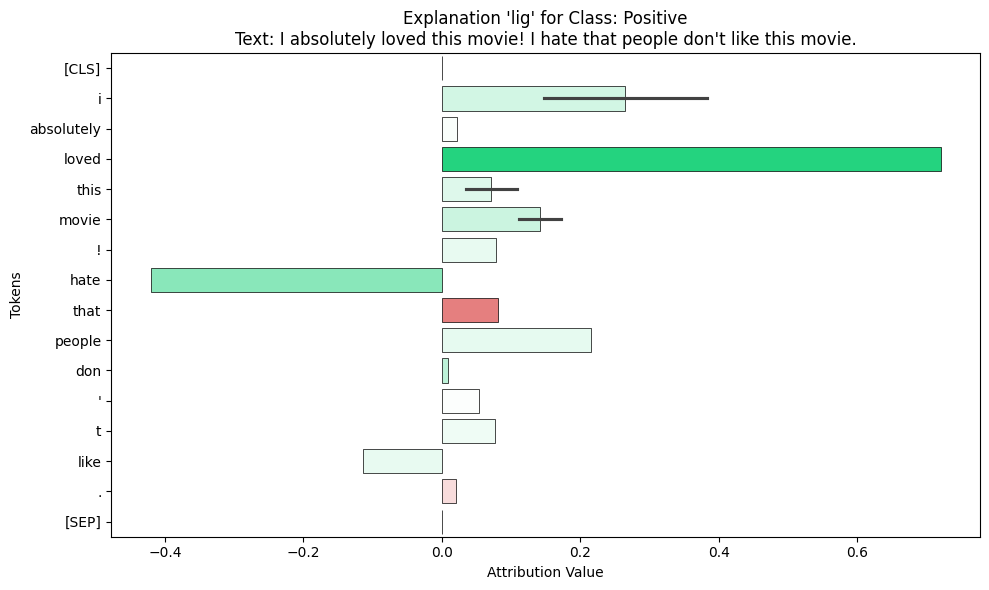

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


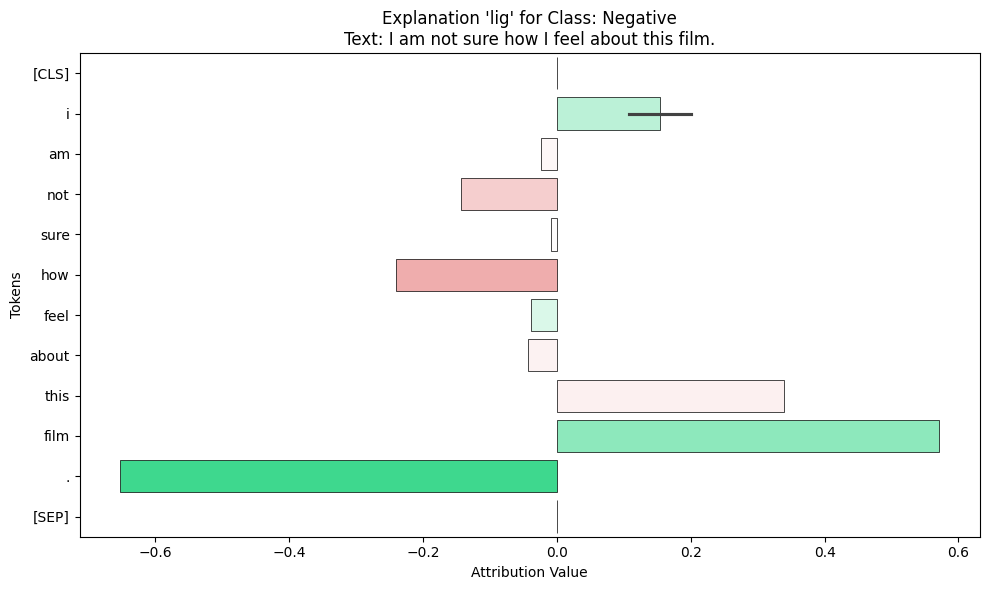

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


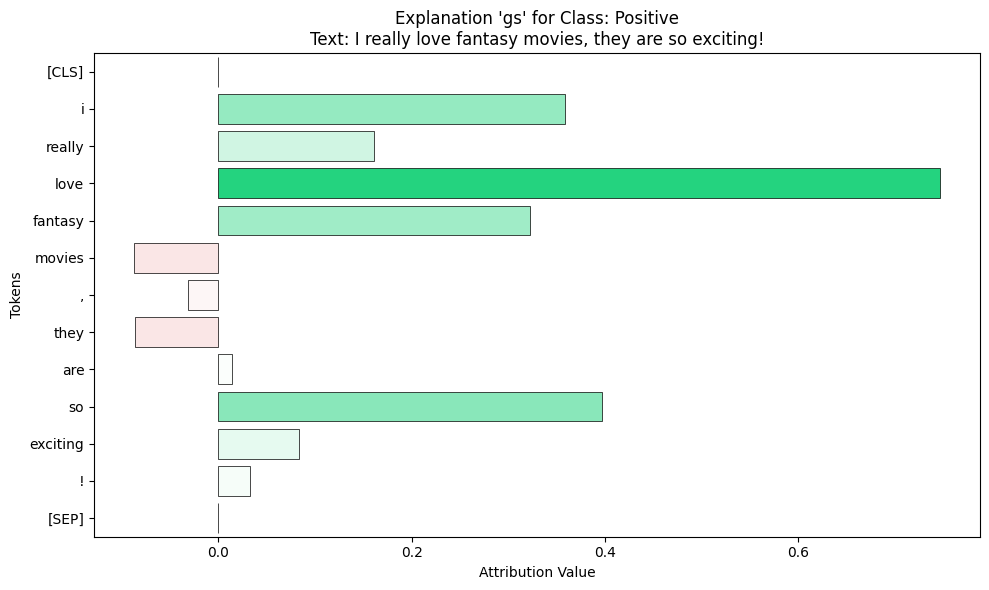

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


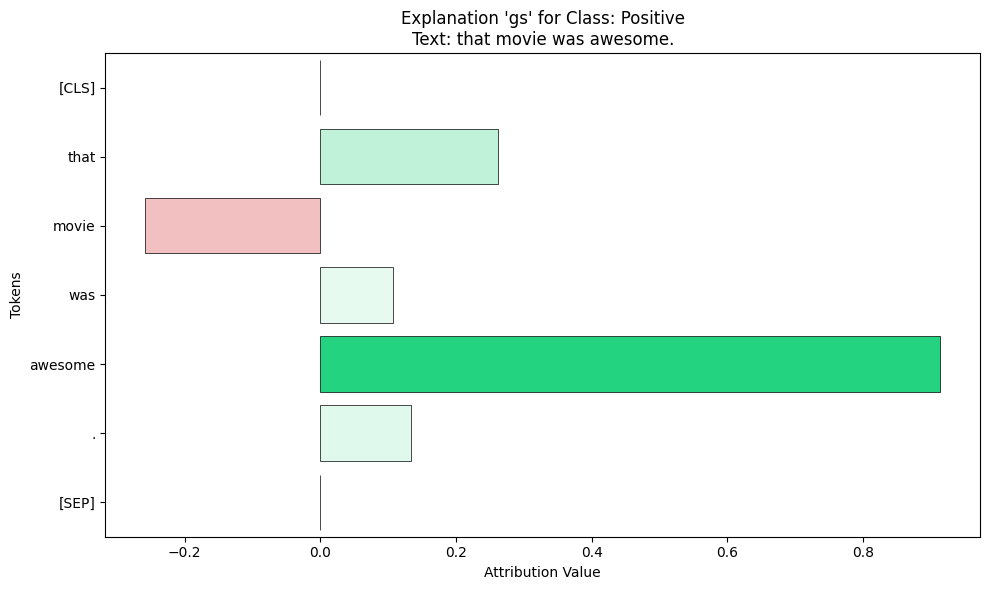

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


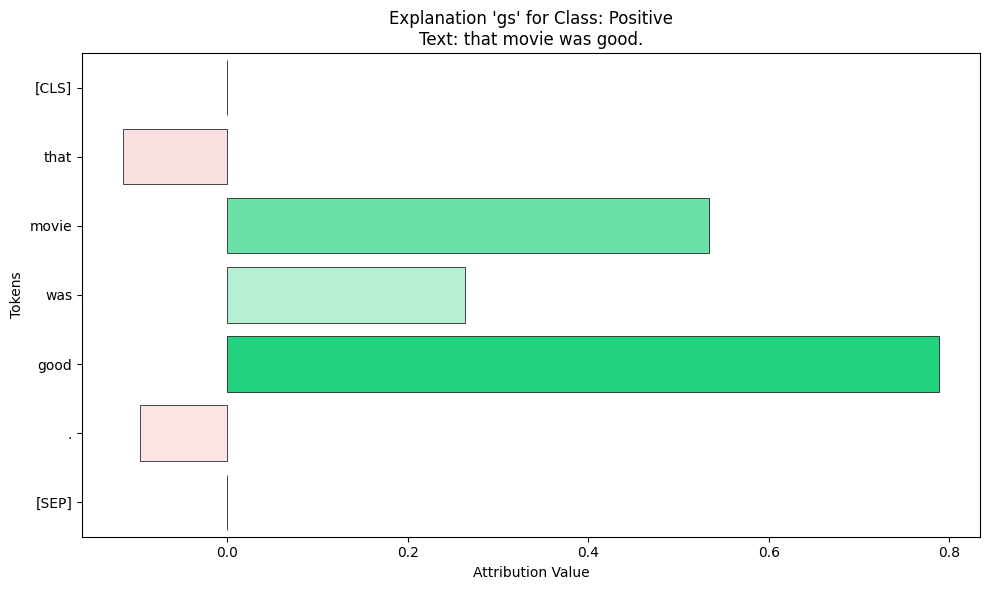

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


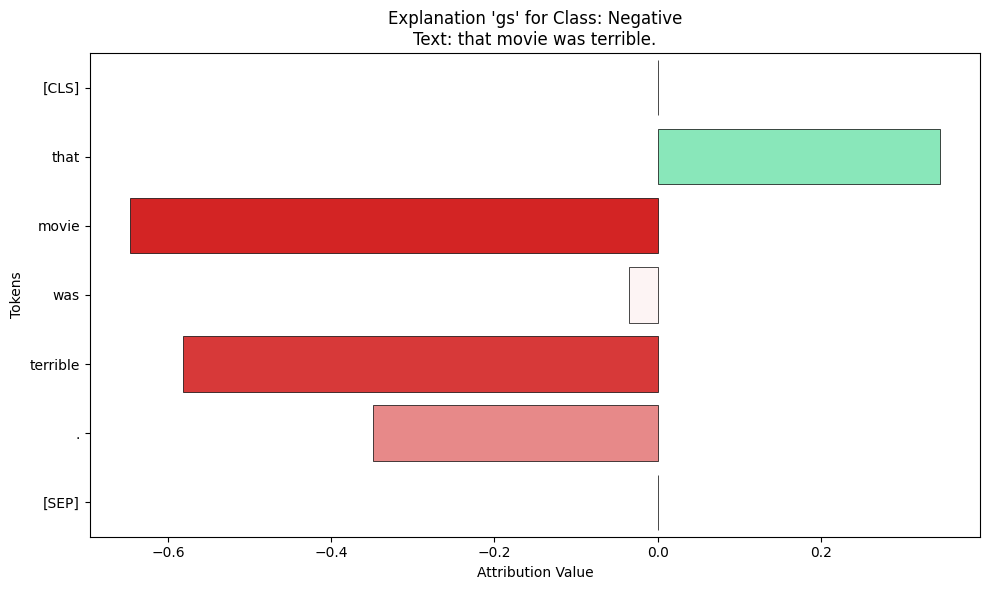

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


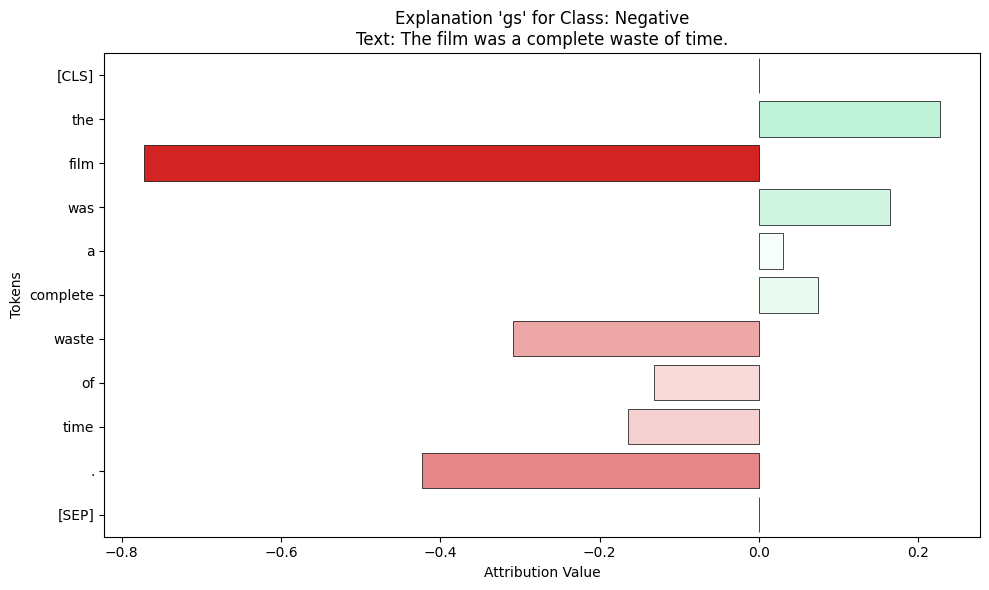

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


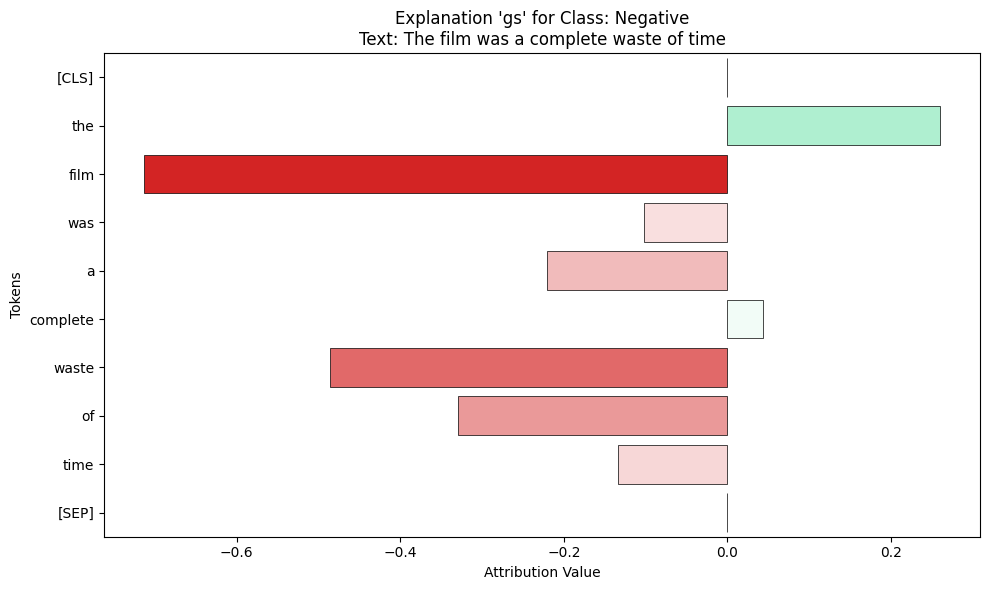

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


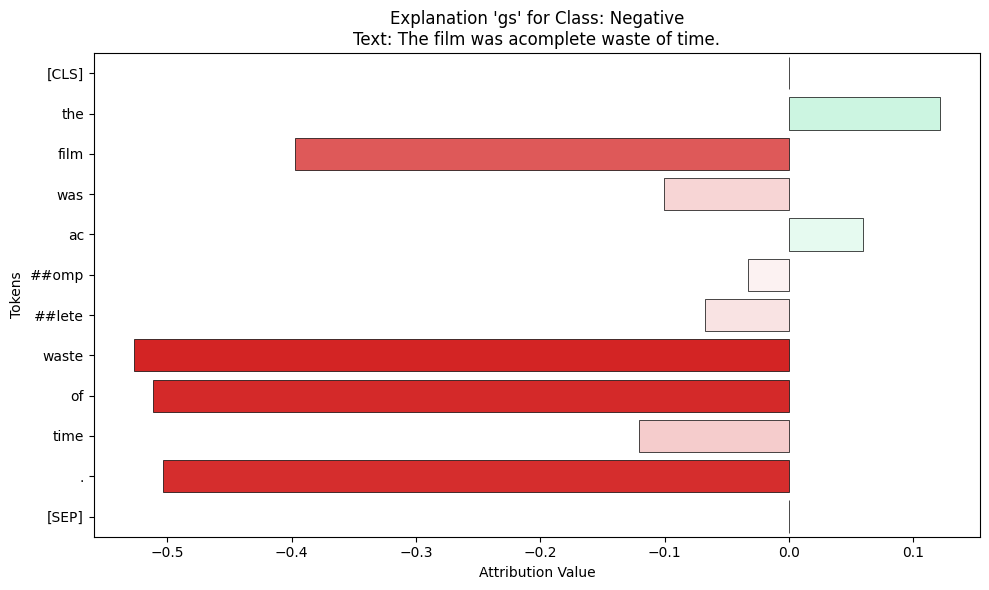

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (16) than needed (13), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


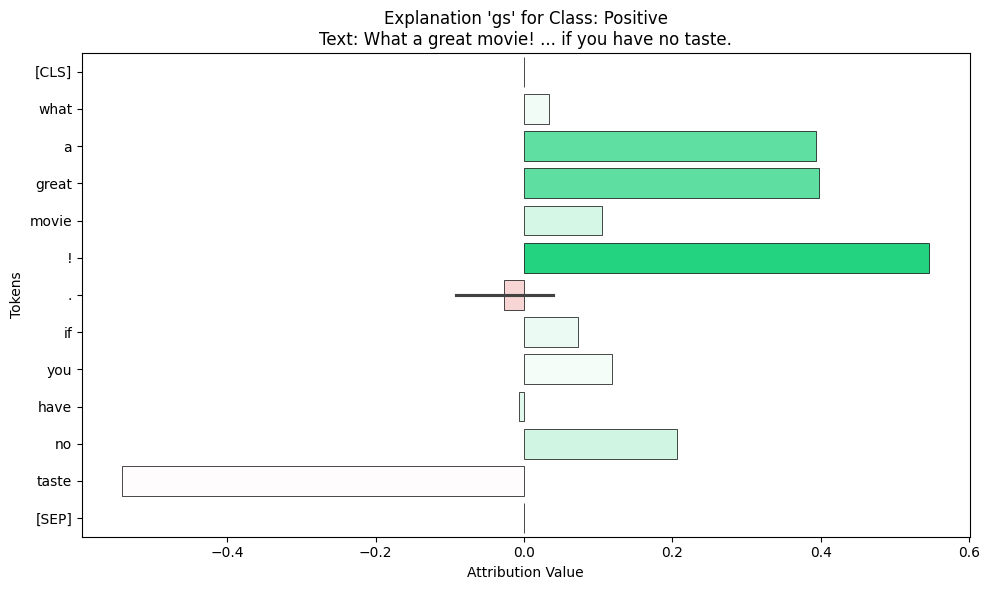

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (19) than needed (16), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


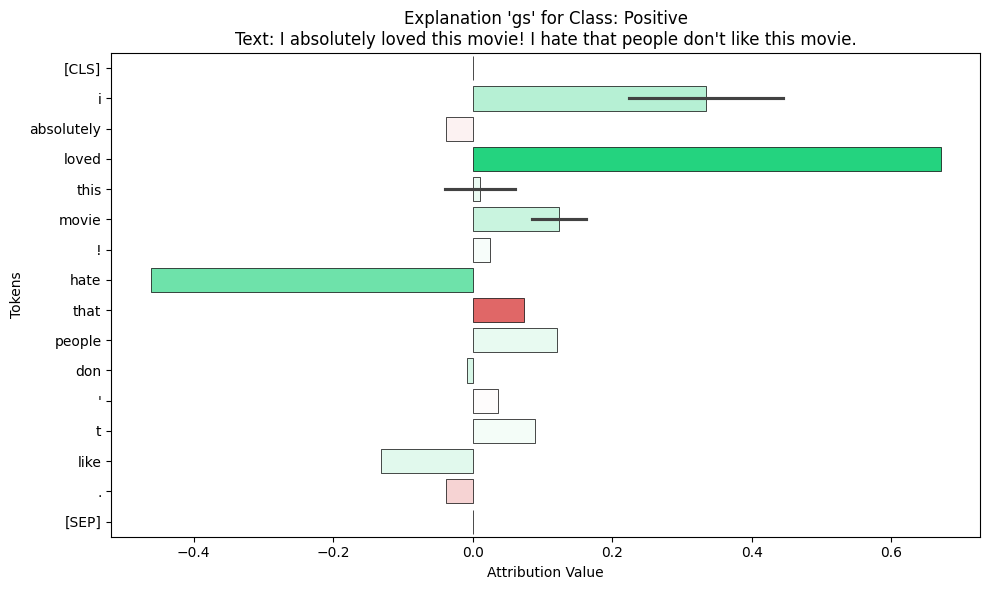

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


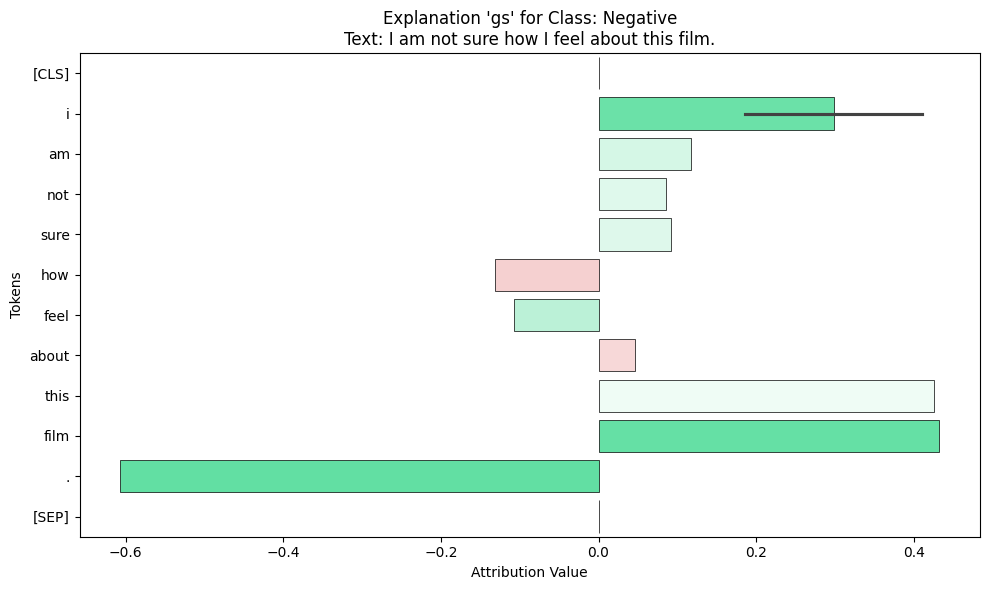

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

def plot_exp_per_classes(all_attributions):
    for entry in all_attributions:
        sentence = entry["sentence"]
        explain_type = entry['explain_type']
        tokens = [token for token, _ in entry["attributions"]]
        attributions = [attribution for _, attribution in entry["attributions"]]
        class_name = entry["pred_class"]

        if len(tokens) != len(attributions):
            print(f"⚠️ Mismatch in token/attribution length for {explain_type} on sentence: '{sentence}'")
            continue

        plt.figure(figsize=(10, 6))

        # Costruzione colormap personalizzata: rosso ↔ bianco ↔ verde
        custom_cmap = LinearSegmentedColormap.from_list(
            "custom_red_white_green",
            ["#f00707", "white", "#07f080"],
            N=256
        )
        # Normalizzazione centrata su zero
        min_attr, max_attr = min(attributions), max(attributions)
        if min_attr == max_attr:
            min_attr -= 1e-6
            max_attr += 1e-6
        vabs = max(abs(min_attr), abs(max_attr))
        normed = [(val + vabs) / (2 * vabs) for val in attributions]  # mappati in [0, 1]
        # Applica la colormap personalizzata
        colors = [custom_cmap(val) for val in normed]

        # Plot
        sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
        plt.title(f"Explanation '{explain_type}' for Class: {class_name}\nText: {sentence}")
        plt.xlabel("Attribution Value")
        plt.ylabel("Tokens")
        plt.tight_layout()
        plt.show()


plot_exp_per_classes(bb_attributions)
plot_exp_per_classes(wb_attributions)

## Creazione e Salvataggio della Tabella di Confronto
In questa sezione, creiamo e salviamo una tabella di confronto delle attribuzioni calcolate.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import os
from collections import defaultdict
from IPython.display import display

# Path
pdf_path = "/mnt/data/attribution_comparison.pdf"
os.makedirs(os.path.dirname(pdf_path), exist_ok=True)

# Group by sentence
grouped = defaultdict(lambda: defaultdict(list))
for entry in bb_attributions:
    sentence = entry["sentence"]
    method = entry["explain_type"]
    grouped[sentence][method] = entry["attributions"]

# Funzione per normalizzare i token
def normalize_token(tok):
    return tok.lower().strip()

# Generate the PDF
with PdfPages(pdf_path) as pdf:
    for sentence, methods_dict in grouped.items():
        method_dicts = {}

        # Usa SHAP come riferimento per l'ordine dei token (o il primo metodo che trovi)
        reference_method = list(methods_dict.keys())[0]
        reference_tokens = [normalize_token(tok) for tok, _ in methods_dict[reference_method]]

        token_set = set(reference_tokens)

        # Aggiungi anche token nuovi degli altri metodi (se presenti)
        for method, attribs in methods_dict.items():
            for tok, _ in attribs:
                tok_norm = normalize_token(tok)
                if tok_norm not in token_set:
                    reference_tokens.append(tok_norm)
                    token_set.add(tok_norm)

        for method, attribs in methods_dict.items():
            norm_attribs = defaultdict(list)
            for tok, val in attribs:
                tok_norm = normalize_token(tok)
                norm_attribs[tok_norm].append(val)
            method_dicts[method.upper()] = norm_attribs

        all_tokens = reference_tokens  # 👈 usa l'ordine dei token di riferimento

        # Build the DataFrame
        data = {"Token": all_tokens}
        for method, norm_attribs in method_dicts.items():
            values = []
            for tok in all_tokens:
                if tok in norm_attribs:
                    values.append(round(sum(norm_attribs[tok]) / len(norm_attribs[tok]), 5))
                else:
                    values.append(0)
            data[method] = values

        df = pd.DataFrame(data)

        # Show in notebook
        print(f"\nAttribution Comparison for: \"{sentence}\"")
        display(df)

        # Plot
        fig, ax = plt.subplots(figsize=(10, 0.4 * len(df) + 1))
        ax.axis("off")
        ax.set_title(f"Word Attribution Comparison\nSentence: \"{sentence}\"", fontsize=12, pad=20)
        table = ax.table(cellText=df.values,
                         colLabels=df.columns,
                         cellLoc='center',
                         loc='center',
                         colColours=["#f2f2f2"] * len(df.columns))
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1, 1.5)

        pdf.savefig(fig, bbox_inches='tight')
        plt.close()

pdf_path



Attribution Comparison for: "I really love fantasy movies, they are so exciting!"


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,i,-0.08314,-0.01669
2,really,0.29797,0.00842
3,love,0.62618,0.02129
4,fantasy,-0.00447,0.00250
5,movies,-0.26797,-0.01171
6,",",0.07052,-0.00613
7,they,0.25567,0.00342
8,are,0.35415,-0.00640
9,so,0.37042,0.00563



Attribution Comparison for: "that movie was awesome."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,that,0.07222,-0.14854
2,movie,0.38100,-0.09687
3,was,0.01851,-0.11594
4,awesome,0.91167,0.64145
5,.,0.13467,-0.12125
6,[sep],0.00000,0.00000



Attribution Comparison for: "that movie was good."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,that,0.02951,-0.13698
2,movie,0.44230,-0.10884
3,was,0.01302,-0.13462
4,good,0.88778,0.66631
5,.,0.12323,-0.13094
6,[sep],0.00000,0.00000



Attribution Comparison for: "that movie was terrible."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,that,-0.14621,0.01831
2,movie,-0.50064,0.00238
3,was,-0.11264,0.01169
4,terrible,-0.81714,-0.07047
5,.,-0.21813,0.01713
6,[sep],0.00000,0.00000



Attribution Comparison for: "The film was a complete waste of time."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,the,-0.06264,-0.05851
2,film,-0.29108,-0.07564
3,was,-0.20261,-0.06818
4,a,-0.02321,-0.04792
5,complete,-0.25050,-0.05396
6,waste,-0.88319,-0.33682
7,of,-0.10857,-0.05147
8,time,-0.09667,-0.04009
9,.,-0.07647,-0.04653



Attribution Comparison for: "The film was a complete waste of time"


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,the,-0.06976,-0.02728
2,film,-0.40049,-0.06428
3,was,-0.13393,-0.04085
4,a,0.05077,-0.03219
5,complete,-0.13817,-0.03278
6,waste,-0.87862,-0.16586
7,of,-0.10975,-0.03132
8,time,-0.10542,-0.03037
9,[sep],0.00000,0.00000



Attribution Comparison for: "The film was acomplete waste of time."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,the,-0.03412,0.07952
2,film,-0.05424,0.07684
3,was,-0.11941,0.07886
4,ac,0.01225,0.00000
5,omp,-0.09939,0.00000
6,lete,-0.00229,0.00000
7,waste,-0.96732,-0.83694
8,of,-0.16778,0.08749
9,time,-0.02315,0.09180



Attribution Comparison for: "What a great movie! ... if you have no taste."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,what,-0.17935,-0.13129
2,a,0.07584,0.06496
3,great,0.72946,0.69424
4,movie,0.18197,0.13555
5,!,-0.03310,0.25158
6,.,-0.00126,-0.09437
7,.,-0.00126,-0.09437
8,.,-0.00126,-0.09437
9,if,0.08871,0.04133



Attribution Comparison for: "I absolutely loved this movie! I hate that people don't like this movie."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,i,0.01003,-0.00061
2,absolutely,0.47640,0.01444
3,loved,0.80154,0.75622
4,this,0.04472,0.01238
5,movie,-0.03962,0.00094
6,!,-0.11198,0.00617
7,i,0.01003,-0.00061
8,hate,0.00964,0.00422
9,that,-0.01613,0.01345



Attribution Comparison for: "I am not sure how I feel about this film."


,Token,SHAP,LIME
0,[cls],0.00000,0.00000
1,i,0.00912,0.03227
2,am,-0.26733,0.07995
3,not,-0.36600,-0.31420
4,sure,-0.65059,-0.50102
5,how,-0.07112,0.07681
6,i,0.00912,0.03227
7,feel,0.23920,0.07226
8,about,-0.06972,0.00284
9,this,-0.05923,0.16628


'/mnt/data/attribution_comparison.pdf'

In [ ]:

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import os
from matplotlib import rcParams
from collections import defaultdict
from IPython.display import display

# Set path and ensure directory exists
pdf_path = "/mnt/data/attribution_comparison.pdf"
os.makedirs(os.path.dirname(pdf_path), exist_ok=True)

# Group all attributions by sentence
grouped = defaultdict(lambda: defaultdict(list))
for entry in wb_attributions:
    sentence = entry["sentence"]
    method = entry["explain_type"]
    grouped[sentence][method] = entry["attributions"]

# Generate the PDF with rounded values
with PdfPages(pdf_path) as pdf:
    for sentence, methods_dict in grouped.items():
        tokens = [tok for tok, _ in list(methods_dict.values())[0]]
        data = {"Token": tokens}

        for method, attribs in methods_dict.items():
            values = [round(val, 5) for _, val in attribs]  # rounded attribution values
            data[method.upper()] = values

        df = pd.DataFrame(data)

        # Show table in notebook
        print(f"\nAttribution Comparison for: \"{sentence}\"\n")
        display(df)

        # Plot
        fig, ax = plt.subplots(figsize=(10, 0.4 * len(df) + 1))
        ax.axis("off")
        ax.set_title(f"Word Attribution Comparison\nSentence: \"{sentence}\"", fontsize=12, pad=20)
        table = ax.table(cellText=df.values,
                         colLabels=df.columns,
                         cellLoc='center',
                         loc='center',
                         colColours=["#f2f2f2"] * len(df.columns))
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1, 1.5)

        pdf.savefig(fig, bbox_inches='tight')
        plt.close()

pdf_path



Attribution Comparison for: "I really love fantasy movies, they are so exciting!"



,Token,IG,LIG,GS
0,[CLS],0.00000,0.00000,0.00000
1,i,0.36153,0.28203,0.35937
2,really,0.14885,0.10209,0.16113
3,love,0.73073,0.68902,0.74701
4,fantasy,0.25707,0.18390,0.32311
5,movies,-0.03793,-0.09392,-0.08716
6,",",-0.02715,-0.06115,-0.03198
7,they,-0.06098,0.12999,-0.08608
8,are,0.03287,0.03185,0.01438
9,so,0.48452,0.58981,0.39763



Attribution Comparison for: "that movie was awesome."



,Token,IG,LIG,GS
0,[CLS],0.00000,0.00000,0.00000
1,that,0.29043,0.14658,0.26246
2,movie,-0.46202,-0.13766,-0.25829
3,was,0.04707,0.01033,0.10636
4,awesome,0.83507,0.97021,0.91382
5,.,0.05135,0.13471,0.13421
6,[SEP],0.00000,0.00000,0.00000



Attribution Comparison for: "that movie was good."



,Token,IG,LIG,GS
0,[CLS],0.00000,0.00000,0.00000
1,that,-0.28778,-0.32268,-0.11611
2,movie,0.87955,0.63664,0.53392
3,was,0.14797,0.24638,0.26375
4,good,0.34868,0.65048,0.78904
5,.,0.01013,0.08216,-0.09645
6,[SEP],0.00000,0.00000,0.00000



Attribution Comparison for: "that movie was terrible."



,Token,IG,LIG,GS
0,[CLS],-0.00000,-0.00000,-0.00000
1,that,0.40985,0.41933,0.34583
2,movie,-0.85776,-0.80714,-0.64690
3,was,0.14180,-0.25063,-0.03538
4,terrible,-0.24774,-0.30912,-0.58235
5,.,-0.12158,-0.11963,-0.34863
6,[SEP],-0.00000,-0.00000,-0.00000



Attribution Comparison for: "The film was a complete waste of time."



,Token,IG,LIG,GS
0,[CLS],-0.00000,-0.00000,-0.00000
1,the,0.24112,0.35792,0.22783
2,film,-0.72252,-0.18121,-0.77215
3,was,0.08503,-0.17670,0.16419
4,a,0.00690,-0.15688,0.02994
5,complete,-0.00021,-0.01446,0.07395
6,waste,-0.46631,-0.66944,-0.30861
7,of,-0.22268,-0.45759,-0.13106
8,time,-0.12063,-0.16411,-0.16481
9,.,-0.36189,-0.31391,-0.42305



Attribution Comparison for: "The film was a complete waste of time"



,Token,IG,LIG,GS
0,[CLS],-0.00000,-0.00000,-0.00000
1,the,0.22990,0.29192,0.26015
2,film,-0.81372,-0.18055,-0.71338
3,was,0.04711,-0.20800,-0.10210
4,a,-0.08052,-0.25773,-0.22094
5,complete,-0.03083,-0.03567,0.04307
6,waste,-0.43387,-0.76624,-0.48550
7,of,-0.29446,-0.42058,-0.32976
8,time,-0.02021,0.08486,-0.13363
9,[SEP],-0.00000,-0.00000,-0.00000



Attribution Comparison for: "The film was acomplete waste of time."



,Token,IG,LIG,GS
0,[CLS],-0.00000,-0.00000,-0.00000
1,the,0.19980,0.34989,0.12141
2,film,-0.34496,-0.19171,-0.39731
3,was,-0.18698,-0.25283,-0.10030
4,ac,0.07075,0.03598,0.05956
5,##omp,-0.03266,-0.02973,-0.03264
6,##lete,-0.08820,0.01976,-0.06768
7,waste,-0.51810,-0.62545,-0.52690
8,of,-0.53047,-0.41474,-0.51189
9,time,-0.15069,-0.15264,-0.12071



Attribution Comparison for: "What a great movie! ... if you have no taste."



,Token,IG,LIG,GS
0,[CLS],0.00000,0.00000,0.00000
1,what,0.08671,0.08594,0.03359
2,a,0.38033,0.30355,0.39336
3,great,0.37175,0.26569,0.39805
4,movie,0.06096,0.09604,0.10492
5,!,0.55974,0.82335,0.54664
6,.,-0.14457,-0.13535,-0.10314
7,.,0.01610,0.00851,0.04852
8,.,0.02025,0.05650,0.02982
9,if,0.08989,0.03723,0.07327



Attribution Comparison for: "I absolutely loved this movie! I hate that people don't like this movie."



,Token,IG,LIG,GS
0,[CLS],0.00000,0.00000,0.00000
1,i,0.22692,0.14680,0.22447
2,absolutely,-0.02651,0.02141,-0.03908
3,loved,0.67796,0.71988,0.67052
4,this,0.07798,0.10850,0.06090
5,movie,0.15426,0.17262,0.16264
6,!,0.03298,0.07775,0.02466
7,i,0.43398,0.38253,0.44433
8,hate,-0.45906,-0.42053,-0.46181
9,that,0.06619,0.08063,0.07290



Attribution Comparison for: "I am not sure how I feel about this film."



,Token,IG,LIG,GS
0,[CLS],-0.00000,-0.00000,-0.00000
1,i,0.43589,0.20055,0.41097
2,am,0.08550,-0.02314,0.11753
3,not,-0.11053,-0.14273,0.08603
4,sure,0.05403,-0.00840,0.09242
5,how,-0.22893,-0.24064,-0.13143
6,i,0.15575,0.10747,0.18628
7,feel,-0.05303,-0.03859,-0.10721
8,about,-0.00784,-0.04339,0.04678
9,this,0.22654,0.33909,0.42524


'/mnt/data/attribution_comparison.pdf'

### **Conversione della Tabella in PDF**
In questa sezione, convertiamo la tabella di confronto in un file PDF.

# Aversarial Attack with TextAttack

We now try to fool the model using an adversarial library, i.e. TextAttack

In [ ]:
!pip install textattack

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.7/54.7 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 40.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 51.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 445.7/445.7 kB 26.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 491.2/491.2 kB 29.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 53.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.1/55.1 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
from textattack.attack_recipes import TextFoolerJin2019
from textattack.models.wrappers import HuggingFaceModelWrapper
import nltk
nltk.download('averaged_perceptron_tagger_eng')


# Wrappa il modello per TextAttack
model_wrapper = HuggingFaceModelWrapper(model, tokenizer)

# Scegli un attacco, es. TextFooler
attack = TextFoolerJin2019.build(model_wrapper)

# Test su una recensione
text = "This movie was absolutely terrible, I hated it."
attack_result = attack.attack(text, 0)
print(attack_result)


textattack: Updating TextAttack package dependencies.
textattack: Downloading NLTK required packages.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package omw to /root/nltk_data...
[nltk_data] Downloading package universal_tagset to /root/nltk_data...
[nltk_data]   Unzipping taggers/universal_tagset.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.
textattack: Downloading https://textattack.s3.amazonaws.com/word_embeddings/paragramcf.
100%|██████████| 4

0 (100%) --> 1 (80%)

This movie was absolutely terrible, I hated it.

These theaters was quite fearsome, me reviled it.


In [ ]:
from textattack.attack_recipes import TextBuggerLi2018

# Wrappa il modello per TextAttack
model_wrapper = HuggingFaceModelWrapper(model, tokenizer)

# Configura TextBugger
attack = TextBuggerLi2018.build(model_wrapper)

# Test con una frase negativa
text = "The film was terrible."
ground_truth_label = 0  # Supponiamo che "0" sia NEGATIVO

# Esegui l'attacco
attack_result = attack.attack(text, ground_truth_label)
print(attack_result)

textattack: Unknown if model of class <class 'transformers.models.bert.modeling_bert.BertForSequenceClassification'> compatible with goal function <class 'textattack.goal_functions.classification.untargeted_classification.UntargetedClassification'>.


0 (100%) --> [FAILED]

The film was terrible.


### **Substitution-based Attacks**

Sostituire parole con sinonimi, caratteri simili (homoglyphs), o altre manipolazioni linguistiche senza cambiare il significato del testo (ad esempio: "good" → "g00d", "happy" → "h@ppy").

In [ ]:
import textattack
from textattack.transformations import WordSwapHomoglyphSwap, WordSwapQWERTY, WordSwapRandomCharacterSubstitution
from textattack.augmentation import Augmenter
import torch.nn.functional as F

# 🔹 Testi negativi da attaccare
texts = [
    "The film was a complete waste of time.",  # Negativo
    "I hated every second of this movie.",  # Negativo
    #"The acting was awful and the plot made no sense.",  # Negativo
    #"This was one of the worst movies I have ever seen.",  # Negativo
]

predicted_classes_ad = []
predicted_labels_ad = []
probabilities_ad = []

# 🔹 Attacco: introduce caratteri speciali per ingannare BERT
transformation = textattack.transformations.CompositeTransformation([
    WordSwapHomoglyphSwap(),  # Cambia lettere con caratteri Unicode simili (e.g., a → ɑ)
    WordSwapQWERTY(),  # Introduce errori tipici della tastiera
    WordSwapRandomCharacterSubstitution(),  # Sostituisce caratteri con simboli simili (e.g., o → 0)
])

augmenter = Augmenter(transformation=transformation, pct_words_to_swap=0.4, transformations_per_example=10)

# 🔹 Funzione per ottenere la predizione
def classify_review(texts):
    inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt")
    inputs = {key: value.to(device) for key, value in inputs.items()}
    with torch.no_grad():
        outputs = model(**inputs)
    logits = outputs.logits
    probabilities = F.softmax(logits, dim=-1)
    predicted_classes = torch.argmax(probabilities, dim=-1).tolist()
    return predicted_classes, probabilities

# 🔹 Classificazione testi originali
original_predictions, original_probs = classify_review(texts)

# 🔹 Generazione e selezione della migliore versione
best_modifications = []
for i, text in enumerate(texts):
    modified_versions = augmenter.augment(text)  # Generiamo più perturbazioni
    modified_predictions, modified_probs = classify_review(modified_versions)
    # 🔹 Selezioniamo la versione con la probabilità più alta di essere positiva
    best_index = max(range(len(modified_versions)), key=lambda i: modified_probs[i][-1].item())
    best_modifications.append(modified_versions[best_index])


# 🔹 Classificazione dei testi modificati scelti
modified_predictions, modified_probs = classify_review(best_modifications)
predicted_classes_ad.append(modified_predictions)
probabilities_ad += modified_probs

# 🔹 Mappa delle classi
class_labels = ["Negative", "Positive"]

# 🔹 Stampa dei risultati
for i, (orig_text, mod_text) in enumerate(zip(texts, best_modifications)):
    orig_pred = class_labels[original_predictions[i]]
    mod_pred = class_labels[modified_predictions[i]]
    predicted_labels_ad.append(mod_pred)

    print(f"🔹 Original: \"{orig_text}\" -> {orig_pred} (Prob: {original_probs[i][original_predictions[i]]:.4f})")
    print(f"🔥 Modified: \"{mod_text}\" -> {mod_pred} (Prob: {modified_probs[i][modified_predictions[i]]:.4f})")
    print("-------------------------------------------------")


🔹 Original: "The film was a complete waste of time." -> Negative (Prob: 0.9993)
🔥 Modified: "The fіlm was a comрlete was𝚝e of time." -> Positive (Prob: 0.6011)
-------------------------------------------------
🔹 Original: "I hated every second of this movie." -> Negative (Prob: 0.9984)
🔥 Modified: "I hateԁ every second of thiѕ movie." -> Negative (Prob: 0.8872)
-------------------------------------------------


Nuova versione dell'attacco per forzare una classe diversa

In [ ]:
from textattack.transformations import WordSwapHomoglyphSwap, WordSwapQWERTY, WordSwapRandomCharacterSubstitution
from textattack.augmentation import Augmenter
import torch
import torch.nn.functional as F

# 🔹 Impostazioni
MAX_ITERATIONS = 3  # Numero massimo di cicli successivi di attacco
MODIFICATIONS_PER_ITER = 10  # Tentativi per ciclo
TARGET_CLASS_INDEX = 1  # Supponiamo di voler forzare verso "Positive"

# 🔹 Trasformazioni dell'attacco
transformation = textattack.transformations.CompositeTransformation([
    WordSwapHomoglyphSwap(),
    WordSwapQWERTY(),
    WordSwapRandomCharacterSubstitution(),
])
augmenter = Augmenter(
    transformation=transformation,
    pct_words_to_swap=0.4,
    transformations_per_example=MODIFICATIONS_PER_ITER
)

# 🔹 Funzione di classificazione
def classify_review(texts):
    inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt")
    inputs = {key: value.to(device) for key, value in inputs.items()}
    with torch.no_grad():
        outputs = model(**inputs)
    logits = outputs.logits
    probabilities = F.softmax(logits, dim=-1)
    predicted_classes = torch.argmax(probabilities, dim=-1).tolist()
    return predicted_classes, probabilities

# 🔹 Classificazione originale
original_predictions, original_probs = classify_review(texts)
class_labels = ["Negative", "Positive"]

# 🔹 Attacco iterativo controllato
final_modifications = []
for i, text in enumerate(texts):
    current_text = text
    orig_class = original_predictions[i]

    for iteration in range(MAX_ITERATIONS):
        modified_versions = augmenter.augment(current_text)
        pred_classes, pred_probs = classify_review(modified_versions)

        # Se tra le modifiche c'è un cambio di classe, prendi la prima che cambia
        for j, pred_class in enumerate(pred_classes):
            if pred_class != orig_class:
                final_modifications.append(modified_versions[j])
                break
        else:
            # Nessuna modifica ha cambiato la classe → scegli quella con più probabilità target
            best_index = max(range(len(modified_versions)), key=lambda j: pred_probs[j][TARGET_CLASS_INDEX].item())
            current_text = modified_versions[best_index]
            if iteration == MAX_ITERATIONS - 1:
                final_modifications.append(current_text)
            continue
        break

# 🔹 Classificazione finale dei testi modificati
modified_predictions, modified_probs = classify_review(final_modifications)
predicted_classes_ad.append(modified_predictions)
probabilities_ad += modified_probs

# 🔹 Stampa dei risultati
results = []
for i, (orig_text, mod_text) in enumerate(zip(texts, final_modifications)):
    orig_pred = class_labels[original_predictions[i]]
    mod_pred = class_labels[modified_predictions[i]]
    predicted_labels_ad.append(mod_pred)

    print(f"\n🔹 Original: \"{orig_text}\" -> {orig_pred} (Prob: {original_probs[i][original_predictions[i]]:.4f})")
    print(f"🔥 Modified: \"{mod_text}\" -> {mod_pred} (Prob: {modified_probs[i][modified_predictions[i]]:.4f})")
    print("-------------------------------------------------")
    results.append((orig_text, mod_text, orig_pred, mod_pred, original_probs[i], modified_probs[i]))



🔹 Original: "The film was a complete waste of time." -> Negative (Prob: 0.9993)
🔥 Modified: "The film was a sоmpⅼete ԝaste pf Vime." -> Positive (Prob: 0.5157)
-------------------------------------------------

🔹 Original: "I hated every second of this movie." -> Negative (Prob: 0.9984)
🔥 Modified: "I hatdd every ѕеcond of thiѕ movie." -> Positive (Prob: 0.7786)
-------------------------------------------------


Explanation of Adversarial Samples:

In [ ]:
ad_wb_attributions = []
ad_bb_attributions = []

ad_sentences = best_modifications + final_modifications
predicted_classes_ad = [item for sublist in predicted_classes_ad for item in sublist]
print("All Adversarial Samples: ", ad_sentences)
print("Predicition for AD: ", predicted_classes_ad)
print("Predicition Prob for AD: ", probabilities_ad)

All Adversarial Samples:  ['The fіlm was a comрlete was𝚝e of time.', 'I hateԁ every second of thiѕ movie.', 'The film was a sоmpⅼete ԝaste pf Vime.', 'I hatdd every ѕеcond of thiѕ movie.']
Predicition for AD:  [1, 0, 1, 1]
Predicition Prob for AD:  [tensor([0.3989, 0.6011]), tensor([0.8872, 0.1128]), tensor([0.4843, 0.5157]), tensor([0.2214, 0.7786])]


White-Box:

In [ ]:
# Memorizziamo le attribuzioni per ogni frase e tipo di spiegazione
explain_types = ["ig", "lig", "gs"]
for explain_type in explain_types:
    explainer = NewSequenceClassificationExplainer(model, tokenizer, attribution_type=explain_type)
    for i, sentence in enumerate(ad_sentences):
        predicted_class_index = predicted_classes_ad[i]
        predicted_class_label = predicted_labels_ad[i]
        prob = probabilities_ad[i][predicted_class_index].item()

        attributions = explainer(sentence)
        if predicted_class_index == 0:
            attributions = [(tok, -score) for tok, score in attributions]

        # Salva le attribuzioni in una lista
        ad_wb_attributions.append({
            "sentence": sentence,
            "explain_type": explain_type,
            "attributions": attributions,
            "pred_prob": probabilities[0, predicted_classes[0]].item(),
            "pred_class": class_labels[predicted_class_index],
            "delta": explainer.attributions.delta.item(),
            "sensitivity": explainer.attributions.sensitivity.item()
        })
        # Print the attributions for each token in the sentence.
        print(f"\nWord attributions for: \"{sentence}\"")
        print(f"Attribution type: {explain_type} for predicted class → {predicted_class_label} (p = {prob:.4f})")
        for token, score in attributions:
            print(f"{token:>10} : {score:.4f}")
        print(f"Convergence Delta for {explain_type}: {explainer.attributions.delta.item():.4f}")
        print(f"Sensitivity for {explain_type}: {explainer.attributions.sensitivity.item():.4f}")
        print(f"-------------------------------------")



Word attributions for: "The fіlm was a comрlete was𝚝e of time."
Attribution type: ig for predicted class → Positive (p = 0.6011)
     [CLS] : 0.0000
       the : 0.7024
         f : 0.1008
       ##і : 0.1347
      ##lm : -0.1964
       was : 0.1009
         a : -0.2014
       com : -0.0687
       ##р : 0.1372
    ##lete : -0.0189
     [UNK] : 0.5505
        of : -0.0477
      time : 0.2125
         . : 0.1208
     [SEP] : 0.0000
Convergence Delta for ig: -0.0736
Sensitivity for ig: 0.0520
-------------------------------------

Word attributions for: "I hateԁ every second of thiѕ movie."
Attribution type: ig for predicted class → Negative (p = 0.8872)
     [CLS] : -0.0000
         i : -0.2177
     [UNK] : 0.7669
     every : -0.2297
    second : -0.2626
        of : -0.1394
     [UNK] : 0.4586
     movie : -0.0280
         . : -0.1102
     [SEP] : -0.0000
Convergence Delta for ig: -0.0466
Sensitivity for ig: 0.0410
-------------------------------------

Word attributions for: "The fil

Black-Box:

LIME:

In [ ]:
print("=== LIME Explanation ===")
for i, sentence in enumerate(ad_sentences):
    predicted_class_index = predicted_classes_ad[i]
    predicted_class_label = predicted_labels_ad[i]
    prob = probabilities_ad[i][predicted_class_index].item()

    explanation = lime_explainer.explain_instance(
        sentence,
        lime_predict,
        num_features=100,
        labels=[predicted_class_index],
        num_samples=2000
    )
    # Save the explanation so we can use it later without re-running explain_instance()
    saved_explanations.append((sentence, explanation))

    # Recupera le attribuzioni usando i token generati dalla funzione custom_tokenizer
    lime_dict = dict(explanation.as_list(label=predicted_class_index))
    tokens = custom_tokenizer(sentence)
    # Aggiungiamo manualmente i token speciali se necessario
    lime_aligned = [("[CLS]", 0.0)] + [(tok, lime_dict.get(tok, 0.0)) for tok in tokens] + [("[SEP]", 0.0)]

    # Se la classe predetta è Negative ed è richiesta un'inversione del segno sulle attribuzioni:
    if predicted_class_index == 0:
        lime_aligned = [(tok, -score) for tok, score in lime_aligned]

    ad_bb_attributions.append({
        "sentence": sentence,
        "explain_type": "lime",
        "attributions": lime_aligned,
        "pred_prob": prob,
        "pred_class": predicted_class_label
    })

    print(f"\nWord attributions for: \"{sentence}\"")
    print(f"Attribution type: LIME for predicted class → {predicted_class_label} (p = {prob:.4f})")
    for token, score in lime_aligned:
        print(f"{token:>10} : {score:+.4f}")

=== LIME Explanation ===

Word attributions for: "The fіlm was a comрlete was𝚝e of time."
Attribution type: LIME for predicted class → Positive (p = 0.6011)
     [CLS] : +0.0000
       The : -0.1063
      fіlm : -0.0392
       was : -0.2516
         a : -0.1033
  comрlete : -0.1127
     was𝚝e : -0.0735
        of : +0.1705
      time : +0.0850
         . : +0.1595
     [SEP] : +0.0000

Word attributions for: "I hateԁ every second of thiѕ movie."
Attribution type: LIME for predicted class → Negative (p = 0.8872)
     [CLS] : -0.0000
         I : -0.1432
     hateԁ : +0.0141
     every : -0.0806
    second : -0.0168
        of : -0.1867
      thiѕ : +0.0252
     movie : -0.0769
         . : -0.1035
     [SEP] : -0.0000

Word attributions for: "The film was a sоmpⅼete ԝaste pf Vime."
Attribution type: LIME for predicted class → Positive (p = 0.5157)
     [CLS] : +0.0000
       The : +0.0088
      film : +0.0445
       was : -0.1656
         a : -0.0636
  sоmpⅼete : -0.0063
     ԝaste : -0

SHAP:

In [ ]:
# Metodo SHAP
print("\nComputing black-box explanation with SHAP...")

# Esecuzione SHAP
explainer = shap.Explainer(transf_pipeline)
shap_values = explainer(ad_sentences)

# Elaborazione SHAP
for i, value in enumerate(shap_values):
    sentence = sentences[i]
    predicted_class_index = predicted_classes_ad[i]
    predicted_class_label = predicted_labels_ad[i]
    prob = probabilities_ad[i][predicted_class_index].item()

    vals = torch.tensor(value.values, dtype=torch.float64)  # [n_token, n_classi]
    norm = torch.norm(vals[:, predicted_class_index])
    norm = norm if norm != 0 else 1e-8
    normed = vals[:, predicted_class_index] / norm  # [n_token]

    tokens = list(value.data)
    if tokens[0] == "": tokens[0] = "[CLS]"
    if tokens[-1] == "": tokens[-1] = "[SEP]"

    shap_attributions = list(zip(tokens, normed.tolist()))

    # Inverti se classe negativa (indice 0)
    if predicted_class_index == 0:
        shap_attributions = [(tok, -score) for tok, score in shap_attributions]

    # Salva in all_attributions
    ad_bb_attributions.append({
        "sentence": sentence,
        "explain_type": "shap",
        "attributions": shap_attributions,
        "pred_prob": prob,
        "pred_class": predicted_class_label
    })

    # Output di debug (facoltativo)
    print(f"\nWord attributions for: \"{sentence}\"")
    print(f"Attribution type: SHAP for predicted class → {predicted_class_label} (p = {prob:.4f})")
    for token, score in shap_attributions:
        print(f"{token:>10} : {score:+.4f}")


Computing black-box explanation with SHAP...


  0%|          | 0/210 [00:00<?, ?it/s]

PartitionExplainer explainer:  25%|██▌       | 1/4 [00:00<?, ?it/s]

  0%|          | 0/90 [00:00<?, ?it/s]

PartitionExplainer explainer:  75%|███████▌  | 3/4 [00:47<00:05,  5.84s/it]

  0%|          | 0/156 [00:00<?, ?it/s]

PartitionExplainer explainer: 100%|██████████| 4/4 [01:10<00:00, 12.93s/it]

  0%|          | 0/110 [00:00<?, ?it/s]

PartitionExplainer explainer: 5it [01:27, 21.85s/it]


Word attributions for: "I really love fantasy movies, they are so exciting!"
Attribution type: SHAP for predicted class → Positive (p = 0.6011)
     [CLS] : +0.0000
       the : +0.2426
         f : -0.0092
         і : +0.4865
        lm : -0.0130
       was : -0.3748
         a : +0.0334
       com : +0.3934
         р : +0.4576
      lete : +0.0865
           : +0.1716
        of : +0.2408
      time : +0.2995
         . : +0.1174
     [SEP] : +0.0000

Word attributions for: "that movie was awesome."
Attribution type: SHAP for predicted class → Negative (p = 0.8872)
     [CLS] : -0.0000
         i : +0.0973
           : -0.1642
     every : +0.5368
    second : -0.0167
        of : -0.1649
           : +0.0990
     movie : -0.7273
         . : +0.3305
     [SEP] : -0.0000

Word attributions for: "that movie was good."
Attribution type: SHAP for predicted class → Positive (p = 0.5157)
     [CLS] : +0.0000
       the : +0.2121
      film : +0.6775
       was : -0.0815
         a : +0

Plot:

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:38: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


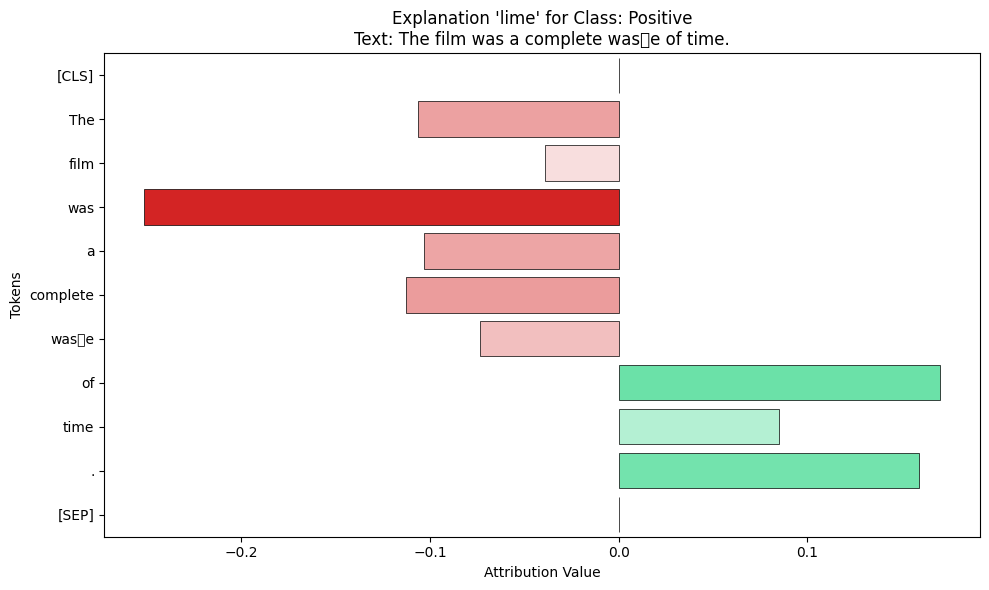

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


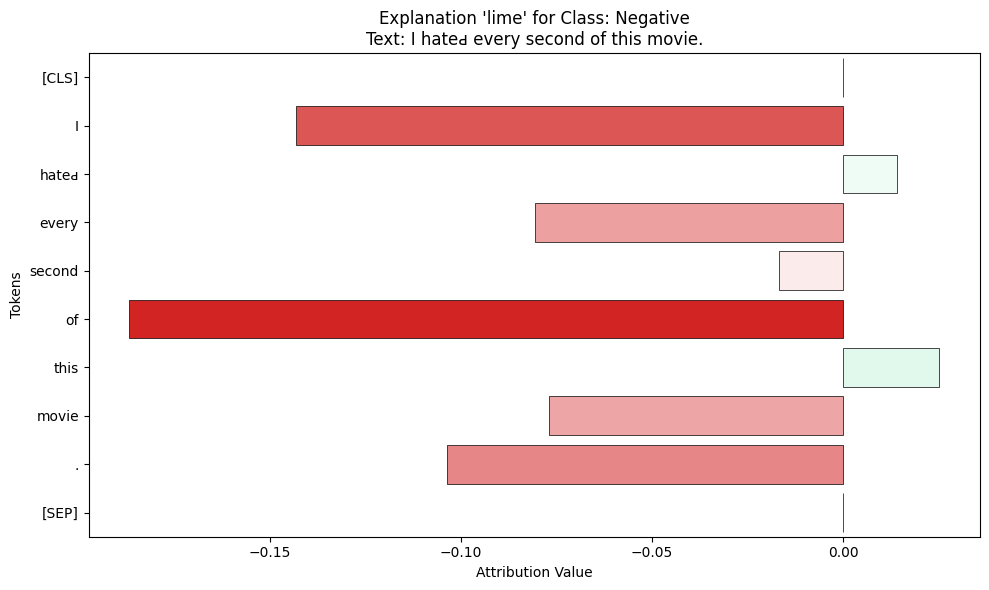

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


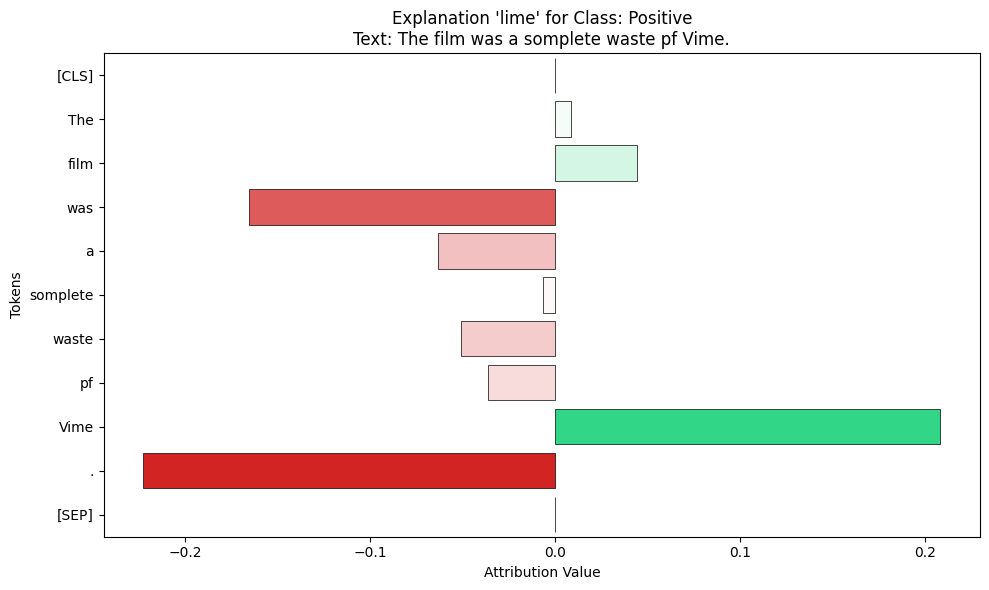

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


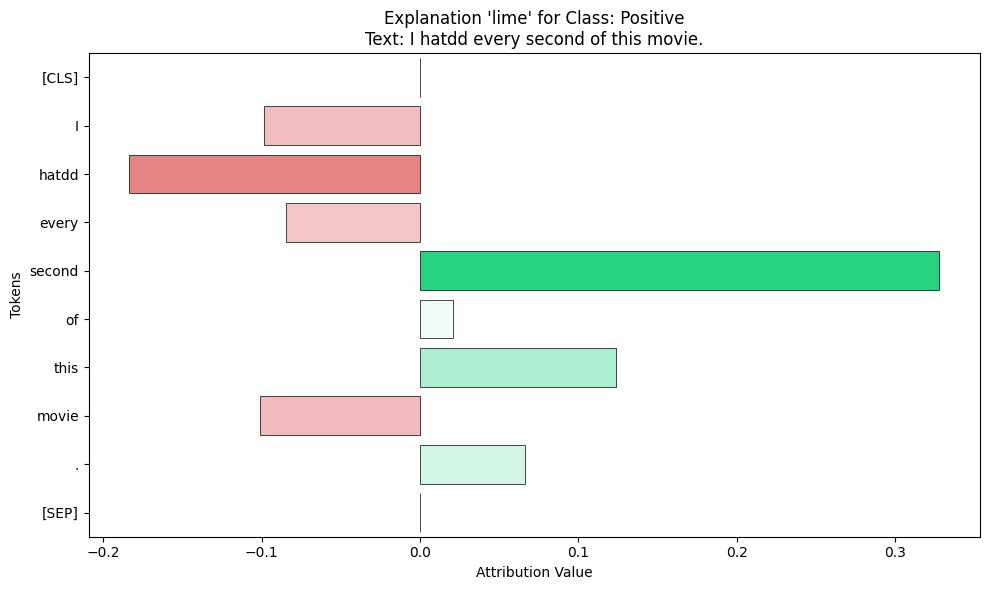

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


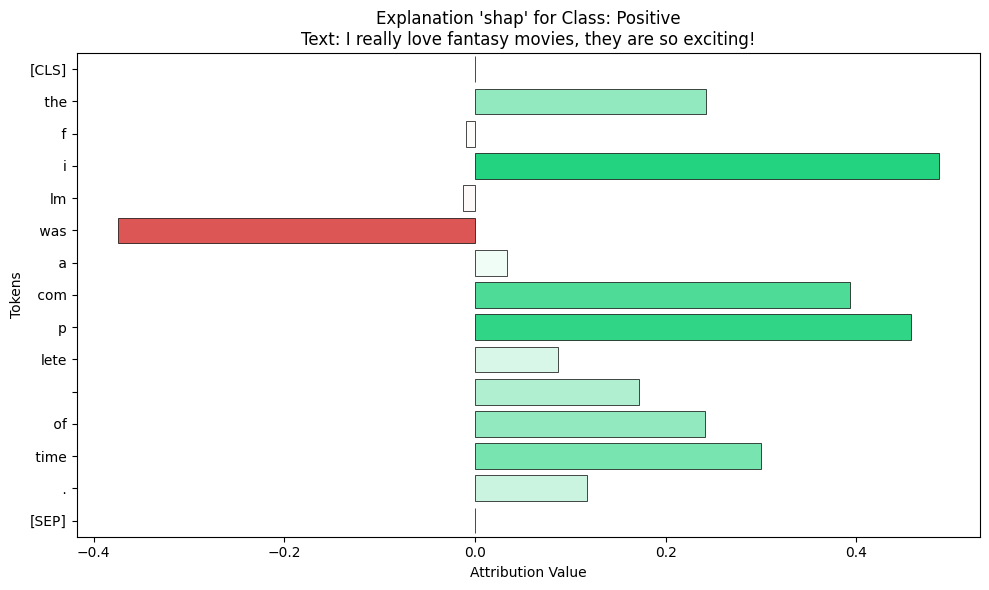

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (10) than needed (9), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


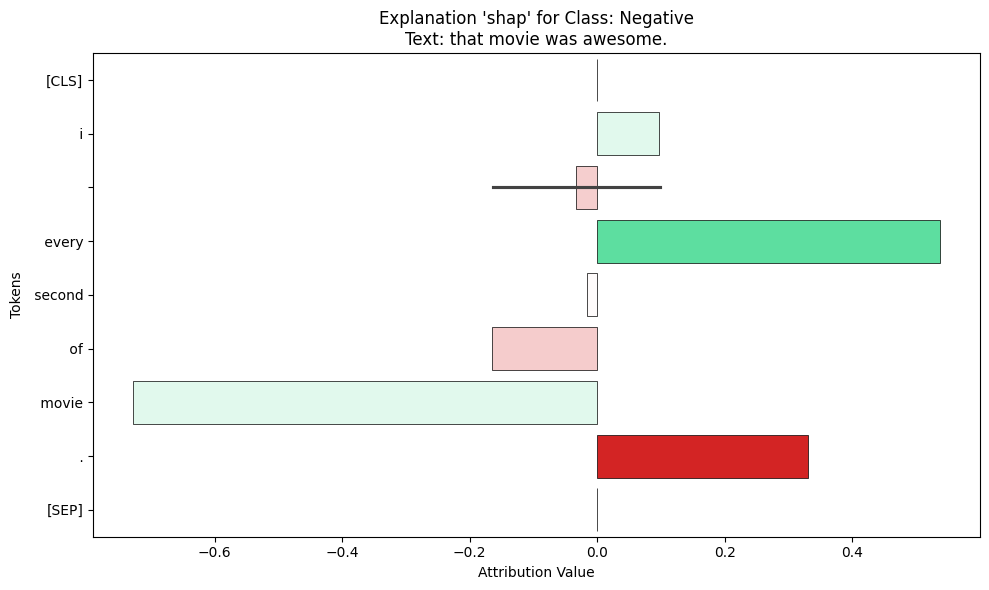

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


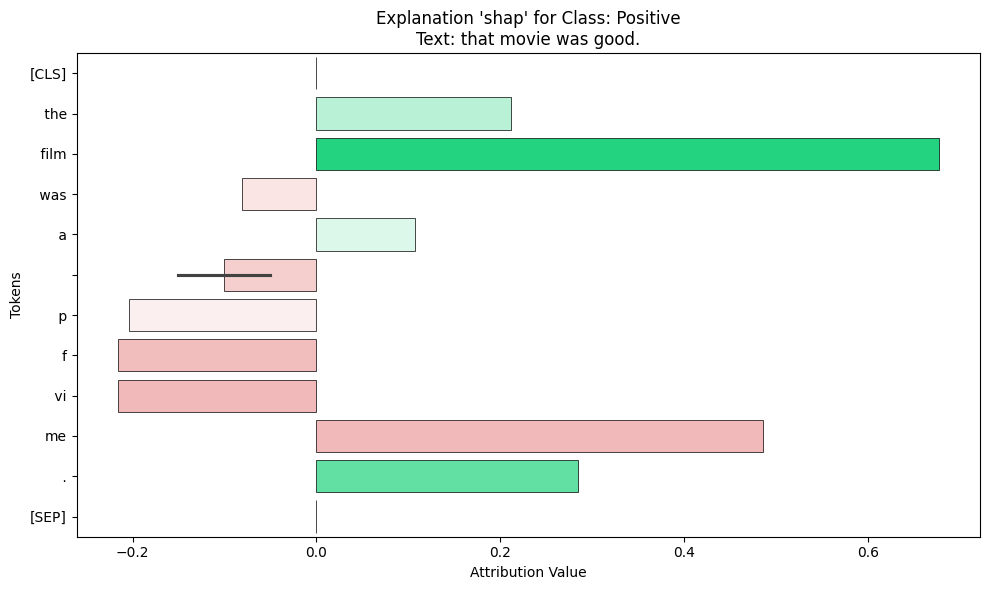

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (11) than needed (10), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


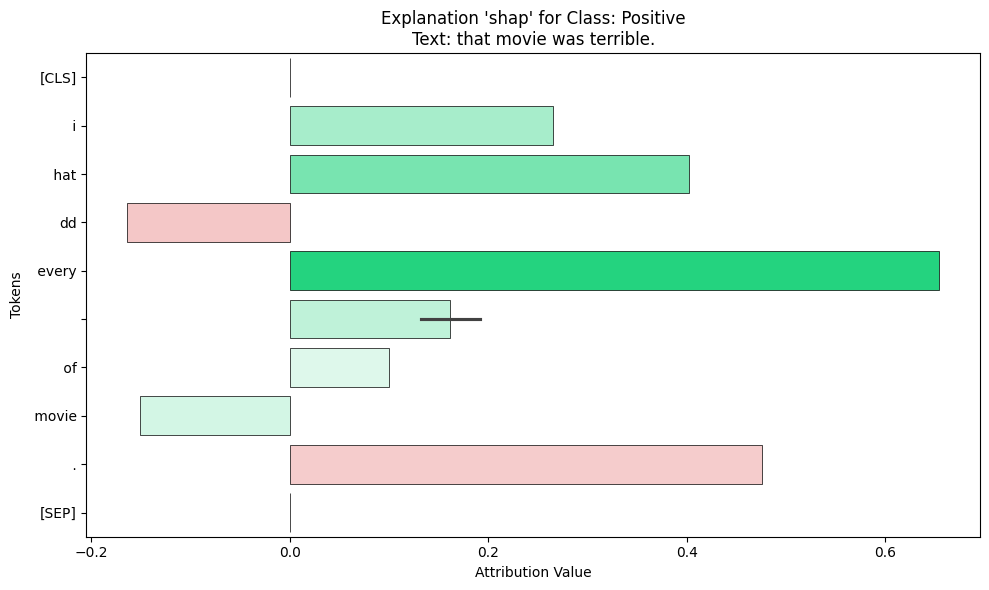

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:38: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


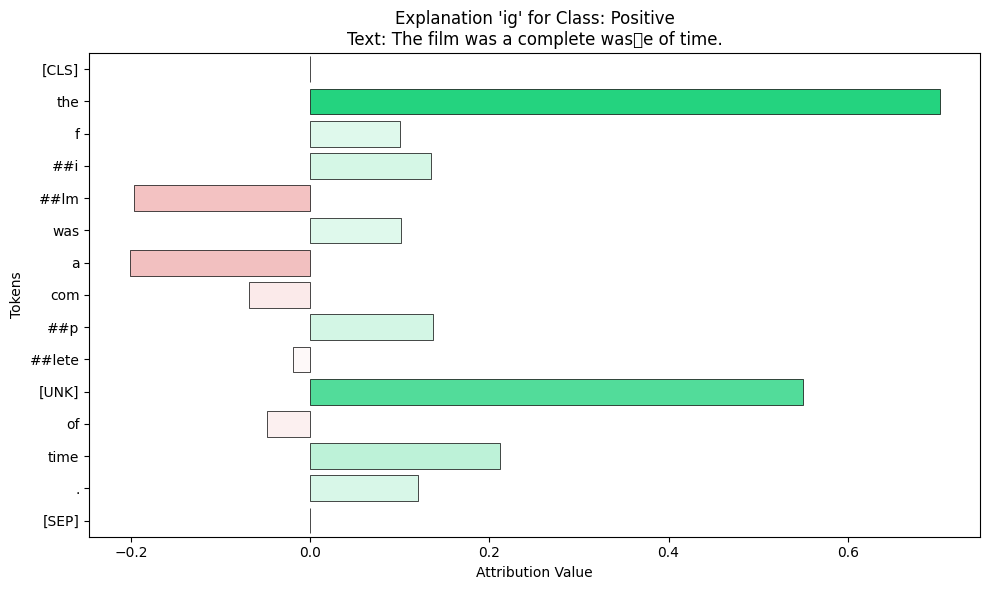

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (10) than needed (9), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


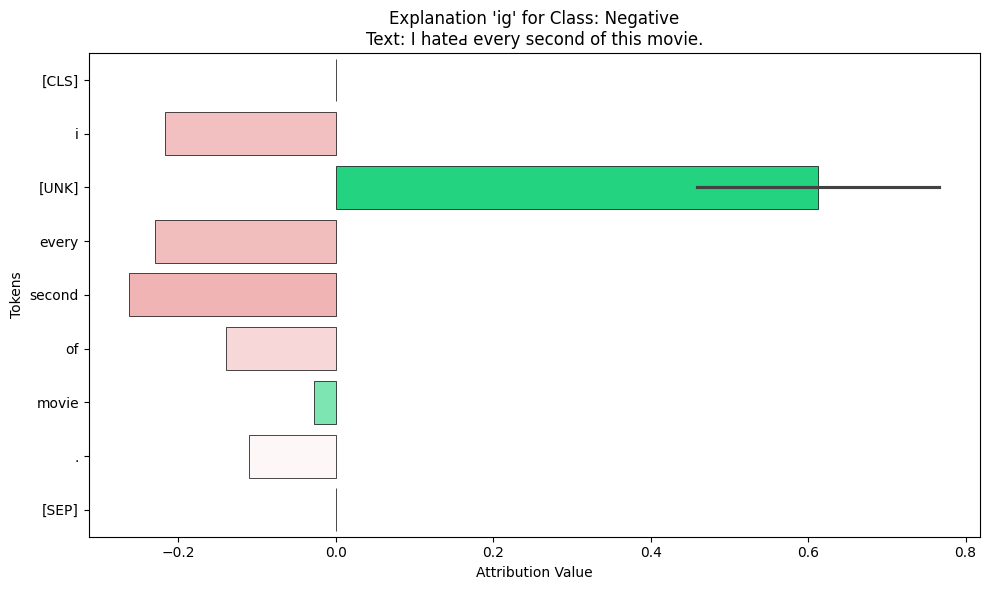

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


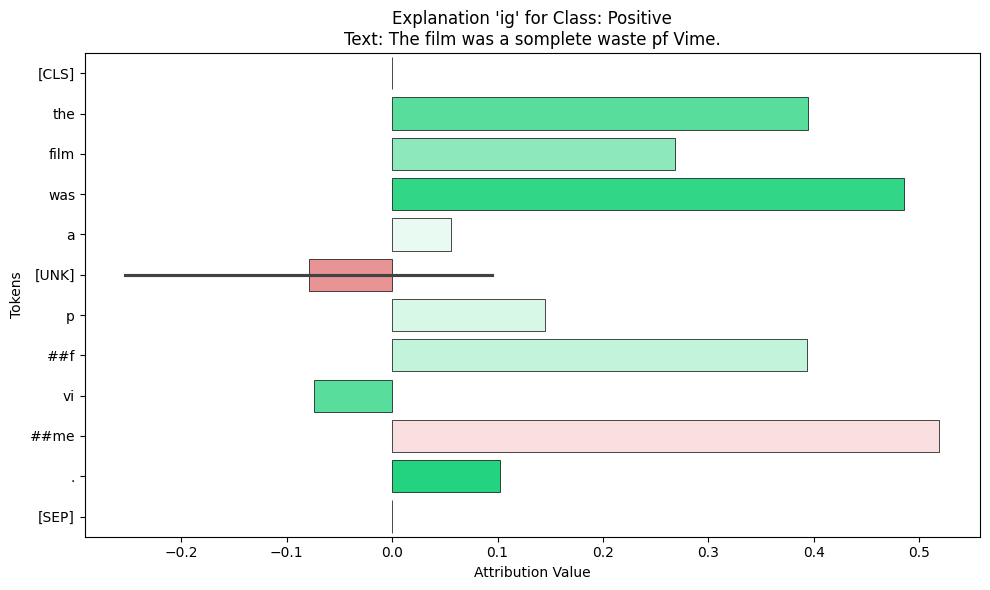

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (11) than needed (10), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


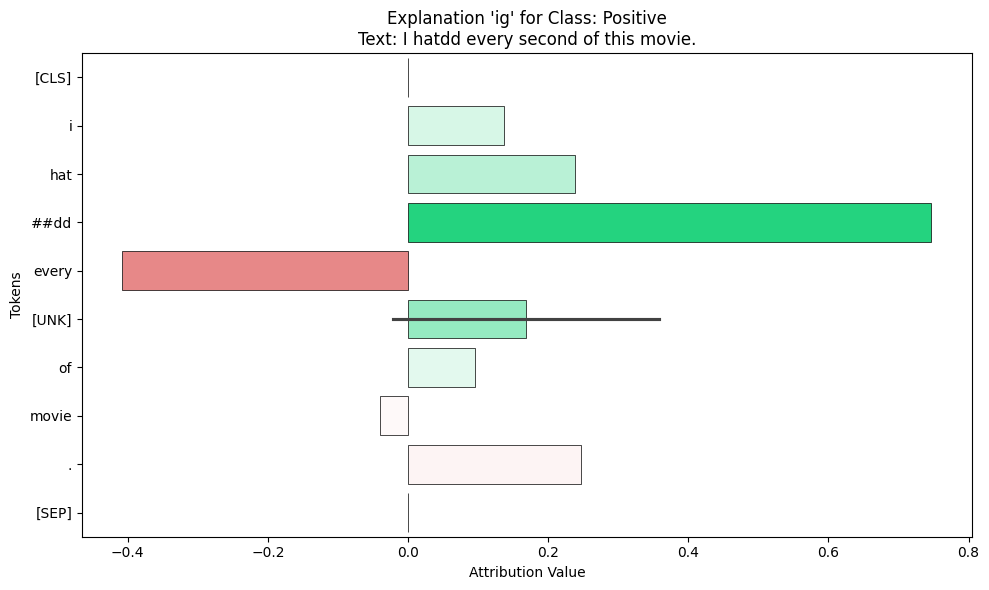

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:38: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


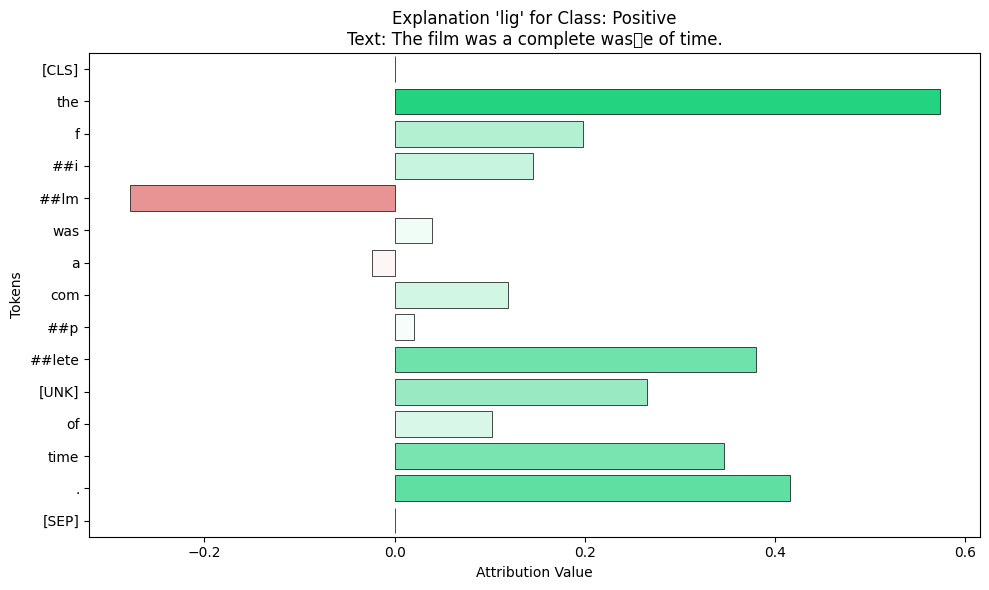

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (10) than needed (9), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


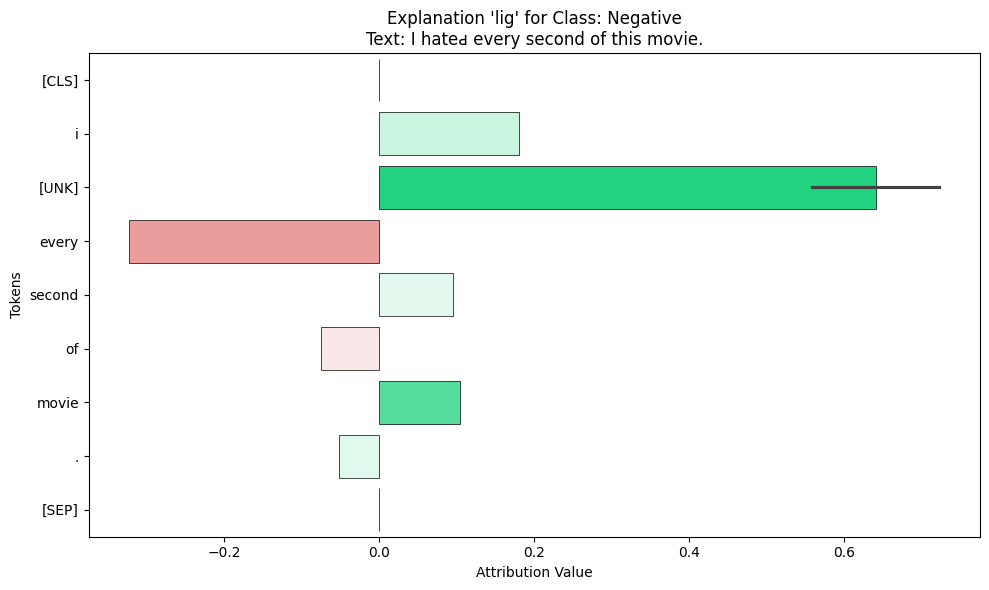

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


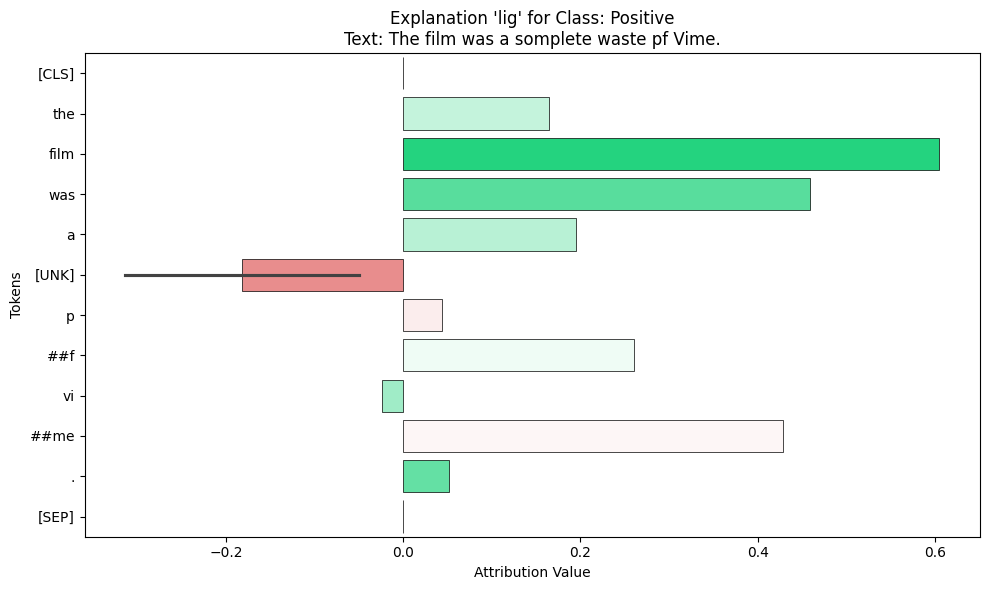

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (11) than needed (10), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


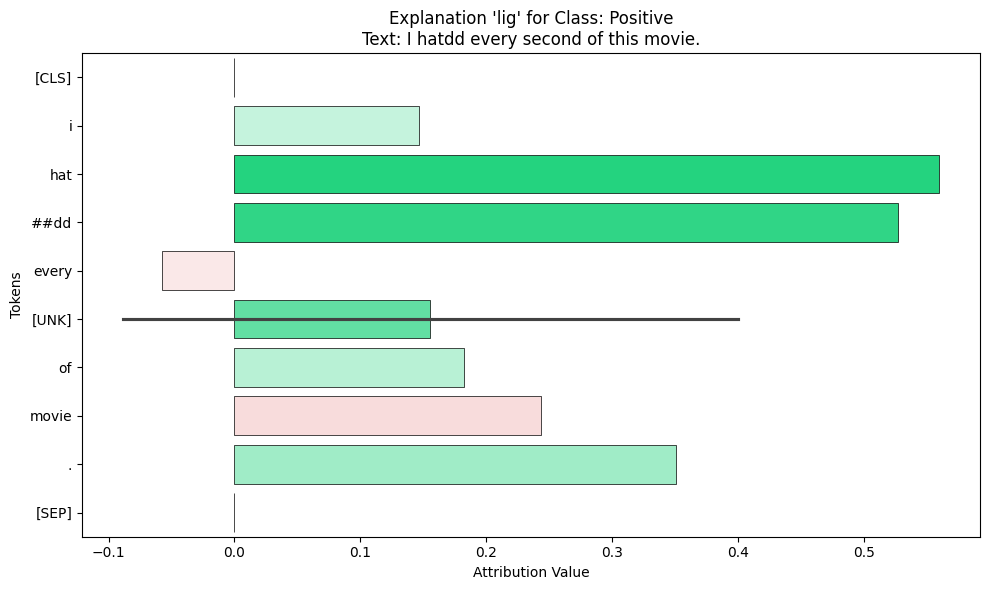

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:38: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 120477 (\N{MATHEMATICAL MONOSPACE SMALL T}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


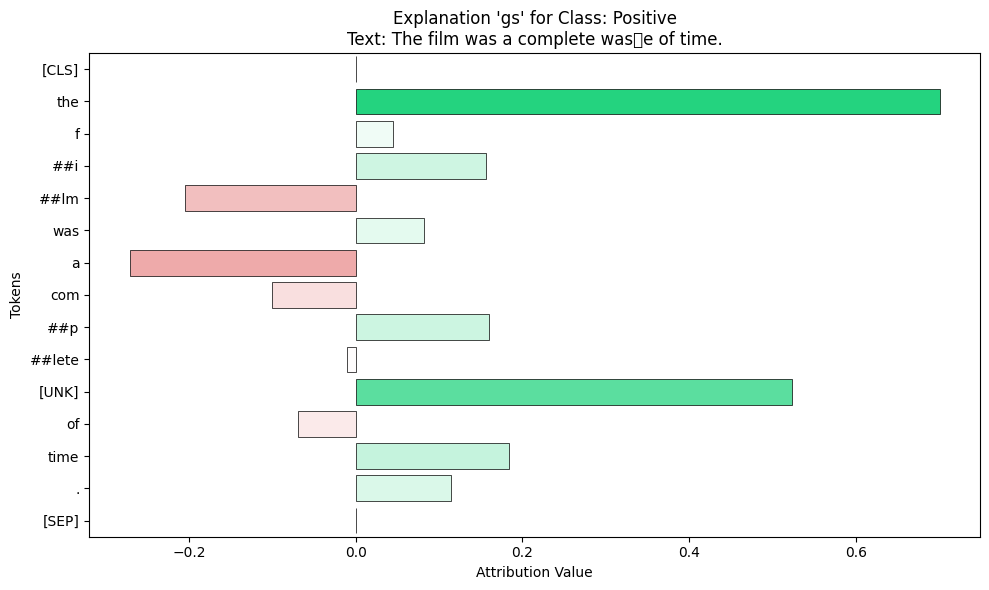

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (10) than needed (9), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


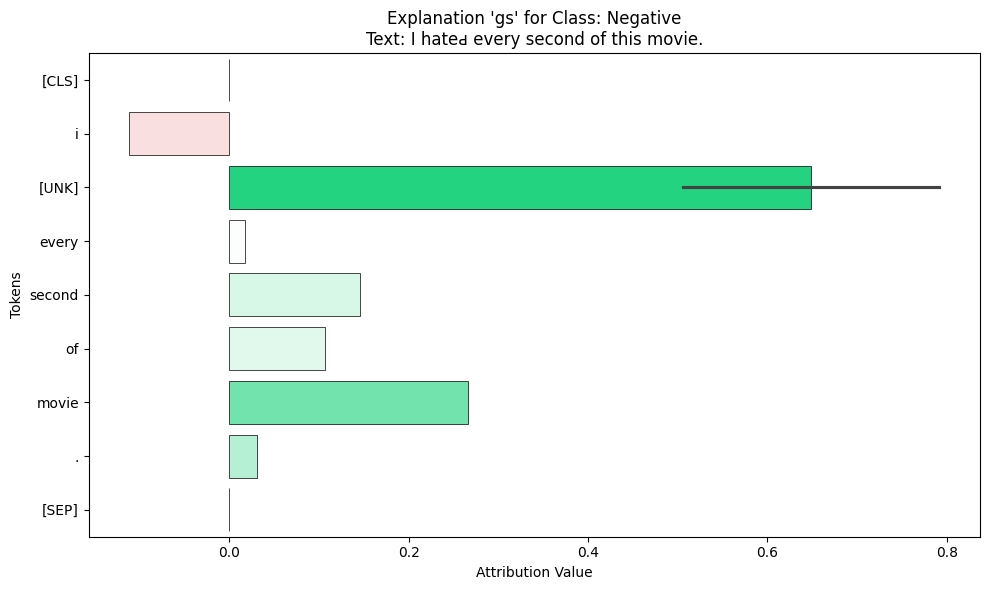

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (13) than needed (12), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


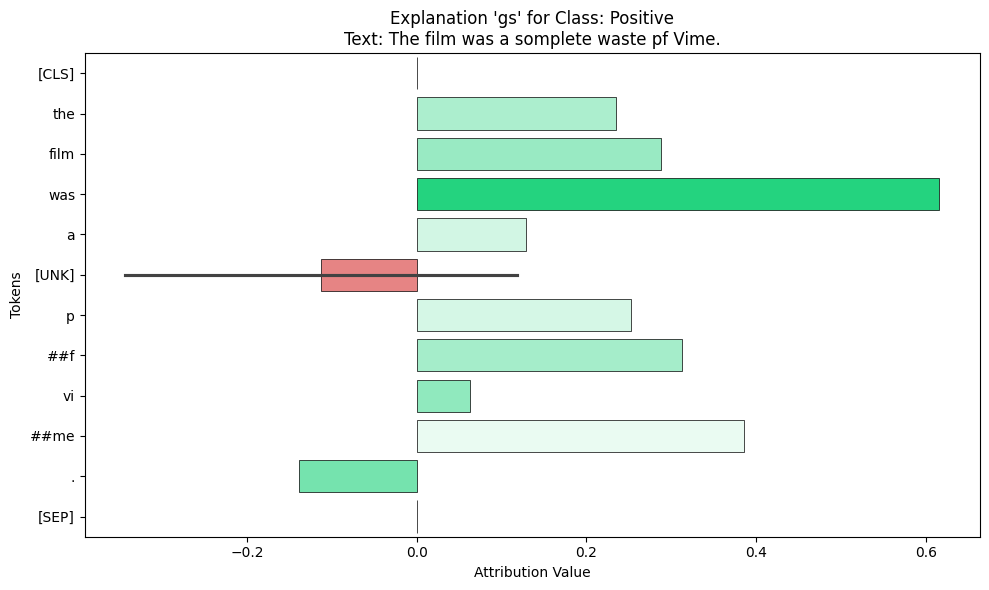

<ipython-input-16-1129b9db070e>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)
<ipython-input-16-1129b9db070e>:34: UserWarning: The palette list has more values (11) than needed (10), which may not be intended.
  sns.barplot(x=attributions, y=tokens, palette=colors, edgecolor="black", linewidth=0.5)


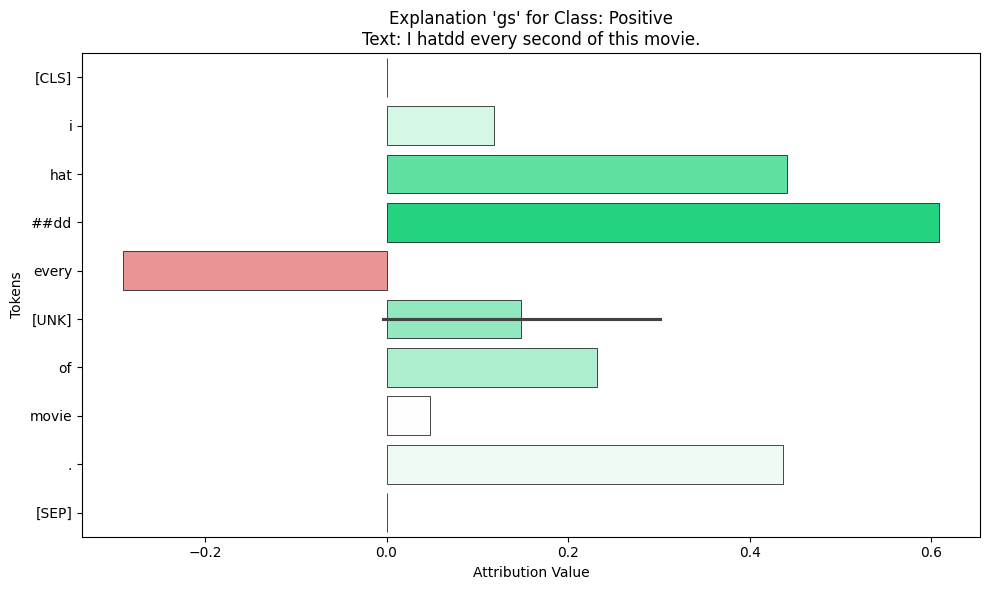

In [ ]:
plot_exp_per_classes(ad_bb_attributions)
plot_exp_per_classes(ad_wb_attributions)

### **Insertion attacks & Deletion attacks (DA FARE)**

Insertion Attacks: Inserire parole o frasi che non alterano il significato ma che possono disturbare il modello, portandolo a una classificazione errata.
Deletion Attacks: Rimuovere parole che sono fondamentali per la corretta classificazione ma che non cambiano il significato apparente della frase.

In [ ]:
import torch
import torch.nn.functional as F
from transformers import BertTokenizer, BertForSequenceClassification

# Caricamento del tokenizer e del modello pre-addestrato BERT per la classificazione del sentiment
tokenizer = BertTokenizer.from_pretrained('nlptown/bert-base-multilingual-uncased-sentiment')
model = BertForSequenceClassification.from_pretrained('nlptown/bert-base-multilingual-uncased-sentiment')

# Inizializzazione del dispositivo
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Funzione per inserire parole sarcastiche positive e osservare come cambia la classificazione
def sarcasm_insertion_attack(texts):
    # Lista di parole sarcastiche positive e frasi per enfatizzare il sarcasmo
    sarcastic_words = ["amazing", "fantastic", "incredible", "unbelievable", "brilliant", "spectacular", "excellent"]
    sarcastic_phrases = [
        "What a disaster, absolutely brilliant!",
        "Great movie, if you love boredom.",
        "Absolutely loved it, couldn't have been worse.",
        "Such a masterpiece, if you enjoy pain.",
        "This movie was perfect, just as I imagined it would be... horrible."
    ]

    # Elaborazione dei testi
    for text in texts:
        # Tokenizzazione del testo originale
        inputs = tokenizer([text], padding=True, truncation=True, return_tensors="pt")
        inputs = {key: value.to(device) for key, value in inputs.items()}

        # Classificazione del testo originale
        with torch.no_grad():
            outputs = model(**inputs)
        logits = outputs.logits
        probabilities = F.softmax(logits, dim=-1)
        predicted_class = torch.argmax(probabilities, dim=-1).tolist()[0]

        # Stampa la previsione originale
        class_labels = ["Negative", "Slightly Negative", "Neutral", "Slightly Positive", "Positive"]
        print(f"Original Text: \"{text}\" -> Predicted Class: {class_labels[predicted_class]} (Probability: {probabilities[0][predicted_class].item():.4f})")

        # Inserimento di parole sarcastiche positive
        # 1. Inserimento di parole sarcastiche positive
        text_with_insertion = text + " " + " ".join(sarcastic_words[:3])  # Aggiungiamo tre parole sarcastiche
        # 2. Inserimento di una frase sarcastica completa
        text_with_insertion_2 = text + " " + sarcastic_phrases[0]  # Aggiungiamo una frase sarcastica

        # Tokenizzazione dei testi perturbati
        inputs = tokenizer([text_with_insertion], padding=True, truncation=True, return_tensors="pt")
        inputs = {key: value.to(device) for key, value in inputs.items()}

        # Classificazione del testo con il primo tipo di perturbazione
        with torch.no_grad():
            outputs = model(**inputs)
        logits = outputs.logits
        probabilities = F.softmax(logits, dim=-1)
        predicted_class = torch.argmax(probabilities, dim=-1).tolist()[0]

        # Stampa la previsione dopo il primo tipo di perturbazione
        print(f"Text with Insertion (sarcastic words): \"{text_with_insertion}\" -> Predicted Class: {class_labels[predicted_class]} (Probability: {probabilities[0][predicted_class].item():.4f})")

        # Tokenizzazione del secondo tipo di testo perturbato (con frase sarcastica completa)
        inputs = tokenizer([text_with_insertion_2], padding=True, truncation=True, return_tensors="pt")
        inputs = {key: value.to(device) for key, value in inputs.items()}

        # Classificazione del testo con il secondo tipo di perturbazione
        with torch.no_grad():
            outputs = model(**inputs)
        logits = outputs.logits
        probabilities = F.softmax(logits, dim=-1)
        predicted_class = torch.argmax(probabilities, dim=-1).tolist()[0]

        # Stampa la previsione dopo il secondo tipo di perturbazione
        print(f"Text with Insertion (sarcastic phrase): \"{text_with_insertion_2}\" -> Predicted Class: {class_labels[predicted_class]} (Probability: {probabilities[0][predicted_class].item():.4f})")
        print("-" * 50)

# Esempi di recensioni sarcastiche da analizzare
texts = [
    "I really dislike that people don't like this movie.",
    "The film was a complete waste of time.",
    "This movie was a disaster, absolutely brilliant!",
    "What a borefest this movie was. So long and dragged on."
]

# Esegui l'attacco sarcastico
sarcasm_insertion_attack(texts)


tokenizer_config.json:   0%|          | 0.00/39.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/872k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/huggingface_hub/file_download.py:896: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/669M [00:00<?, ?B/s]

Original Text: "I really dislike that people don't like this movie." -> Predicted Class: Negative (Probability: 0.4817)
Text with Insertion (sarcastic words): "I really dislike that people don't like this movie. amazing fantastic incredible" -> Predicted Class: Positive (Probability: 0.8355)
Text with Insertion (sarcastic phrase): "I really dislike that people don't like this movie. What a disaster, absolutely brilliant!" -> Predicted Class: Negative (Probability: 0.9223)
--------------------------------------------------
Original Text: "The film was a complete waste of time." -> Predicted Class: Negative (Probability: 0.8223)
Text with Insertion (sarcastic words): "The film was a complete waste of time. amazing fantastic incredible" -> Predicted Class: Negative (Probability: 0.8984)
Text with Insertion (sarcastic phrase): "The film was a complete waste of time. What a disaster, absolutely brilliant!" -> Predicted Class: Negative (Probability: 0.9666)
----------------------------------